# Assignment 2

***

## Question 1: Neural Codes & Nearest Neighbor retrieval (7.5pt)
The Caltech101 dataset consists of images of 101 different objects. In this question you will develop an image retrieval system using image representations (neural codes) learned with a deep convolutional neural network and a given distance metric.

In the tasks below you will need to implement the following steps:

* Retrieval for $n$ selected (distinct) query images from the dataset
    * For each query image, obtain the 5 most similar images (excluding the query image itself!)
* Evaluation of the quality of the retrieval 
    * The Caltech101 images are annotated with their object class. Use these annotations to evaluate the accuracy of the retrieval task.
    * For each query image, count the number of images whose class corresponds to the one from the query. The score of the retrieval for that image then ranges between:
        * **5** *all* retrieved images' classes agree with the query image class
        * **0** *none* of the images' classes agree with the query image class
    * Compute the average of all $n$ queries

***

### Task 1.1:  Neural codes image retrieval
**a)** Implement the retrieval task and evaluate the results for $n=200$ images. Use the provided VGG16 network pre-trained on ImageNet to compute "neural codes" and L2-distance. Specifically use the codes produces by the following layers of the model: 
1. the "fc1"-layer
2. the "fc2"-layer

Provide the retrieval evaluation scores for both tasks.

In [2]:
# you'll need these imports:
from sklearn.neighbors import NearestNeighbors
import os
import numpy as np
import pickle

In [3]:
from keras.preprocessing import image
import matplotlib.pyplot as plt

def show_img(filepath):
    img = image.load_img(filepath, target_size=(224,224))
    plt.imshow(img)
    plt.axis("off")
    plt.show()

C:\Users\s115481\AppData\Local\Continuum\Anaconda3\envs\recomsys\lib\site-packages\h5py\__init__.py:34: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


##########################################################################################
################################# caltech101_VGG16_fc1.p #################################
Query results
============= original: =============
(Class: ketch)


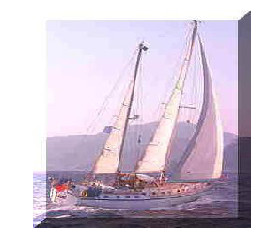

at distance 172.27209534951018:
(Class: schooner)
at distance 174.03866468449874:
(Class: ketch)
at distance 177.87288715397807:
(Class: ketch)
at distance 181.3878804256091:
(Class: ketch)
at distance 184.92081157037782:
(Class: schooner)
2181 3.0
============= original: =============
(Class: airplanes)


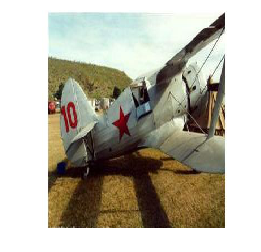

at distance 193.95465056270646:
(Class: airplanes)
at distance 194.54786321901466:
(Class: airplanes)
at distance 197.23772338517594:
(Class: airplanes)
at distance 199.63360702196374:
(Class: pyramid)
at distance 202.72891685464563:
(Class: pyramid)
1199 3.0
============= original: =============
(Class: rooster)


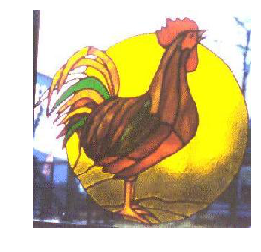

at distance 231.4731168068869:
(Class: rooster)
at distance 239.7463708508025:
(Class: helicopter)
at distance 240.71652116820482:
(Class: pyramid)
at distance 240.8432738791585:
(Class: buddha)
at distance 242.06357562689317:
(Class: cougar_face)
5655 1.0
============= original: =============
(Class: Faces)


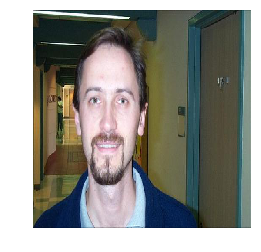

at distance 125.84656498799289:
(Class: Faces)
at distance 126.79241951231232:
(Class: Faces)
at distance 126.90625630711128:
(Class: Faces)
at distance 130.29916326091504:
(Class: Faces)
at distance 130.63884292245737:
(Class: Faces)
4060 5.0
============= original: =============
(Class: minaret)


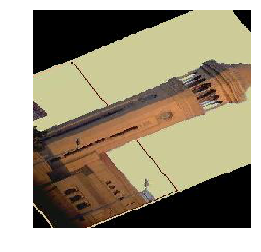

at distance 206.05487183778263:
(Class: minaret)
at distance 206.21542738106015:
(Class: minaret)
at distance 210.56525031531314:
(Class: minaret)
at distance 212.07522394082596:
(Class: minaret)
at distance 214.75920350915575:
(Class: minaret)
7014 5.0
============= original: =============
(Class: watch)


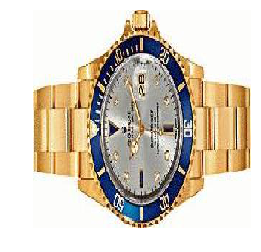

at distance 307.0321726536019:
(Class: watch)
at distance 335.78031265475636:
(Class: watch)
at distance 337.77040940204813:
(Class: watch)
at distance 338.98317795025457:
(Class: watch)
at distance 342.1820197341736:
(Class: watch)
1178 5.0
============= original: =============
(Class: pigeon)


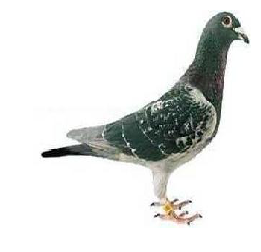

at distance 230.0220868844065:
(Class: pigeon)
at distance 247.2780714459882:
(Class: pigeon)
at distance 250.32107186608923:
(Class: pigeon)
at distance 251.89308371745594:
(Class: pigeon)
at distance 256.38283354074645:
(Class: brontosaurus)
8565 4.0
============= original: =============
(Class: butterfly)


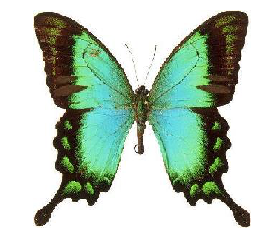

at distance 339.6299795866351:
(Class: butterfly)
at distance 342.230839295136:
(Class: butterfly)
at distance 343.38678914560506:
(Class: butterfly)
at distance 344.7920276250433:
(Class: butterfly)
at distance 351.06273137070815:
(Class: butterfly)
8437 5.0
============= original: =============
(Class: airplanes)


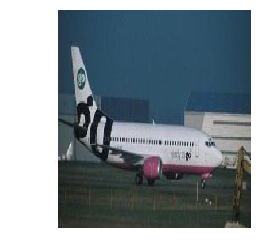

at distance 133.5146341199171:
(Class: airplanes)
at distance 142.3495422940671:
(Class: airplanes)
at distance 152.4176546772547:
(Class: airplanes)
at distance 155.13973958110122:
(Class: airplanes)
at distance 155.204706289103:
(Class: airplanes)
1931 5.0
============= original: =============
(Class: lobster)


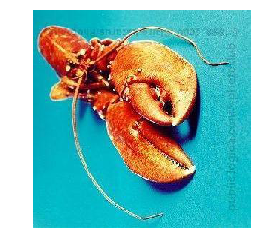

at distance 303.2319351529667:
(Class: stapler)
at distance 311.7555262312752:
(Class: octopus)
at distance 323.606190274075:
(Class: octopus)
at distance 323.8514263331416:
(Class: helicopter)
at distance 325.3248603879319:
(Class: octopus)
3849 0.0
============= original: =============
(Class: cougar_face)


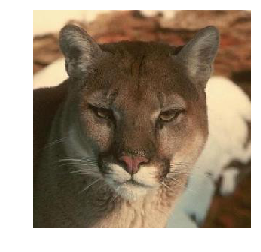

at distance 129.82638774898402:
(Class: cougar_face)
at distance 131.61229130099423:
(Class: cougar_face)
at distance 166.41853107704802:
(Class: cougar_face)
at distance 230.46387186818717:
(Class: cougar_face)
at distance 242.3918278422537:
(Class: cougar_face)
4575 5.0
============= original: =============
(Class: Faces)


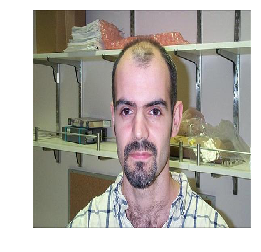

at distance 171.14217106263254:
(Class: Faces)
at distance 188.14957193684128:
(Class: Faces)
at distance 190.95409624089845:
(Class: Faces)
at distance 192.66775191784234:
(Class: Faces)
at distance 192.77303506716254:
(Class: Faces)
4251 5.0
============= original: =============
(Class: Leopards)


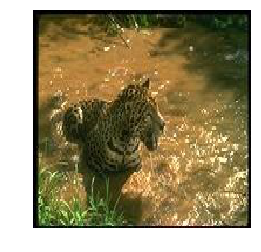

at distance 130.16761104812724:
(Class: Leopards)
at distance 199.4298193366974:
(Class: Leopards)
at distance 202.9087294764244:
(Class: Leopards)
at distance 203.4083978506394:
(Class: Leopards)
at distance 207.6169760523081:
(Class: Leopards)
5191 5.0
============= original: =============
(Class: stegosaurus)


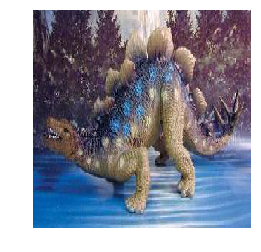

at distance 234.89147638292368:
(Class: stegosaurus)
at distance 237.85881756648305:
(Class: platypus)
at distance 242.1157570760224:
(Class: crocodile_head)
at distance 242.8478271869726:
(Class: sea_horse)
at distance 244.7504966237352:
(Class: crocodile)
6775 1.0
============= original: =============
(Class: electric_guitar)


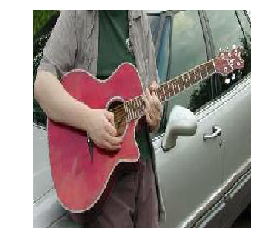

at distance 209.26288833722117:
(Class: pyramid)
at distance 211.4944082147471:
(Class: pyramid)
at distance 213.923980004516:
(Class: car_side)
at distance 214.31632625759792:
(Class: revolver)
at distance 214.8048704451229:
(Class: Faces)
3354 0.0
============= original: =============
(Class: helicopter)


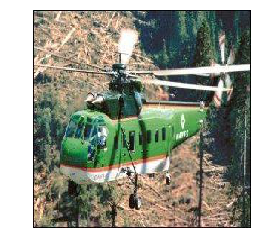

at distance 211.4627181952135:
(Class: helicopter)
at distance 212.28145920874863:
(Class: helicopter)
at distance 212.92168742909212:
(Class: airplanes)
at distance 215.95475404433543:
(Class: pyramid)
at distance 217.4858028401002:
(Class: airplanes)
7952 2.0
============= original: =============
(Class: headphone)


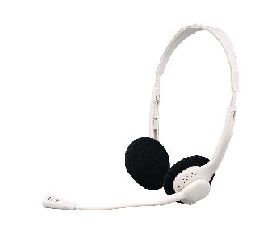

at distance 221.08072377608318:
(Class: headphone)
at distance 222.54857456129807:
(Class: headphone)
at distance 238.7946308859434:
(Class: headphone)
at distance 242.25810578567845:
(Class: headphone)
at distance 244.04384100968477:
(Class: headphone)
2204 5.0
============= original: =============
(Class: airplanes)


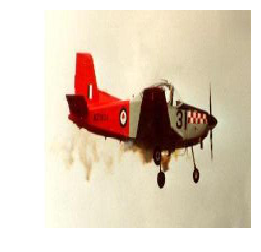

at distance 215.88630203958675:
(Class: airplanes)
at distance 215.90150512537306:
(Class: airplanes)
at distance 218.10253210403326:
(Class: airplanes)
at distance 219.27724125445425:
(Class: airplanes)
at distance 220.93485490127804:
(Class: airplanes)
1516 5.0
============= original: =============
(Class: lotus)


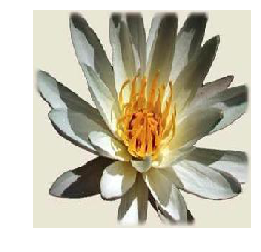

at distance 320.9880282633372:
(Class: lotus)
at distance 331.01270226548866:
(Class: lotus)
at distance 335.5280679160187:
(Class: lotus)
at distance 336.1130473119375:
(Class: lotus)
at distance 338.25139197315536:
(Class: water_lilly)
5401 4.0
============= original: =============
(Class: Faces_easy)


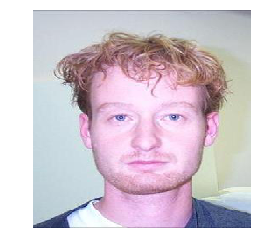

at distance 77.93321409150863:
(Class: Faces_easy)
at distance 110.35738701018683:
(Class: Faces_easy)
at distance 111.66307675884741:
(Class: Faces_easy)
at distance 121.14552712032311:
(Class: Faces)
at distance 121.16117611793199:
(Class: Faces_easy)
7486 4.0
============= original: =============
(Class: gramophone)


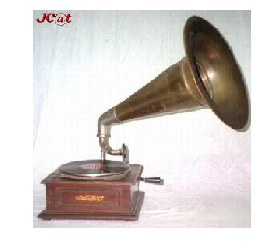

at distance 233.86485053777494:
(Class: gramophone)
at distance 242.63048515025753:
(Class: gramophone)
at distance 244.15513324780443:
(Class: gramophone)
at distance 245.38247656955573:
(Class: pyramid)
at distance 245.68446308430836:
(Class: gramophone)
8610 4.0
============= original: =============
(Class: nautilus)


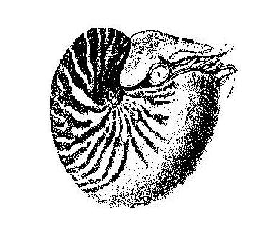

at distance 279.27336036403864:
(Class: nautilus)
at distance 290.6983136143693:
(Class: cougar_face)
at distance 291.94216452448103:
(Class: bass)
at distance 293.4081277857546:
(Class: nautilus)
at distance 300.61975539613326:
(Class: bass)
5629 2.0
============= original: =============
(Class: ewer)


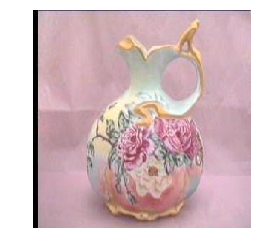

at distance 202.0403860433652:
(Class: helicopter)
at distance 202.31292532168487:
(Class: buddha)
at distance 204.46655463266967:
(Class: cup)
at distance 204.62211531211798:
(Class: pyramid)
at distance 205.44322107407018:
(Class: bonsai)
3149 0.0
============= original: =============
(Class: watch)


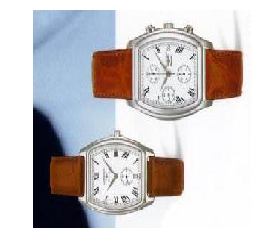

at distance 232.3700763261722:
(Class: watch)
at distance 232.91066174926272:
(Class: pyramid)
at distance 233.7625974328831:
(Class: car_side)
at distance 234.84290903317725:
(Class: ceiling_fan)
at distance 234.94185682194097:
(Class: revolver)
1134 1.0
============= original: =============
(Class: watch)


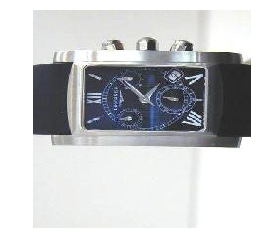

at distance 211.19221108410392:
(Class: helicopter)
at distance 215.35093136592604:
(Class: pyramid)
at distance 216.59083172734228:
(Class: revolver)
at distance 216.64808216314293:
(Class: cougar_face)
at distance 216.73677293561374:
(Class: car_side)
1059 0.0
============= original: =============
(Class: bonsai)


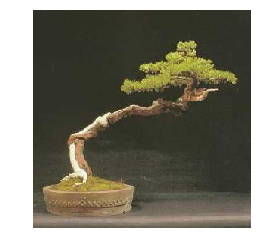

at distance 167.02301206719528:
(Class: bonsai)
at distance 169.6873721094582:
(Class: bonsai)
at distance 174.10172726833838:
(Class: bonsai)
at distance 175.06166009322678:
(Class: flamingo)
at distance 175.1766910477566:
(Class: bonsai)
3959 4.0
============= original: =============
(Class: accordion)


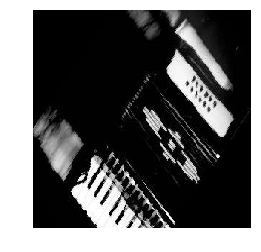

at distance 235.43525584404603:
(Class: accordion)
at distance 242.14792201389747:
(Class: accordion)
at distance 249.26913133387424:
(Class: accordion)
at distance 251.0816308745798:
(Class: accordion)
at distance 255.60754900981235:
(Class: accordion)
4607 5.0
============= original: =============
(Class: bass)


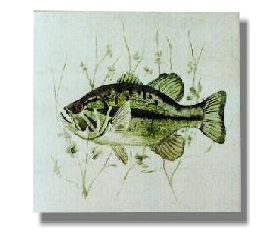

at distance 196.23719765110354:
(Class: bonsai)
at distance 196.76962436211713:
(Class: stegosaurus)
at distance 202.7304697883787:
(Class: cougar_face)
at distance 203.44219568939485:
(Class: Leopards)
at distance 203.73203843742112:
(Class: octopus)
7602 0.0
============= original: =============
(Class: Faces_easy)


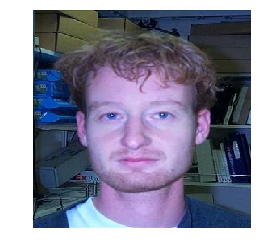

at distance 149.87298810172177:
(Class: Faces_easy)
at distance 151.05465416210313:
(Class: Faces_easy)
at distance 151.44500458431972:
(Class: Faces_easy)
at distance 152.11287738147627:
(Class: Faces_easy)
at distance 155.71605027965578:
(Class: Faces_easy)
7358 5.0
============= original: =============
(Class: stop_sign)


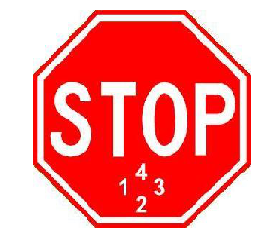

at distance 81.46207263114239:
(Class: stop_sign)
at distance 91.52845470204561:
(Class: stop_sign)
at distance 92.15871499540123:
(Class: stop_sign)
at distance 96.85741836511697:
(Class: stop_sign)
at distance 113.61117200526773:
(Class: stop_sign)
3624 5.0
============= original: =============
(Class: airplanes)


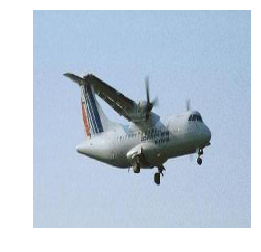

at distance 194.09073401958415:
(Class: airplanes)
at distance 194.96383895450796:
(Class: airplanes)
at distance 195.73579275999955:
(Class: airplanes)
at distance 195.78268302543574:
(Class: airplanes)
at distance 197.31240367854383:
(Class: airplanes)
1752 5.0
============= original: =============
(Class: minaret)


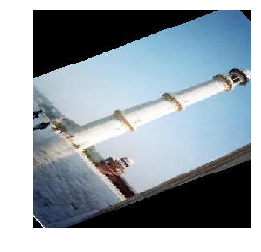

at distance 168.24585886335848:
(Class: minaret)
at distance 168.61705394733124:
(Class: minaret)
at distance 178.64120445308214:
(Class: minaret)
at distance 184.39960100267666:
(Class: minaret)
at distance 187.72323863428767:
(Class: minaret)
7013 5.0
============= original: =============
(Class: Faces)


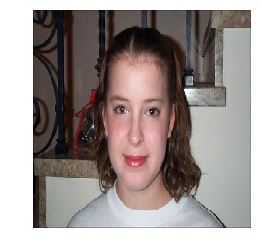

at distance 122.81172358033751:
(Class: Faces)
at distance 130.98998157851668:
(Class: Faces)
at distance 131.02299624021578:
(Class: Faces_easy)
at distance 131.05845339687804:
(Class: Faces)
at distance 131.80322695844742:
(Class: Faces)
4417 4.0
============= original: =============
(Class: sunflower)


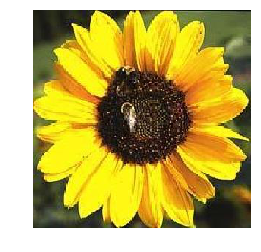

at distance 372.96510697459576:
(Class: sunflower)
at distance 380.49667608520366:
(Class: sunflower)
at distance 386.2483152009229:
(Class: sunflower)
at distance 387.0643047295867:
(Class: sunflower)
at distance 387.1876964453171:
(Class: sunflower)
4942 5.0
============= original: =============
(Class: lobster)


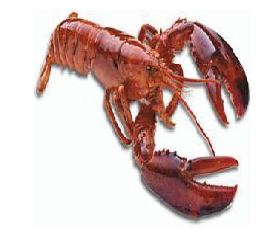

at distance 367.509893840153:
(Class: crab)
at distance 375.6223201514576:
(Class: crayfish)
at distance 377.46539813031785:
(Class: lobster)
at distance 389.30654989674554:
(Class: lobster)
at distance 392.6939953987201:
(Class: lobster)
3858 3.0
============= original: =============
(Class: airplanes)


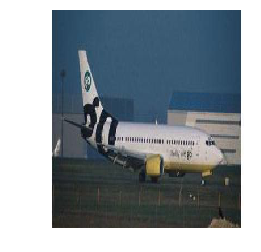

at distance 151.6061047709676:
(Class: airplanes)
at distance 152.4176546772547:
(Class: airplanes)
at distance 155.85711117374032:
(Class: airplanes)
at distance 160.06750904323184:
(Class: airplanes)
at distance 167.18862521008475:
(Class: airplanes)
1266 5.0
============= original: =============
(Class: hawksbill)


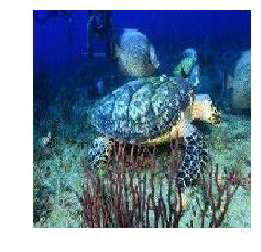

at distance 213.89101775190576:
(Class: hawksbill)
at distance 235.00682530053132:
(Class: hawksbill)
at distance 236.88321268133168:
(Class: sea_horse)
at distance 236.9084236966244:
(Class: hawksbill)
at distance 240.6026375583308:
(Class: hawksbill)
7586 4.0
============= original: =============
(Class: beaver)


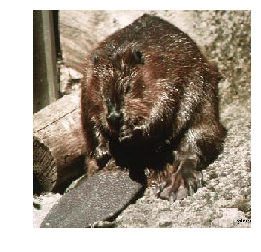

at distance 244.69848616733464:
(Class: beaver)
at distance 258.3052575092822:
(Class: beaver)
at distance 263.9632617609765:
(Class: beaver)
at distance 269.55545209395933:
(Class: beaver)
at distance 270.53783582026233:
(Class: beaver)
7719 5.0
============= original: =============
(Class: Faces_easy)


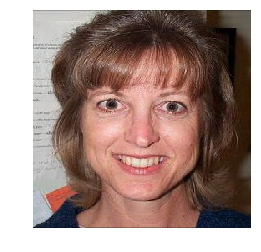

at distance 84.99014983647194:
(Class: Faces_easy)
at distance 85.50536261894484:
(Class: Faces_easy)
at distance 90.53281556342378:
(Class: Faces_easy)
at distance 95.76299570096951:
(Class: Faces_easy)
at distance 96.68101105585183:
(Class: Faces_easy)
7058 5.0
============= original: =============
(Class: Faces_easy)


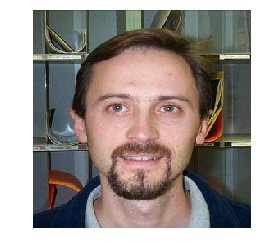

at distance 159.13664992601576:
(Class: Faces_easy)
at distance 164.02913498990446:
(Class: Faces_easy)
at distance 165.27676554378147:
(Class: Faces_easy)
at distance 172.0449266075354:
(Class: Faces_easy)
at distance 172.5472200067688:
(Class: Faces_easy)
7302 5.0
============= original: =============
(Class: panda)


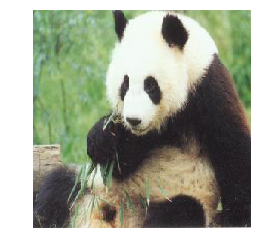

at distance 267.5918038878408:
(Class: panda)
at distance 273.4361823678174:
(Class: panda)
at distance 285.1553119014462:
(Class: panda)
at distance 289.8964900540744:
(Class: panda)
at distance 292.04260774896545:
(Class: panda)
3575 5.0
============= original: =============
(Class: schooner)


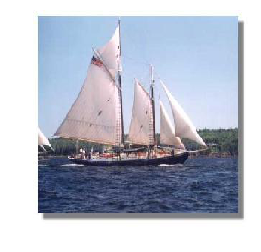

at distance 230.0800003659595:
(Class: schooner)
at distance 239.49742450884045:
(Class: ketch)
at distance 241.36016097352513:
(Class: schooner)
at distance 241.4257045179365:
(Class: ketch)
at distance 242.2717640086917:
(Class: ketch)
283 2.0
============= original: =============
(Class: Motorbikes)


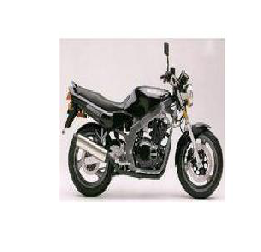

at distance 157.19728735698124:
(Class: Motorbikes)
at distance 163.60593617977628:
(Class: Motorbikes)
at distance 174.10569793782219:
(Class: Motorbikes)
at distance 188.00388619687303:
(Class: Motorbikes)
at distance 188.1472134794861:
(Class: Motorbikes)
2641 5.0
============= original: =============
(Class: grand_piano)


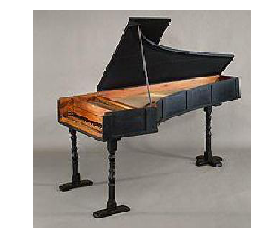

at distance 262.08981637642563:
(Class: grand_piano)
at distance 272.3228513266676:
(Class: grand_piano)
at distance 275.83391466540303:
(Class: grand_piano)
at distance 277.0997369111889:
(Class: grand_piano)
at distance 277.6651387910847:
(Class: grand_piano)
3741 5.0
============= original: =============
(Class: Motorbikes)


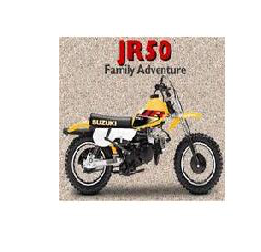

at distance 132.7652493931589:
(Class: Motorbikes)
at distance 153.6175514848602:
(Class: Motorbikes)
at distance 163.08542877733265:
(Class: Motorbikes)
at distance 169.23536749722211:
(Class: Motorbikes)
at distance 173.79616669547448:
(Class: Motorbikes)
2580 5.0
============= original: =============
(Class: flamingo)


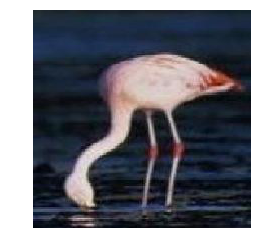

at distance 246.01591100908718:
(Class: flamingo)
at distance 259.4829527342532:
(Class: ibis)
at distance 266.22447567915276:
(Class: flamingo)
at distance 280.2321312541048:
(Class: flamingo)
at distance 285.75258592479975:
(Class: flamingo)
222 4.0
============= original: =============
(Class: stegosaurus)


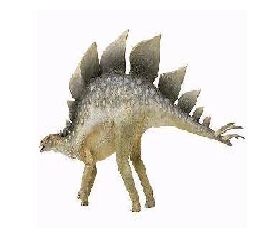

at distance 201.42624396659045:
(Class: stegosaurus)
at distance 213.1923658704841:
(Class: stegosaurus)
at distance 215.13275213814214:
(Class: chandelier)
at distance 215.58289434140875:
(Class: stegosaurus)
at distance 215.80554687032162:
(Class: bonsai)
6798 3.0
============= original: =============
(Class: Motorbikes)


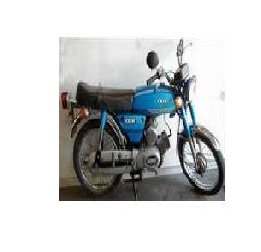

at distance 216.19655842279928:
(Class: Motorbikes)
at distance 224.73667381094262:
(Class: Motorbikes)
at distance 226.4443056938118:
(Class: Motorbikes)
at distance 226.55942136902596:
(Class: Motorbikes)
at distance 227.9631786274886:
(Class: Motorbikes)
2670 5.0
============= original: =============
(Class: airplanes)


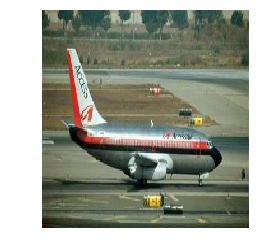

at distance 186.58686856300037:
(Class: airplanes)
at distance 186.76353680401758:
(Class: airplanes)
at distance 187.7271106027839:
(Class: airplanes)
at distance 188.72693643933502:
(Class: airplanes)
at distance 191.7043771776401:
(Class: airplanes)
1414 5.0
============= original: =============
(Class: cellphone)


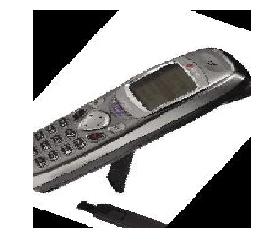

at distance 225.79531252550868:
(Class: cellphone)
at distance 230.06786554829907:
(Class: cellphone)
at distance 233.23700903480656:
(Class: cellphone)
at distance 236.3204178987167:
(Class: cellphone)
at distance 237.9036447682123:
(Class: cellphone)
8619 5.0
============= original: =============
(Class: Motorbikes)


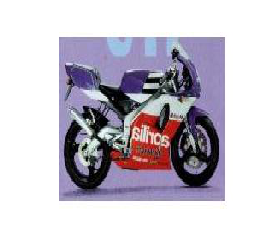

at distance 190.6497403494677:
(Class: Motorbikes)
at distance 197.21885816817525:
(Class: Motorbikes)
at distance 198.00014865793423:
(Class: Motorbikes)
at distance 198.06371657524457:
(Class: Motorbikes)
at distance 199.8857697582402:
(Class: Motorbikes)
2274 5.0
============= original: =============
(Class: bonsai)


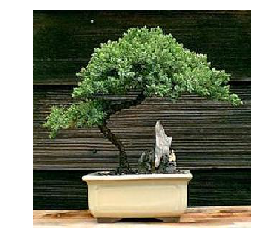

at distance 197.82145340101695:
(Class: bonsai)
at distance 201.28971660514495:
(Class: bonsai)
at distance 206.95233001440926:
(Class: bonsai)
at distance 207.03034937572895:
(Class: bonsai)
at distance 208.5641541185682:
(Class: bonsai)
3969 5.0
============= original: =============
(Class: Faces_easy)


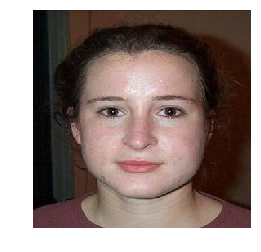

at distance 81.1400017544605:
(Class: Faces_easy)
at distance 85.10493902579589:
(Class: Faces_easy)
at distance 87.8278803173219:
(Class: Faces_easy)
at distance 89.05596385813753:
(Class: Faces_easy)
at distance 89.17391137407876:
(Class: Faces_easy)
7288 5.0
============= original: =============
(Class: lobster)


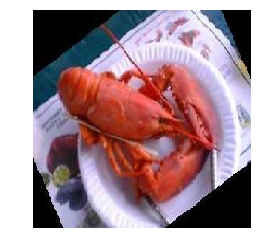

at distance 308.7074216046709:
(Class: lobster)
at distance 312.4699930599237:
(Class: lobster)
at distance 314.97842115392854:
(Class: scorpion)
at distance 316.0253177521265:
(Class: crayfish)
at distance 316.03164607813926:
(Class: lobster)
3856 3.0
============= original: =============
(Class: ketch)


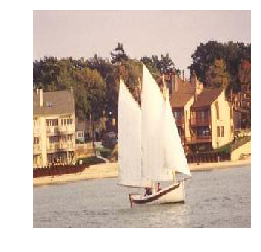

at distance 171.44988144443838:
(Class: pyramid)
at distance 179.06666831910425:
(Class: pyramid)
at distance 183.93133499550012:
(Class: pyramid)
at distance 184.88228130077653:
(Class: schooner)
at distance 186.8620074632955:
(Class: car_side)
2172 0.0
============= original: =============
(Class: revolver)


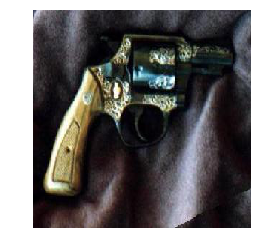

at distance 239.3501138999236:
(Class: revolver)
at distance 270.23657765570425:
(Class: revolver)
at distance 284.946286674647:
(Class: dollar_bill)
at distance 285.9485495942892:
(Class: revolver)
at distance 286.55310877536806:
(Class: revolver)
6952 4.0
============= original: =============
(Class: elephant)


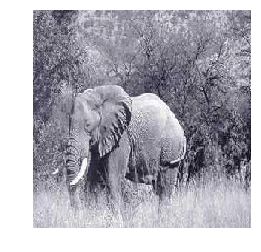

at distance 210.9464264849543:
(Class: rhino)
at distance 218.52290220221386:
(Class: joshua_tree)
at distance 227.9093335872925:
(Class: joshua_tree)
at distance 228.75437269136896:
(Class: joshua_tree)
at distance 231.61286422936368:
(Class: rhino)
63 0.0
============= original: =============
(Class: platypus)


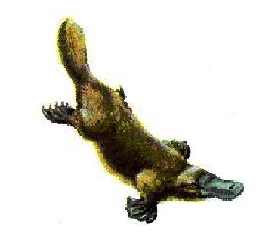

at distance 226.22671641586328:
(Class: platypus)
at distance 227.5984814234319:
(Class: bonsai)
at distance 234.13383880272818:
(Class: chandelier)
at distance 236.35077880899667:
(Class: bonsai)
at distance 237.4826204703523:
(Class: brontosaurus)
3656 1.0
============= original: =============
(Class: ant)


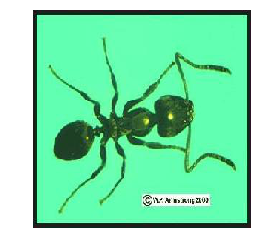

at distance 292.44060144854893:
(Class: ant)
at distance 305.87072549280975:
(Class: ant)
at distance 306.4456610129661:
(Class: ant)
at distance 306.73979539442234:
(Class: ant)
at distance 319.63794641703316:
(Class: tick)
2028 4.0
============= original: =============
(Class: metronome)


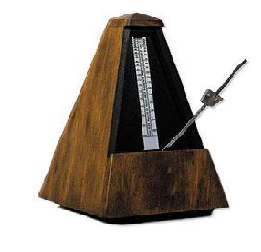

at distance 195.01572580903652:
(Class: metronome)
at distance 199.57339719125204:
(Class: metronome)
at distance 201.33445547187773:
(Class: metronome)
at distance 203.70265605366137:
(Class: metronome)
at distance 204.28839529804557:
(Class: metronome)
5361 5.0
============= original: =============
(Class: Faces)


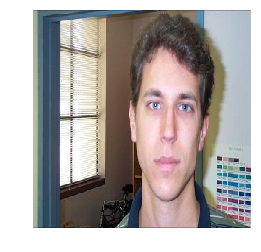

at distance 137.77891981107112:
(Class: Faces_easy)
at distance 153.14165610127085:
(Class: Faces)
at distance 153.5212348211586:
(Class: Faces)
at distance 156.64759421866358:
(Class: Faces)
at distance 158.10870322949057:
(Class: Faces)
4394 4.0
============= original: =============
(Class: hedgehog)


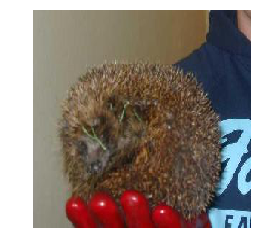

at distance 240.6429474024407:
(Class: hedgehog)
at distance 246.8670469996064:
(Class: strawberry)
at distance 249.51019384346415:
(Class: pyramid)
at distance 249.7816555642871:
(Class: platypus)
at distance 251.4153414317032:
(Class: Faces)
5746 1.0
============= original: =============
(Class: wrench)


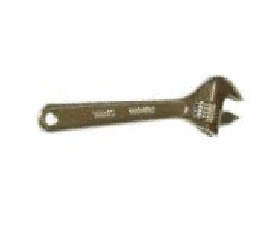

at distance 131.50780490453693:
(Class: wrench)
at distance 152.574482484644:
(Class: wrench)
at distance 159.98239847644993:
(Class: wrench)
at distance 175.1282737954045:
(Class: wrench)
at distance 181.54306734069112:
(Class: wrench)
4770 5.0
============= original: =============
(Class: ibis)


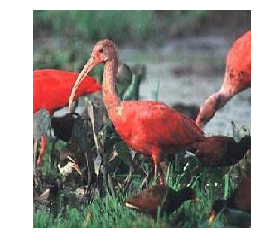

at distance 281.11403033495765:
(Class: ibis)
at distance 287.8531299841657:
(Class: ibis)
at distance 323.579283984745:
(Class: ibis)
at distance 331.70400629384034:
(Class: ibis)
at distance 337.9092769324723:
(Class: ibis)
4792 5.0
============= original: =============
(Class: airplanes)


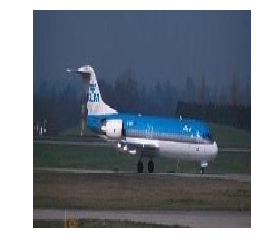

at distance 195.45706374166565:
(Class: airplanes)
at distance 197.2584107379782:
(Class: airplanes)
at distance 204.29836529201626:
(Class: airplanes)
at distance 205.31994066083328:
(Class: airplanes)
at distance 205.955968969309:
(Class: airplanes)
1714 5.0
============= original: =============
(Class: cannon)


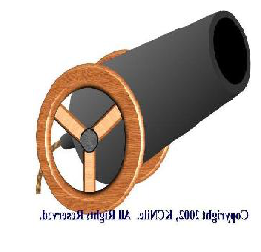

at distance 278.5098015723118:
(Class: wrench)
at distance 283.0765835204878:
(Class: wrench)
at distance 285.8821383881123:
(Class: scissors)
at distance 286.6377942595482:
(Class: watch)
at distance 286.7279516450016:
(Class: wrench)
8362 0.0
============= original: =============
(Class: buddha)


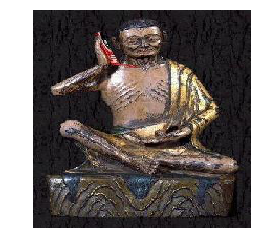

at distance 258.06679057364545:
(Class: buddha)
at distance 261.1952928381162:
(Class: bonsai)
at distance 261.66345199847353:
(Class: buddha)
at distance 264.18076542438644:
(Class: anchor)
at distance 264.23936035959974:
(Class: buddha)
8314 3.0
============= original: =============
(Class: ketch)


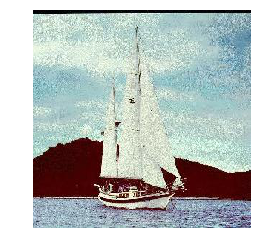

at distance 201.52738020942786:
(Class: ketch)
at distance 202.59009737694544:
(Class: schooner)
at distance 206.75250860303981:
(Class: pyramid)
at distance 206.9349220754905:
(Class: ketch)
at distance 207.84245140733637:
(Class: ketch)
2086 3.0
============= original: =============
(Class: laptop)


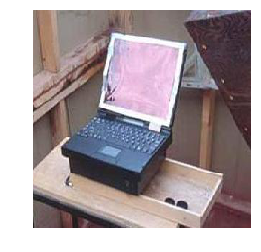

at distance 225.1291902615882:
(Class: laptop)
at distance 246.64663117794188:
(Class: laptop)
at distance 248.7491037937071:
(Class: laptop)
at distance 249.53349336036777:
(Class: laptop)
at distance 254.608264836793:
(Class: pyramid)
6230 4.0
============= original: =============
(Class: cup)


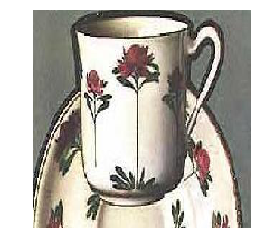

at distance 368.02919548242846:
(Class: ewer)
at distance 371.12983025242403:
(Class: cup)
at distance 372.64826367170855:
(Class: ewer)
at distance 374.21870418776314:
(Class: cup)
at distance 374.3645441972397:
(Class: ewer)
7699 2.0
============= original: =============
(Class: Faces_easy)


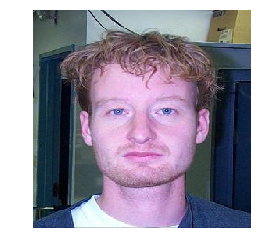

at distance 119.15761967692299:
(Class: Faces_easy)
at distance 135.5098338030419:
(Class: Faces_easy)
at distance 143.16825068625607:
(Class: Faces_easy)
at distance 145.39424666340753:
(Class: Faces_easy)
at distance 145.7888218404902:
(Class: Faces_easy)
7432 5.0
============= original: =============
(Class: chandelier)


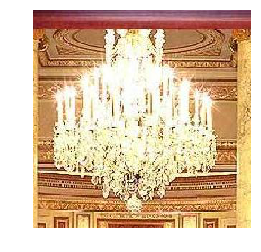

at distance 248.12419086250884:
(Class: buddha)
at distance 251.37323651704287:
(Class: bonsai)
at distance 257.5300297326:
(Class: pyramid)
at distance 257.815944636126:
(Class: Leopards)
at distance 258.0351320262082:
(Class: Faces)
654 0.0
============= original: =============
(Class: cup)


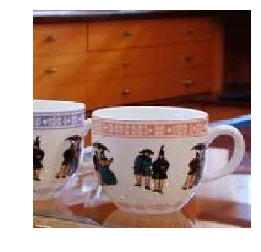

at distance 259.34002132156127:
(Class: cup)
at distance 259.49225134061845:
(Class: cup)
at distance 259.9016656865452:
(Class: pyramid)
at distance 260.3933987396619:
(Class: cup)
at distance 260.7399233883588:
(Class: cup)
7663 4.0
============= original: =============
(Class: ferry)


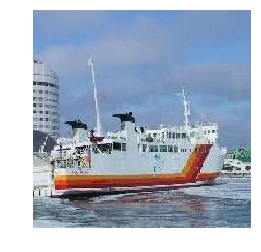

at distance 229.03142114476407:
(Class: ferry)
at distance 238.86603726787382:
(Class: ferry)
at distance 239.0206005967064:
(Class: ferry)
at distance 239.48392761461622:
(Class: ferry)
at distance 242.25026154439007:
(Class: ferry)
444 5.0
============= original: =============
(Class: menorah)


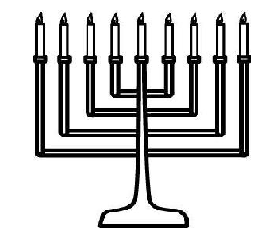

at distance 509.20024397724706:
(Class: menorah)
at distance 520.6172236251887:
(Class: menorah)
at distance 531.733575729807:
(Class: menorah)
at distance 535.8342993875058:
(Class: menorah)
at distance 539.0463883345553:
(Class: menorah)
6432 5.0
============= original: =============
(Class: brain)


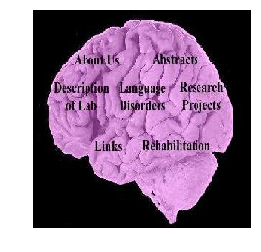

at distance 229.91071221130431:
(Class: brain)
at distance 243.32474257218604:
(Class: brain)
at distance 243.87675387919995:
(Class: brain)
at distance 249.68449857374873:
(Class: rhino)
at distance 252.78643274205103:
(Class: brain)
6116 4.0
============= original: =============
(Class: menorah)


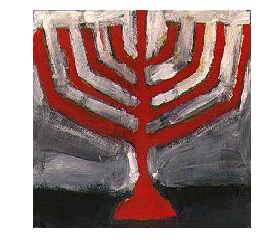

at distance 260.41090277213607:
(Class: electric_guitar)
at distance 267.42328274373057:
(Class: chair)
at distance 269.9974305361734:
(Class: pyramid)
at distance 270.05527709418453:
(Class: cougar_face)
at distance 270.65639034552714:
(Class: pyramid)
6390 0.0
============= original: =============
(Class: bonsai)


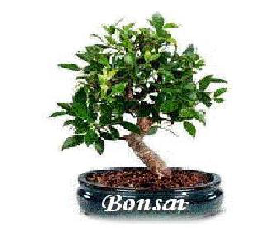

at distance 202.62881788117252:
(Class: bonsai)
at distance 205.7611016995635:
(Class: bonsai)
at distance 210.2798884150421:
(Class: bonsai)
at distance 211.37463503402498:
(Class: bonsai)
at distance 212.43084030737685:
(Class: bonsai)
3934 5.0
============= original: =============
(Class: hawksbill)


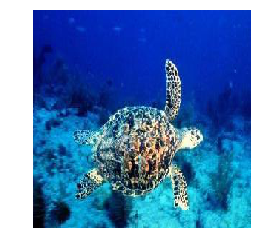

at distance 216.39572222998794:
(Class: hawksbill)
at distance 236.77862356319437:
(Class: hawksbill)
at distance 250.94754621321704:
(Class: hawksbill)
at distance 259.8086873905959:
(Class: hawksbill)
at distance 260.88477643752935:
(Class: hawksbill)
7548 5.0
============= original: =============
(Class: kangaroo)


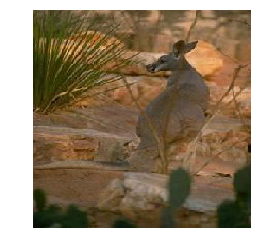

at distance 195.3690432645494:
(Class: pyramid)
at distance 198.1253031264551:
(Class: bonsai)
at distance 199.63338113926687:
(Class: kangaroo)
at distance 201.72186727328165:
(Class: bonsai)
at distance 201.8932828546716:
(Class: pyramid)
5128 1.0
============= original: =============
(Class: airplanes)


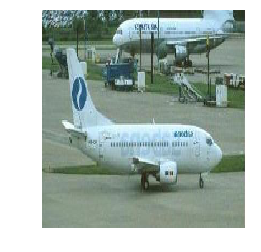

at distance 181.40990660060402:
(Class: airplanes)
at distance 182.0223888130816:
(Class: airplanes)
at distance 182.70008023259012:
(Class: airplanes)
at distance 186.0208916686447:
(Class: airplanes)
at distance 188.9423854708948:
(Class: airplanes)
1646 5.0
============= original: =============
(Class: Faces)


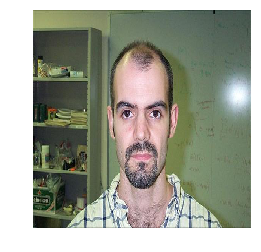

at distance 178.06107676829114:
(Class: Faces)
at distance 178.52610218502906:
(Class: Faces)
at distance 178.97233787481179:
(Class: Faces)
at distance 180.4432136624609:
(Class: Faces)
at distance 182.96950733728173:
(Class: Faces)
4124 5.0
============= original: =============
(Class: dolphin)


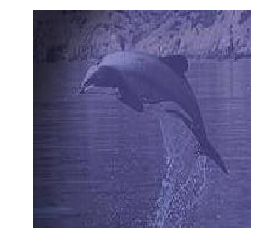

at distance 161.84355092334448:
(Class: pyramid)
at distance 166.39734693918527:
(Class: pyramid)
at distance 167.62380860255786:
(Class: pyramid)
at distance 169.93998817934366:
(Class: pyramid)
at distance 176.75821182015176:
(Class: car_side)
5956 0.0
============= original: =============
(Class: laptop)


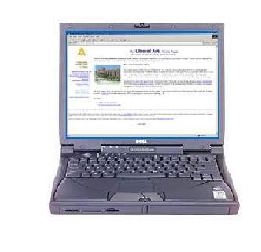

at distance 289.75972431600286:
(Class: laptop)
at distance 293.973785371847:
(Class: laptop)
at distance 298.4157827656618:
(Class: laptop)
at distance 306.26666662339085:
(Class: laptop)
at distance 308.3102622013209:
(Class: laptop)
6218 5.0
============= original: =============
(Class: Faces)


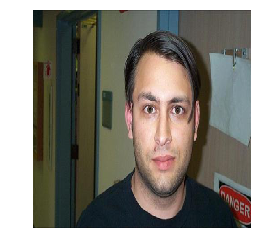

at distance 117.10563375753581:
(Class: Faces)
at distance 125.0887691701048:
(Class: Faces_easy)
at distance 126.50387570822855:
(Class: Faces)
at distance 126.58544621953862:
(Class: Faces)
at distance 126.61166816943589:
(Class: Faces)
4365 4.0
============= original: =============
(Class: mandolin)


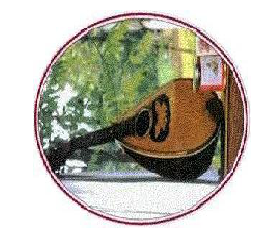

at distance 275.776926210944:
(Class: stapler)
at distance 277.42550681082025:
(Class: bonsai)
at distance 278.72182974379217:
(Class: joshua_tree)
at distance 281.6180178350901:
(Class: cougar_face)
at distance 284.41039035868613:
(Class: bass)
8428 0.0
============= original: =============
(Class: airplanes)


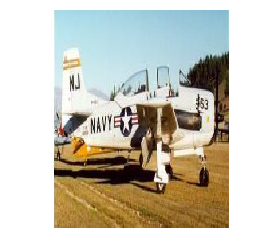

at distance 173.1755061225253:
(Class: airplanes)
at distance 180.89255206484953:
(Class: airplanes)
at distance 181.12164580225658:
(Class: airplanes)
at distance 182.0965844954564:
(Class: airplanes)
at distance 182.25641459172834:
(Class: airplanes)
1820 5.0
============= original: =============
(Class: brain)


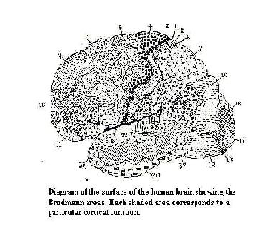

at distance 187.89135102987765:
(Class: cougar_face)
at distance 194.8911890295741:
(Class: snoopy)
at distance 198.08327924433902:
(Class: bass)
at distance 198.56729300912272:
(Class: bass)
at distance 199.5279420748757:
(Class: bass)
6103 0.0
============= original: =============
(Class: crayfish)


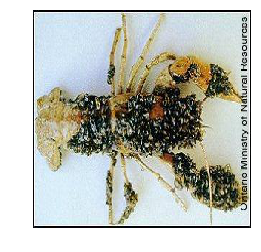

at distance 242.59554309914512:
(Class: joshua_tree)
at distance 244.4259007374555:
(Class: bonsai)
at distance 246.51790657328834:
(Class: Leopards)
at distance 247.07643550198165:
(Class: chandelier)
at distance 247.4753922447876:
(Class: crayfish)
517 1.0
============= original: =============
(Class: Faces)


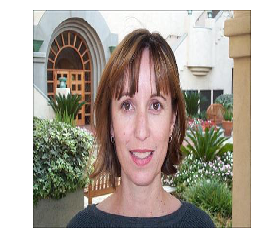

at distance 146.6911695444484:
(Class: Faces)
at distance 149.1684724516408:
(Class: Faces_easy)
at distance 162.66458823526935:
(Class: Faces)
at distance 172.48385686300327:
(Class: Faces)
at distance 174.66947191699327:
(Class: Faces)
4321 4.0
============= original: =============
(Class: chair)


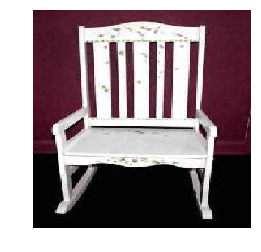

at distance 339.88831925054365:
(Class: chair)
at distance 350.30734876809083:
(Class: chair)
at distance 351.24016524013496:
(Class: chair)
at distance 354.09616809924603:
(Class: windsor_chair)
at distance 356.8570090848572:
(Class: windsor_chair)
627 3.0
============= original: =============
(Class: Motorbikes)


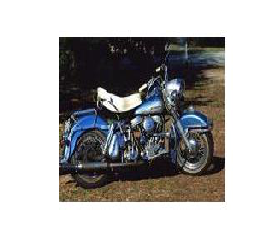

at distance 167.56083116627906:
(Class: Motorbikes)
at distance 179.58975556137938:
(Class: Motorbikes)
at distance 180.81982607273946:
(Class: Motorbikes)
at distance 182.50275553177974:
(Class: Motorbikes)
at distance 182.59504229869088:
(Class: Motorbikes)
2381 5.0
============= original: =============
(Class: cougar_body)


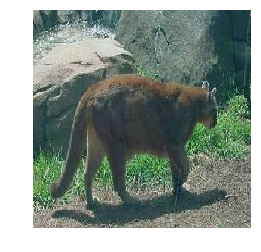

at distance 212.5950814256359:
(Class: cougar_body)
at distance 238.87597102303965:
(Class: cougar_body)
at distance 246.45839083702523:
(Class: pyramid)
at distance 247.47594888428517:
(Class: cougar_body)
at distance 248.96565217375036:
(Class: elephant)
8157 3.0
============= original: =============
(Class: rhino)


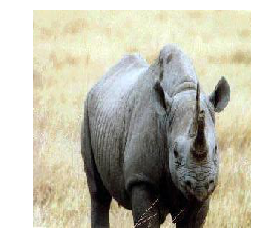

at distance 288.65360331382857:
(Class: rhino)
at distance 301.12662485411386:
(Class: rhino)
at distance 302.128426151061:
(Class: rhino)
at distance 305.29494926391067:
(Class: rhino)
at distance 306.70945846205154:
(Class: rhino)
4664 5.0
============= original: =============
(Class: platypus)


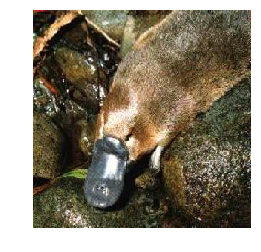

at distance 299.1232483893871:
(Class: platypus)
at distance 299.31580379359565:
(Class: platypus)
at distance 300.4762158229353:
(Class: platypus)
at distance 302.72745033356125:
(Class: platypus)
at distance 304.50341712189817:
(Class: hawksbill)
3651 4.0
============= original: =============
(Class: Motorbikes)


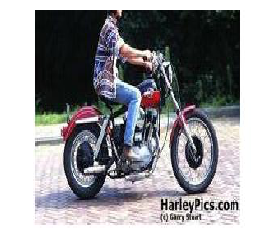

at distance 280.2045165582414:
(Class: Motorbikes)
at distance 280.62368424785586:
(Class: Motorbikes)
at distance 283.8046915757231:
(Class: Motorbikes)
at distance 284.17022240214123:
(Class: Motorbikes)
at distance 287.9029084360979:
(Class: Motorbikes)
3025 5.0
============= original: =============
(Class: dollar_bill)


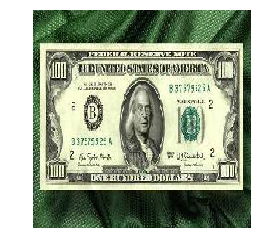

at distance 204.2517242243406:
(Class: dollar_bill)
at distance 219.3847863522138:
(Class: dollar_bill)
at distance 228.19171585923286:
(Class: dollar_bill)
at distance 232.58164189616215:
(Class: dollar_bill)
at distance 236.2117426538894:
(Class: dollar_bill)
145 5.0
============= original: =============
(Class: dolphin)


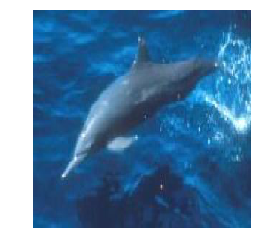

at distance 194.68354677656328:
(Class: dolphin)
at distance 198.9820397091426:
(Class: pyramid)
at distance 200.2246689514238:
(Class: pyramid)
at distance 200.27781707510277:
(Class: dolphin)
at distance 202.9409206227789:
(Class: dolphin)
5943 3.0
============= original: =============
(Class: trilobite)


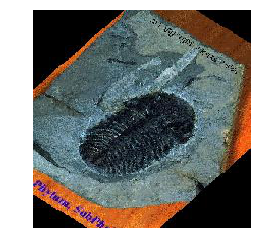

at distance 90.73639574260991:
(Class: trilobite)
at distance 238.34079800654138:
(Class: trilobite)
at distance 240.15013493903612:
(Class: trilobite)
at distance 245.42402719660424:
(Class: trilobite)
at distance 247.3656479368517:
(Class: trilobite)
8124 5.0
============= original: =============
(Class: airplanes)


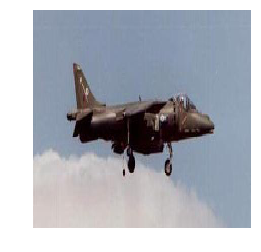

at distance 199.19861133657977:
(Class: airplanes)
at distance 212.00753076717783:
(Class: helicopter)
at distance 220.84286530003075:
(Class: airplanes)
at distance 223.2041782623482:
(Class: airplanes)
at distance 228.05354808687352:
(Class: airplanes)
1810 4.0
============= original: =============
(Class: car_side)


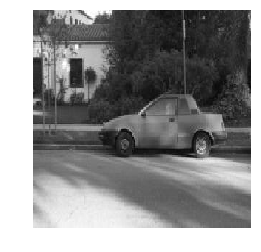

at distance 138.45295012338937:
(Class: car_side)
at distance 138.7889951028834:
(Class: car_side)
at distance 139.98485701480948:
(Class: car_side)
at distance 141.28277218311817:
(Class: car_side)
at distance 142.03050623990302:
(Class: car_side)
770 5.0
============= original: =============
(Class: headphone)


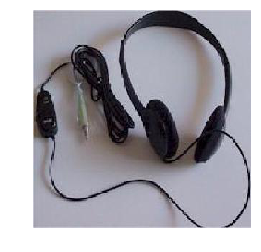

at distance 269.3208184704328:
(Class: headphone)
at distance 279.62842436512653:
(Class: headphone)
at distance 285.2673072756665:
(Class: headphone)
at distance 300.60509335746667:
(Class: headphone)
at distance 301.89349685403744:
(Class: headphone)
2233 5.0
============= original: =============
(Class: Faces)


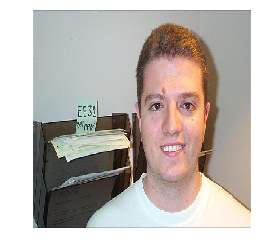

at distance 138.0970927245882:
(Class: Faces)
at distance 139.06318883489118:
(Class: Faces)
at distance 139.50310511304917:
(Class: Faces)
at distance 142.48389203571932:
(Class: Faces_easy)
at distance 145.72850968609552:
(Class: Faces_easy)
4480 3.0
============= original: =============
(Class: ketch)


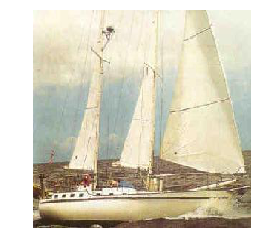

at distance 199.00127235656197:
(Class: ketch)
at distance 205.30978536062:
(Class: ketch)
at distance 214.78346455516694:
(Class: schooner)
at distance 214.98536159598197:
(Class: schooner)
at distance 215.53441797392676:
(Class: schooner)
2093 2.0
============= original: =============
(Class: tick)


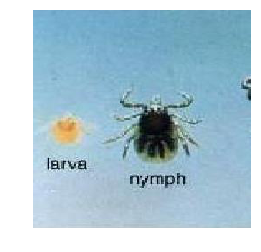

at distance 196.6945997944721:
(Class: strawberry)
at distance 197.13498785852425:
(Class: helicopter)
at distance 208.3583100794244:
(Class: helicopter)
at distance 208.71199330102883:
(Class: pyramid)
at distance 211.48243936809538:
(Class: platypus)
4879 0.0
============= original: =============
(Class: Faces)


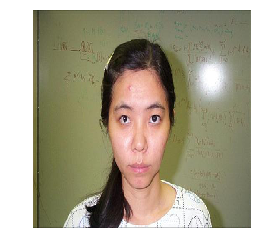

at distance 114.35020979120583:
(Class: Faces)
at distance 131.21737245062857:
(Class: Faces)
at distance 132.24486579422287:
(Class: Faces)
at distance 132.35413679199314:
(Class: Faces)
at distance 133.89974257231708:
(Class: Faces)
4335 5.0
============= original: =============
(Class: llama)


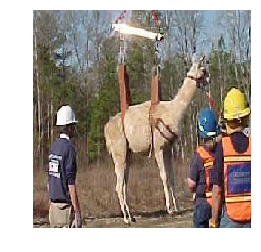

at distance 226.82750769832842:
(Class: gerenuk)
at distance 231.1319291691282:
(Class: brontosaurus)
at distance 234.041012543181:
(Class: pyramid)
at distance 234.31308894013026:
(Class: gerenuk)
at distance 235.34960784294867:
(Class: airplanes)
932 0.0
============= original: =============
(Class: airplanes)


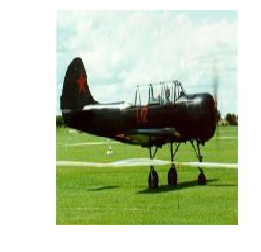

at distance 223.80589200031505:
(Class: airplanes)
at distance 224.9274726094893:
(Class: airplanes)
at distance 225.42377362810882:
(Class: airplanes)
at distance 225.92047494328577:
(Class: airplanes)
at distance 226.9525422181324:
(Class: airplanes)
1865 5.0
============= original: =============
(Class: Faces)


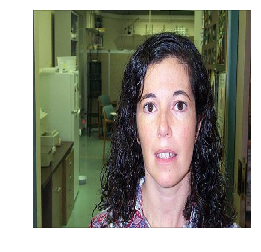

at distance 116.15195063328736:
(Class: Faces)
at distance 116.26865958503251:
(Class: Faces)
at distance 132.8252449691765:
(Class: Faces)
at distance 136.13315362662476:
(Class: Faces)
at distance 137.56902238681448:
(Class: Faces)
4148 5.0
============= original: =============
(Class: chandelier)


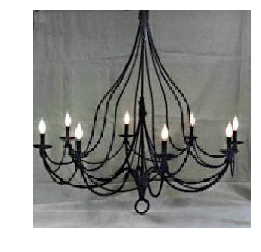

at distance 246.44136921031043:
(Class: chandelier)
at distance 251.88744914952684:
(Class: menorah)
at distance 251.9022162429535:
(Class: pyramid)
at distance 253.72796920828281:
(Class: pyramid)
at distance 254.681369954773:
(Class: pyramid)
713 1.0
============= original: =============
(Class: soccer_ball)


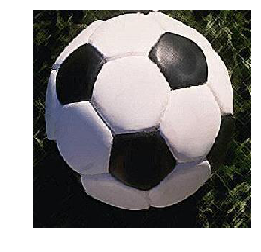

at distance 331.40261303734746:
(Class: soccer_ball)
at distance 337.96462981510115:
(Class: soccer_ball)
at distance 342.1713286275704:
(Class: soccer_ball)
at distance 348.7577991296465:
(Class: soccer_ball)
at distance 355.84995003881545:
(Class: soccer_ball)
5940 5.0
============= original: =============
(Class: Motorbikes)


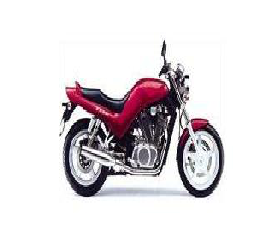

at distance 194.86681095512665:
(Class: Motorbikes)
at distance 198.6514257811499:
(Class: Motorbikes)
at distance 205.2372930097652:
(Class: Motorbikes)
at distance 212.28612475898242:
(Class: Motorbikes)
at distance 212.46980820253498:
(Class: Motorbikes)
2905 5.0
============= original: =============
(Class: camera)


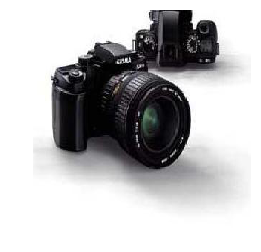

at distance 298.7037444825689:
(Class: camera)
at distance 304.2234679026524:
(Class: camera)
at distance 306.58494021585955:
(Class: camera)
at distance 307.7275360293583:
(Class: camera)
at distance 311.47385742169433:
(Class: watch)
6306 4.0
============= original: =============
(Class: watch)


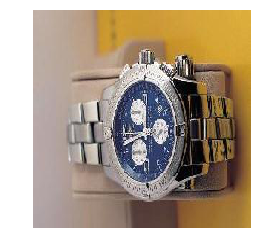

at distance 221.16352635951705:
(Class: watch)
at distance 230.4280969415805:
(Class: watch)
at distance 239.88102133518146:
(Class: watch)
at distance 247.90166493715705:
(Class: watch)
at distance 249.6399621648995:
(Class: watch)
1030 5.0
============= original: =============
(Class: camera)


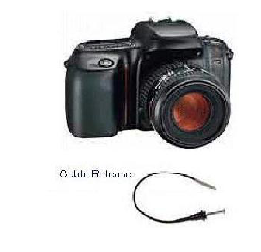

at distance 293.8341376511262:
(Class: camera)
at distance 300.8404192797672:
(Class: camera)
at distance 309.62040456615165:
(Class: camera)
at distance 312.48701855063086:
(Class: camera)
at distance 312.95773966332627:
(Class: camera)
6294 5.0
============= original: =============
(Class: stegosaurus)


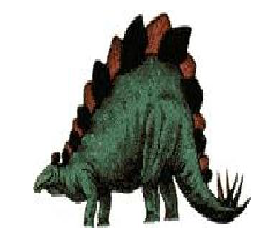

at distance 229.0552716973815:
(Class: stegosaurus)
at distance 231.02197639978212:
(Class: chandelier)
at distance 232.5198938923424:
(Class: cougar_face)
at distance 234.95874344647328:
(Class: stegosaurus)
at distance 235.04340694898508:
(Class: bass)
6758 2.0
============= original: =============
(Class: chandelier)


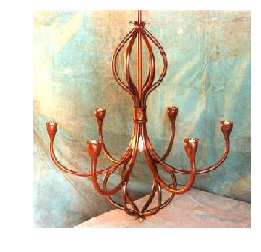

at distance 273.9176536504786:
(Class: chandelier)
at distance 293.8046299915239:
(Class: menorah)
at distance 293.81219040220765:
(Class: octopus)
at distance 294.19431609644084:
(Class: octopus)
at distance 299.6599188956159:
(Class: chandelier)
723 2.0
============= original: =============
(Class: hedgehog)


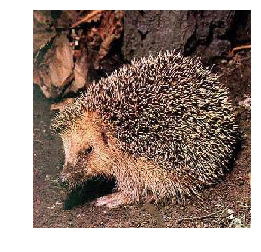

at distance 277.04819839454535:
(Class: hedgehog)
at distance 277.7911196972172:
(Class: hedgehog)
at distance 289.61318549960157:
(Class: hedgehog)
at distance 299.2260296313635:
(Class: hedgehog)
at distance 305.2292535124329:
(Class: hedgehog)
5741 5.0
============= original: =============
(Class: pagoda)


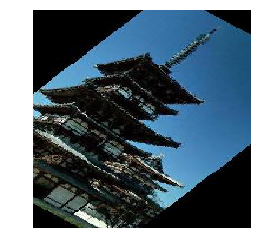

at distance 180.51253519720754:
(Class: pagoda)
at distance 181.87594674549027:
(Class: pagoda)
at distance 186.12327529491907:
(Class: pagoda)
at distance 191.37567276393608:
(Class: pagoda)
at distance 191.545129538976:
(Class: pagoda)
4506 5.0
============= original: =============
(Class: platypus)


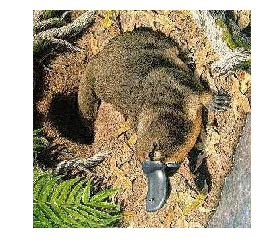

at distance 227.41984354514784:
(Class: bonsai)
at distance 227.73238742299955:
(Class: pyramid)
at distance 228.3833192501804:
(Class: scorpion)
at distance 229.35819000365544:
(Class: crocodile_head)
at distance 229.70326526931362:
(Class: pyramid)
3663 0.0
============= original: =============
(Class: sea_horse)


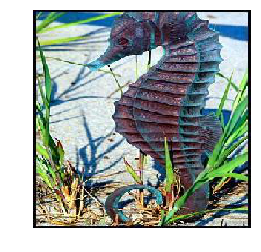

at distance 251.5696908254279:
(Class: Leopards)
at distance 253.46249534059635:
(Class: Leopards)
at distance 253.70293628886802:
(Class: Leopards)
at distance 255.36285734212782:
(Class: Leopards)
at distance 257.64389602461546:
(Class: Leopards)
3121 0.0
============= original: =============
(Class: Faces_easy)


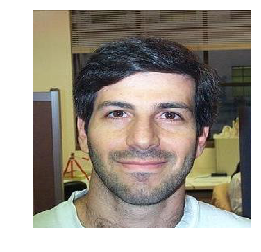

at distance 139.69999248612672:
(Class: Faces_easy)
at distance 143.0640591783961:
(Class: Faces_easy)
at distance 143.59546926408984:
(Class: Faces_easy)
at distance 147.10978667929814:
(Class: Faces_easy)
at distance 147.27009580112508:
(Class: Faces_easy)
7098 5.0
============= original: =============
(Class: hedgehog)


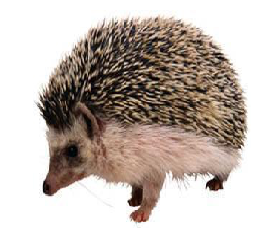

at distance 321.564652226001:
(Class: hedgehog)
at distance 344.55357469303675:
(Class: hedgehog)
at distance 357.3816885317351:
(Class: hedgehog)
at distance 358.55070693006945:
(Class: hedgehog)
at distance 368.5183319463938:
(Class: hedgehog)
5773 5.0
============= original: =============
(Class: Faces_easy)


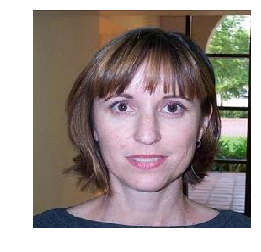

at distance 112.26453017452498:
(Class: Faces_easy)
at distance 117.17719997218006:
(Class: Faces_easy)
at distance 118.10342770026395:
(Class: Faces_easy)
at distance 120.30606665513153:
(Class: Faces_easy)
at distance 120.87241149788355:
(Class: Faces_easy)
7141 5.0
============= original: =============
(Class: kangaroo)


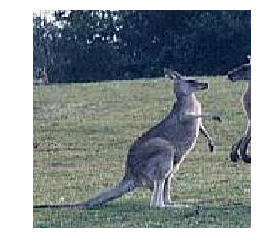

at distance 237.6222826788003:
(Class: kangaroo)
at distance 268.4783180785646:
(Class: kangaroo)
at distance 269.08545152825053:
(Class: llama)
at distance 272.6735815025373:
(Class: kangaroo)
at distance 274.19944952946145:
(Class: joshua_tree)
5126 3.0
============= original: =============
(Class: dragonfly)


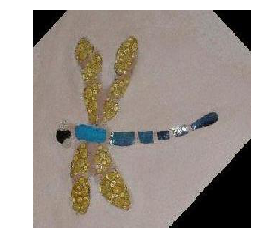

at distance 191.20340952627913:
(Class: pyramid)
at distance 193.2479845695273:
(Class: scissors)
at distance 194.3443585923218:
(Class: pagoda)
at distance 195.1041982639546:
(Class: buddha)
at distance 195.95299776541611:
(Class: revolver)
3277 0.0
============= original: =============
(Class: sea_horse)


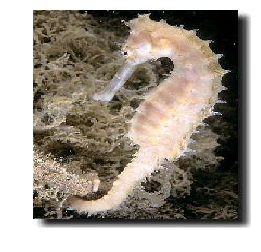

at distance 246.18548339690915:
(Class: sea_horse)
at distance 265.51655242038277:
(Class: crocodile_head)
at distance 265.85684967916336:
(Class: sea_horse)
at distance 268.4037487866207:
(Class: sea_horse)
at distance 268.8774354874217:
(Class: octopus)
3111 3.0
============= original: =============
(Class: umbrella)


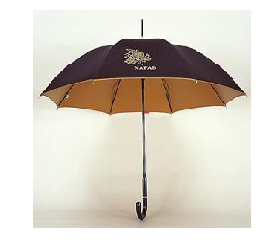

at distance 268.5858412046506:
(Class: umbrella)
at distance 272.5589641891388:
(Class: umbrella)
at distance 276.43218198449375:
(Class: umbrella)
at distance 286.91030096783584:
(Class: umbrella)
at distance 287.61359222019314:
(Class: umbrella)
5562 5.0
============= original: =============
(Class: pyramid)


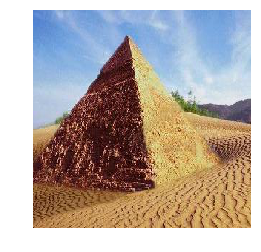

at distance 225.25932645724706:
(Class: pyramid)
at distance 225.30622282326937:
(Class: pyramid)
at distance 227.63391299440244:
(Class: pyramid)
at distance 228.30164641511348:
(Class: pyramid)
at distance 228.47618767513296:
(Class: pyramid)
53 5.0
============= original: =============
(Class: emu)


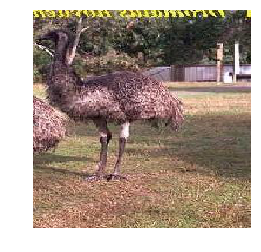

at distance 212.0896650418116:
(Class: emu)
at distance 221.4549159344539:
(Class: emu)
at distance 221.97068603047933:
(Class: emu)
at distance 230.18928788726058:
(Class: llama)
at distance 234.85190779775803:
(Class: brontosaurus)
6143 3.0
============= original: =============
(Class: ant)


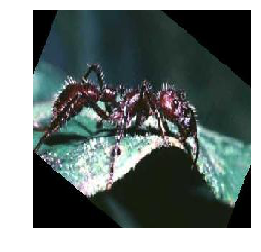

at distance 225.64195399450045:
(Class: ant)
at distance 227.46747710827364:
(Class: pagoda)
at distance 230.8689073411305:
(Class: pyramid)
at distance 231.2508684597748:
(Class: pagoda)
at distance 231.87037984204952:
(Class: minaret)
2013 1.0
============= original: =============
(Class: beaver)


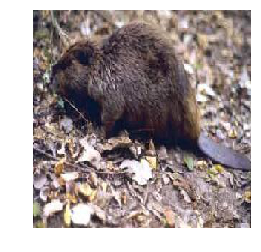

at distance 238.10023085132232:
(Class: beaver)
at distance 256.63450802079245:
(Class: beaver)
at distance 257.3489210647736:
(Class: beaver)
at distance 264.01640697139027:
(Class: beaver)
at distance 265.60895864081834:
(Class: beaver)
7718 5.0
============= original: =============
(Class: Faces)


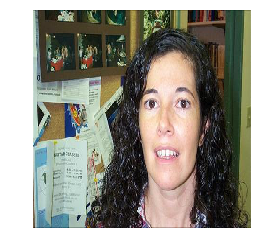

at distance 147.71093495401595:
(Class: Faces_easy)
at distance 152.35446786700854:
(Class: Faces)
at distance 153.41466631532413:
(Class: Faces)
at distance 154.6954343874783:
(Class: Faces)
at distance 156.29478930052932:
(Class: Faces)
4385 4.0
============= original: =============
(Class: barrel)


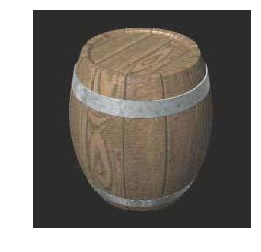

at distance 173.2828724319847:
(Class: barrel)
at distance 213.31805195177222:
(Class: pyramid)
at distance 216.86210333369831:
(Class: pyramid)
at distance 218.99926361165632:
(Class: barrel)
at distance 222.21932526095847:
(Class: barrel)
6478 3.0
============= original: =============
(Class: ibis)


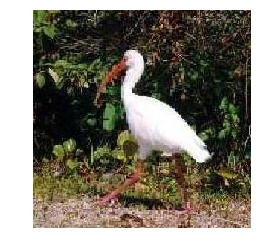

at distance 232.8755287051919:
(Class: ibis)
at distance 235.91426169420052:
(Class: ibis)
at distance 241.82958224014848:
(Class: flamingo)
at distance 244.3569976246715:
(Class: ibis)
at distance 246.47513211705638:
(Class: ibis)
4849 4.0
============= original: =============
(Class: cougar_body)


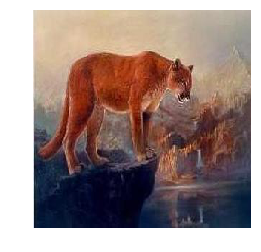

at distance 222.25039025696432:
(Class: cougar_body)
at distance 238.87597102303965:
(Class: cougar_body)
at distance 244.43060349277735:
(Class: cougar_body)
at distance 245.84259816595375:
(Class: gerenuk)
at distance 254.33008264504184:
(Class: gerenuk)
8168 3.0
============= original: =============
(Class: Faces)


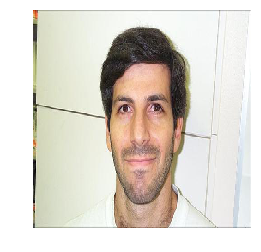

at distance 131.05125034980267:
(Class: Faces)
at distance 134.784685542324:
(Class: Faces)
at distance 135.96008175980143:
(Class: Faces_easy)
at distance 139.04001979526268:
(Class: Faces_easy)
at distance 139.44900598043134:
(Class: Faces)
4281 3.0
============= original: =============
(Class: metronome)


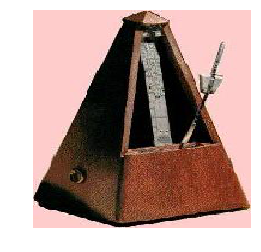

at distance 128.8655837731744:
(Class: metronome)
at distance 217.77601879228024:
(Class: metronome)
at distance 236.8139059986331:
(Class: metronome)
at distance 238.63552955228073:
(Class: metronome)
at distance 239.011239101013:
(Class: metronome)
5369 5.0
============= original: =============
(Class: Faces_easy)


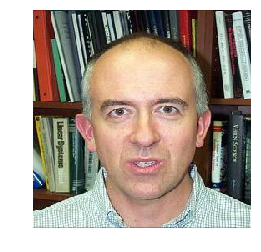

at distance 217.978326019154:
(Class: Faces_easy)
at distance 222.50956795863024:
(Class: Faces_easy)
at distance 225.870044445635:
(Class: Faces_easy)
at distance 234.65996285328748:
(Class: Faces_easy)
at distance 236.504045263992:
(Class: Faces_easy)
7387 5.0
============= original: =============
(Class: airplanes)


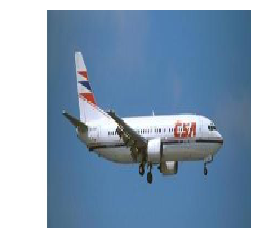

at distance 143.839307988486:
(Class: airplanes)
at distance 146.8066499341058:
(Class: airplanes)
at distance 148.23499726533475:
(Class: airplanes)
at distance 148.34835436793614:
(Class: airplanes)
at distance 149.89594385974448:
(Class: airplanes)
1237 5.0
============= original: =============
(Class: Motorbikes)


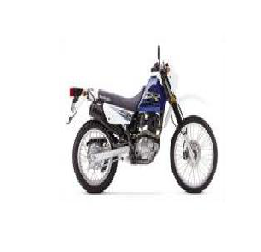

at distance 120.4036236851118:
(Class: Motorbikes)
at distance 153.5632785441146:
(Class: Motorbikes)
at distance 163.92083550635806:
(Class: Motorbikes)
at distance 164.15228708681659:
(Class: Motorbikes)
at distance 164.6352936378262:
(Class: Motorbikes)
2435 5.0
============= original: =============
(Class: euphonium)


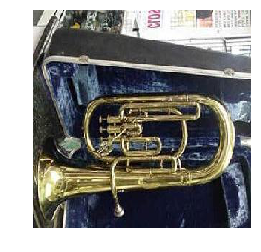

at distance 346.33713001353607:
(Class: euphonium)
at distance 355.98136838828685:
(Class: euphonium)
at distance 359.3180678342322:
(Class: euphonium)
at distance 360.8090328452685:
(Class: euphonium)
at distance 364.6588114842903:
(Class: euphonium)
7812 5.0
============= original: =============
(Class: elephant)


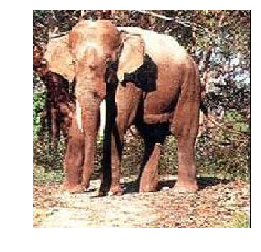

at distance 201.3098468055302:
(Class: elephant)
at distance 208.9912822947369:
(Class: joshua_tree)
at distance 209.42988381057984:
(Class: pyramid)
at distance 210.0795155787277:
(Class: rhino)
at distance 210.20582396874548:
(Class: joshua_tree)
120 1.0
============= original: =============
(Class: dollar_bill)


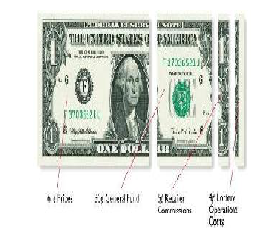

at distance 206.02387679271104:
(Class: dollar_bill)
at distance 217.1109729860164:
(Class: dollar_bill)
at distance 220.12718615880902:
(Class: dollar_bill)
at distance 220.53831782793605:
(Class: dollar_bill)
at distance 221.67053143260682:
(Class: dollar_bill)
138 5.0
============= original: =============
(Class: watch)


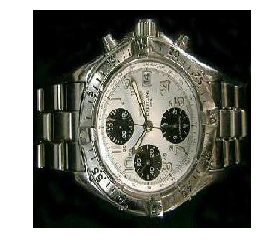

at distance 288.3773412457494:
(Class: watch)
at distance 289.06635353023205:
(Class: watch)
at distance 291.1116817937905:
(Class: watch)
at distance 297.8075400294762:
(Class: watch)
at distance 302.13324998858025:
(Class: watch)
1027 5.0
============= original: =============
(Class: euphonium)


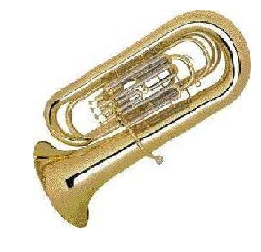

at distance 267.5952000817924:
(Class: euphonium)
at distance 281.81711804290467:
(Class: euphonium)
at distance 287.2508163059951:
(Class: euphonium)
at distance 298.0305654539581:
(Class: euphonium)
at distance 301.2411034463732:
(Class: euphonium)
7813 5.0
============= original: =============
(Class: panda)


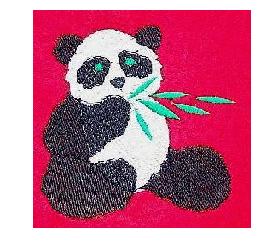

at distance 295.8274027809922:
(Class: strawberry)
at distance 301.4859484145009:
(Class: butterfly)
at distance 304.72757950681705:
(Class: panda)
at distance 318.6892409329848:
(Class: yin_yang)
at distance 321.22081985102744:
(Class: garfield)
3579 1.0
============= original: =============
(Class: beaver)


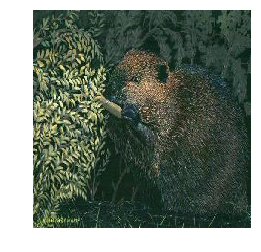

at distance 186.49635839957782:
(Class: beaver)
at distance 191.7770778960262:
(Class: Leopards)
at distance 191.98266831287347:
(Class: pyramid)
at distance 193.6305475372226:
(Class: Leopards)
at distance 194.9768740742592:
(Class: bonsai)
7725 1.0
============= original: =============
(Class: joshua_tree)


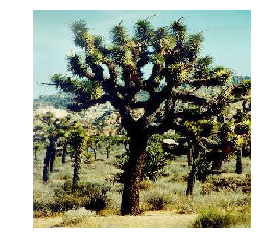

at distance 129.47389635019172:
(Class: joshua_tree)
at distance 133.71133359044762:
(Class: joshua_tree)
at distance 135.03768446105138:
(Class: joshua_tree)
at distance 136.52777635427884:
(Class: joshua_tree)
at distance 139.82599871801312:
(Class: joshua_tree)
5848 5.0
============= original: =============
(Class: scorpion)


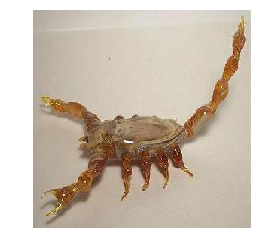

at distance 259.1884027136314:
(Class: octopus)
at distance 260.9963260125233:
(Class: scorpion)
at distance 266.1944017380784:
(Class: anchor)
at distance 266.8619161097088:
(Class: platypus)
at distance 269.1847375807414:
(Class: crayfish)
6834 1.0
============= original: =============
(Class: okapi)


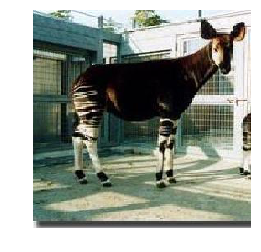

at distance 261.1393856164591:
(Class: okapi)
at distance 271.7822430662025:
(Class: okapi)
at distance 272.6170787135323:
(Class: okapi)
at distance 278.0903754684916:
(Class: gerenuk)
at distance 278.81191017610655:
(Class: okapi)
3788 4.0
============= original: =============
(Class: Motorbikes)


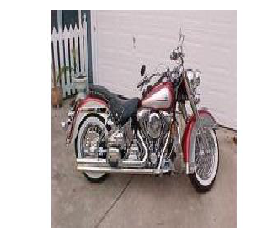

at distance 193.51571577796255:
(Class: Motorbikes)
at distance 193.9446149419048:
(Class: Motorbikes)
at distance 194.57206710296978:
(Class: Motorbikes)
at distance 198.15386864190378:
(Class: Motorbikes)
at distance 201.59003969185426:
(Class: Motorbikes)
2981 5.0
============= original: =============
(Class: buddha)


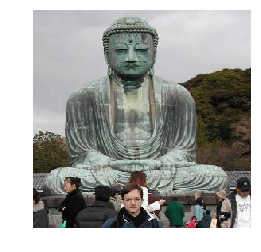

at distance 187.4051128894764:
(Class: buddha)
at distance 193.6340250881479:
(Class: buddha)
at distance 200.06459546730758:
(Class: buddha)
at distance 217.30678155735313:
(Class: pyramid)
at distance 217.7775405235586:
(Class: buddha)
8336 4.0
============= original: =============
(Class: airplanes)


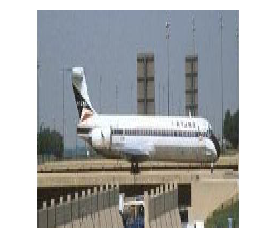

at distance 168.8772530390584:
(Class: airplanes)
at distance 170.05022660229213:
(Class: airplanes)
at distance 179.00127419257154:
(Class: airplanes)
at distance 181.54950270350312:
(Class: airplanes)
at distance 183.0540058320184:
(Class: airplanes)
1884 5.0
============= original: =============
(Class: airplanes)


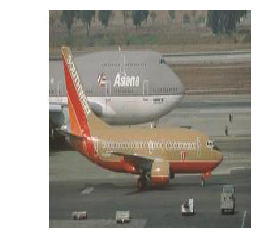

at distance 174.50491911106806:
(Class: airplanes)
at distance 175.42755900142893:
(Class: airplanes)
at distance 177.18724416988184:
(Class: airplanes)
at distance 179.08904968155014:
(Class: airplanes)
at distance 179.28399142390674:
(Class: airplanes)
1626 5.0
============= original: =============
(Class: emu)


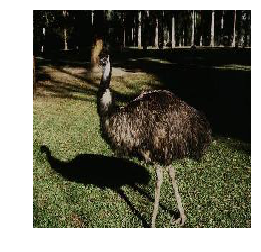

at distance 236.11324068199377:
(Class: emu)
at distance 241.62955464156258:
(Class: emu)
at distance 244.0323768091982:
(Class: llama)
at distance 245.24053580039273:
(Class: brontosaurus)
at distance 245.83507625995452:
(Class: emu)
6147 3.0
============= original: =============
(Class: Motorbikes)


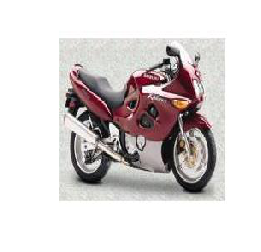

at distance 192.5239961143377:
(Class: Motorbikes)
at distance 192.60546196661204:
(Class: Motorbikes)
at distance 203.6868300402975:
(Class: Motorbikes)
at distance 204.51668716823022:
(Class: Motorbikes)
at distance 205.35514156834503:
(Class: Motorbikes)
2560 5.0
============= original: =============
(Class: joshua_tree)


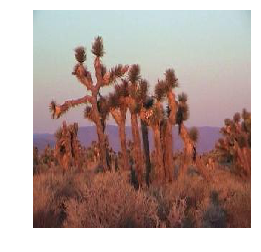

at distance 128.79062732496735:
(Class: joshua_tree)
at distance 138.5891946485271:
(Class: joshua_tree)
at distance 140.00685829460764:
(Class: joshua_tree)
at distance 140.62838442103745:
(Class: joshua_tree)
at distance 146.3624479218053:
(Class: joshua_tree)
5849 5.0
============= original: =============
(Class: Leopards)


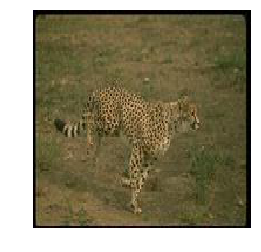

at distance 86.97781718148663:
(Class: Leopards)
at distance 127.13774189403402:
(Class: Leopards)
at distance 133.4673222413448:
(Class: Leopards)
at distance 145.6393025710839:
(Class: Leopards)
at distance 147.00442773468282:
(Class: Leopards)
5249 5.0
============= original: =============
(Class: cellphone)


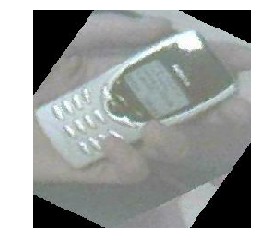

at distance 189.6765420182111:
(Class: pagoda)
at distance 193.3662153367647:
(Class: minaret)
at distance 196.4935339595667:
(Class: ant)
at distance 196.8456396024748:
(Class: minaret)
at distance 198.17400166041443:
(Class: accordion)
8667 0.0
============= original: =============
(Class: stapler)


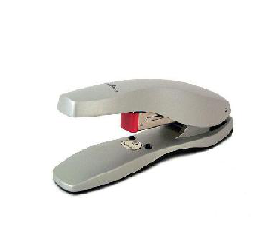

at distance 223.83119180318786:
(Class: stapler)
at distance 239.44209928554068:
(Class: watch)
at distance 239.47322997296482:
(Class: umbrella)
at distance 240.98172669556405:
(Class: wrench)
at distance 244.33630916116834:
(Class: stapler)
2072 2.0
============= original: =============
(Class: Faces_easy)


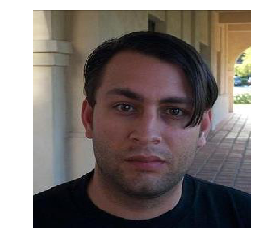

at distance 113.66646894625678:
(Class: Faces_easy)
at distance 116.59438102064178:
(Class: Faces)
at distance 128.01994332364038:
(Class: Faces_easy)
at distance 136.51158181741556:
(Class: Faces_easy)
at distance 139.6527743612753:
(Class: Faces_easy)
7065 4.0
============= original: =============
(Class: brontosaurus)


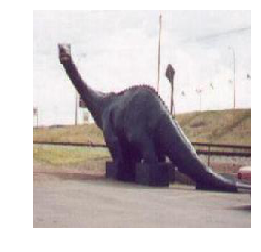

at distance 238.97505422593935:
(Class: airplanes)
at distance 239.67298368088464:
(Class: brontosaurus)
at distance 241.87497520318632:
(Class: brontosaurus)
at distance 246.380865743408:
(Class: brontosaurus)
at distance 248.32976698189964:
(Class: pyramid)
8201 3.0
============= original: =============
(Class: Leopards)


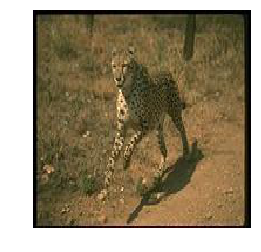

at distance 72.57013944855115:
(Class: Leopards)
at distance 137.21839626015498:
(Class: Leopards)
at distance 140.38818244558556:
(Class: Leopards)
at distance 144.3449056630016:
(Class: Leopards)
at distance 150.65390505086475:
(Class: Leopards)
5275 5.0
============= original: =============
(Class: crayfish)


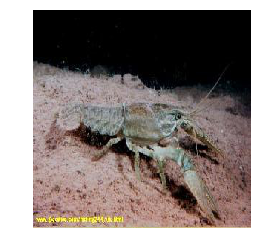

at distance 49.24888923695696:
(Class: crayfish)
at distance 201.9169833462431:
(Class: crocodile_head)
at distance 205.42797558841332:
(Class: crab)
at distance 205.8988219177784:
(Class: scorpion)
at distance 208.31374064541362:
(Class: platypus)
500 1.0
============= original: =============
(Class: starfish)


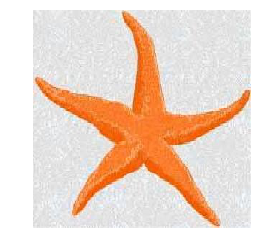

at distance 283.7022289112974:
(Class: starfish)
at distance 296.26453359025174:
(Class: starfish)
at distance 299.3463167737995:
(Class: starfish)
at distance 301.4264593356961:
(Class: starfish)
at distance 303.50362547042926:
(Class: starfish)
8024 5.0
============= original: =============
(Class: airplanes)


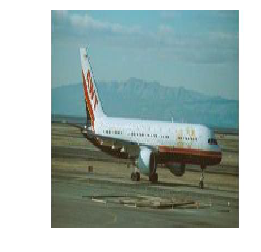

at distance 155.47529671108794:
(Class: airplanes)
at distance 157.24427678215483:
(Class: airplanes)
at distance 157.97901011983572:
(Class: airplanes)
at distance 158.00679723360298:
(Class: airplanes)
at distance 161.3581306279741:
(Class: airplanes)
1452 5.0
============= original: =============
(Class: tick)


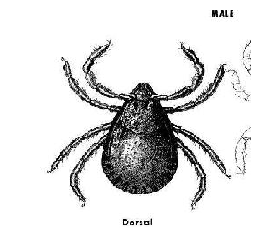

at distance 314.48092684805107:
(Class: tick)
at distance 338.41998136170764:
(Class: tick)
at distance 343.81741154553293:
(Class: tick)
at distance 346.1197024272364:
(Class: crab)
at distance 347.1046291913234:
(Class: tick)
4904 4.0
============= original: =============
(Class: Motorbikes)


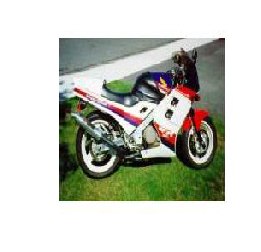

at distance 220.5013494225414:
(Class: Motorbikes)
at distance 220.56758724971237:
(Class: Motorbikes)
at distance 222.25766070452477:
(Class: Motorbikes)
at distance 226.67353411059656:
(Class: Motorbikes)
at distance 228.4063031744725:
(Class: Motorbikes)
2317 5.0
============= original: =============
(Class: scorpion)


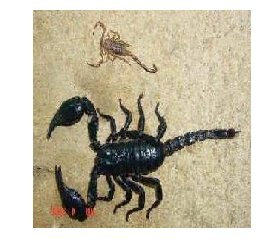

at distance 320.0842870976325:
(Class: scorpion)
at distance 338.91094518685685:
(Class: scorpion)
at distance 342.32788592378773:
(Class: scorpion)
at distance 359.3007676522395:
(Class: scorpion)
at distance 359.87563090678884:
(Class: scorpion)
6898 5.0
============= original: =============
(Class: ant)


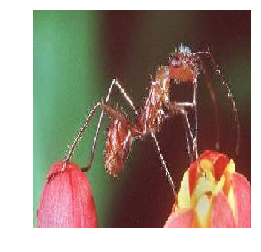

at distance 344.76796886570855:
(Class: ant)
at distance 349.1595888011372:
(Class: tick)
at distance 354.3862904910321:
(Class: mayfly)
at distance 355.52027295119217:
(Class: octopus)
at distance 358.46985441612617:
(Class: mayfly)
2001 1.0
============= original: =============
(Class: car_side)


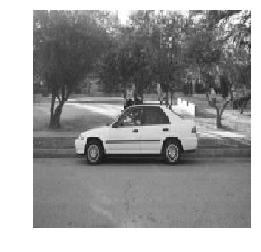

at distance 105.27491332638964:
(Class: car_side)
at distance 123.48227710299864:
(Class: car_side)
at distance 123.65627031263242:
(Class: car_side)
at distance 123.69729446615038:
(Class: car_side)
at distance 124.96794722741484:
(Class: car_side)
859 5.0
============= original: =============
(Class: pigeon)


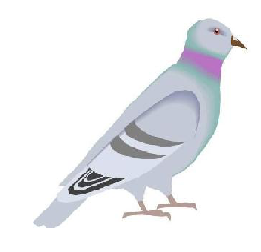

at distance 229.4540316560227:
(Class: bonsai)
at distance 230.70489906259272:
(Class: pyramid)
at distance 232.3242574205295:
(Class: buddha)
at distance 232.6261447266795:
(Class: bass)
at distance 233.28880347233707:
(Class: pyramid)
8560 0.0
============= original: =============
(Class: pyramid)


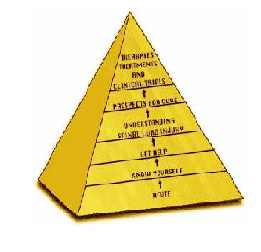

at distance 220.90008960473378:
(Class: pyramid)
at distance 256.9705947790989:
(Class: pyramid)
at distance 258.4952366214628:
(Class: metronome)
at distance 258.96154728693017:
(Class: pyramid)
at distance 263.9127263927296:
(Class: metronome)
44 3.0
============= original: =============
(Class: hedgehog)


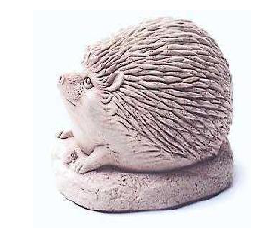

at distance 214.41546724342174:
(Class: strawberry)
at distance 214.58211838529775:
(Class: cougar_face)
at distance 214.76262101226405:
(Class: pyramid)
at distance 215.0480906746875:
(Class: pyramid)
at distance 216.89296198988035:
(Class: pyramid)
5758 0.0
============= original: =============
(Class: Motorbikes)


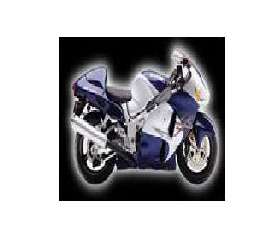

at distance 211.52068548476646:
(Class: Motorbikes)
at distance 213.23872011238802:
(Class: Motorbikes)
at distance 213.71592704474492:
(Class: Motorbikes)
at distance 214.42609337212986:
(Class: Motorbikes)
at distance 214.74223076195108:
(Class: Motorbikes)
2971 5.0
============= original: =============
(Class: minaret)


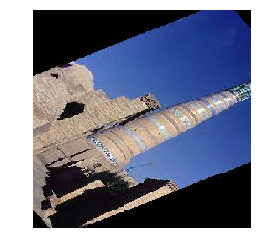

at distance 156.74631234442035:
(Class: minaret)
at distance 157.3535735530908:
(Class: minaret)
at distance 166.25197655304385:
(Class: minaret)
at distance 169.39276369347743:
(Class: minaret)
at distance 173.03761657740736:
(Class: minaret)
7032 5.0
============= original: =============
(Class: inline_skate)


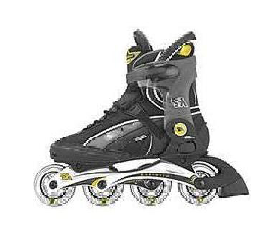

at distance 225.09595564984346:
(Class: inline_skate)
at distance 229.13929897363923:
(Class: inline_skate)
at distance 231.63917762546257:
(Class: inline_skate)
at distance 235.54111047716847:
(Class: inline_skate)
at distance 237.8537608706678:
(Class: cougar_face)
5692 4.0
============= original: =============
(Class: Faces)


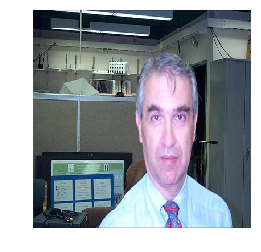

at distance 170.13433339938737:
(Class: Faces)
at distance 176.42715205344084:
(Class: Faces)
at distance 180.04732366629787:
(Class: Faces)
at distance 180.98899505132914:
(Class: Faces)
at distance 181.21463626584028:
(Class: Faces)
4301 5.0
============= original: =============
(Class: cup)


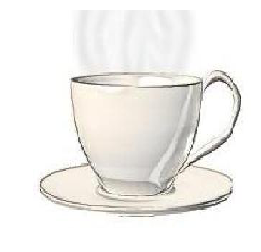

at distance 238.90225569161632:
(Class: cup)
at distance 253.43504479900918:
(Class: cup)
at distance 258.88842998964367:
(Class: cougar_face)
at distance 265.1879618326423:
(Class: bonsai)
at distance 267.0957330358604:
(Class: bass)
7670 2.0
============= original: =============
(Class: ketch)


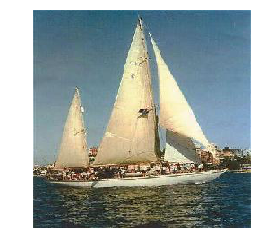

at distance 234.91370203921343:
(Class: ketch)
at distance 235.6990027862457:
(Class: schooner)
at distance 237.12294363378737:
(Class: ketch)
at distance 237.36700134103023:
(Class: schooner)
at distance 238.9199116893705:
(Class: ketch)
2175 3.0
============= original: =============
(Class: Motorbikes)


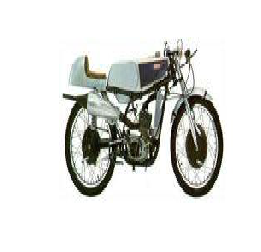

at distance 201.10234245737058:
(Class: Motorbikes)
at distance 202.6025973151943:
(Class: Motorbikes)
at distance 205.4612177370381:
(Class: Motorbikes)
at distance 206.0828401747591:
(Class: Motorbikes)
at distance 207.53403545374357:
(Class: Motorbikes)
2482 5.0
============= original: =============
(Class: nautilus)


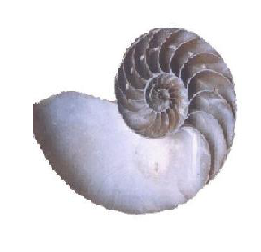

at distance 264.61049745172056:
(Class: nautilus)
at distance 272.01997816336603:
(Class: nautilus)
at distance 275.1536664568071:
(Class: nautilus)
at distance 284.869560061818:
(Class: nautilus)
at distance 286.1271434836598:
(Class: nautilus)
5606 5.0
============= original: =============
(Class: watch)


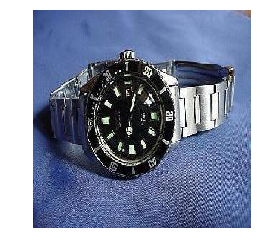

at distance 255.22565458624453:
(Class: watch)
at distance 267.6631828855502:
(Class: watch)
at distance 270.78813974557175:
(Class: watch)
at distance 273.7336345036528:
(Class: watch)
at distance 277.65315819894914:
(Class: watch)
1105 5.0
============= original: =============
(Class: rooster)


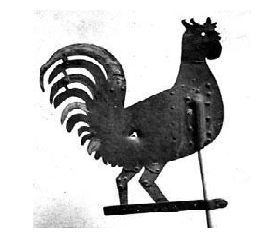

at distance 263.1937682782265:
(Class: cougar_face)
at distance 271.3818619781487:
(Class: stegosaurus)
at distance 271.8107128442991:
(Class: helicopter)
at distance 272.0468746546125:
(Class: crab)
at distance 273.5392104066077:
(Class: pyramid)
5678 0.0
============= original: =============
(Class: watch)


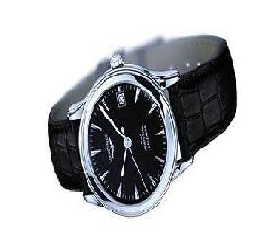

at distance 249.81299728480204:
(Class: watch)
at distance 251.16640517317427:
(Class: watch)
at distance 255.88699489810583:
(Class: watch)
at distance 264.44044655050914:
(Class: watch)
at distance 265.5954403362348:
(Class: Motorbikes)
1095 4.0
============= original: =============
(Class: Leopards)


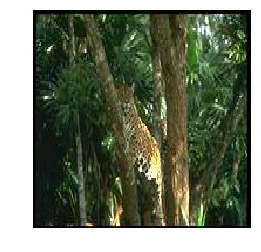

at distance 52.863420350906964:
(Class: Leopards)
at distance 135.65395586711264:
(Class: Leopards)
at distance 141.98112068372626:
(Class: Leopards)
at distance 150.97897222680683:
(Class: Leopards)
at distance 154.91169847298409:
(Class: Leopards)
5161 5.0
============= original: =============
(Class: soccer_ball)


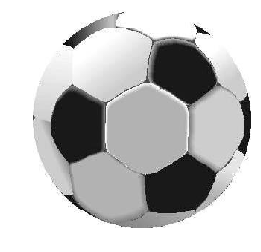

at distance 306.3767151954213:
(Class: soccer_ball)
at distance 306.9333782398494:
(Class: soccer_ball)
at distance 349.04271309967874:
(Class: soccer_ball)
at distance 350.30239296200364:
(Class: soccer_ball)
at distance 350.5074935975814:
(Class: soccer_ball)
5904 5.0
============= original: =============
(Class: watch)


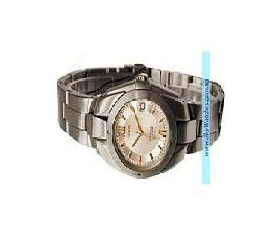

at distance 220.6989573043916:
(Class: watch)
at distance 221.61435492339214:
(Class: watch)
at distance 221.75341824675408:
(Class: watch)
at distance 236.24363625674812:
(Class: watch)
at distance 242.7315423046155:
(Class: watch)
1189 5.0
============= original: =============
(Class: umbrella)


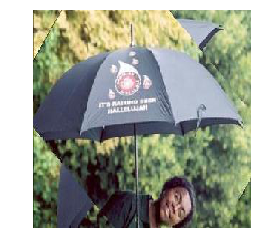

at distance 237.98537655302914:
(Class: umbrella)
at distance 241.44355545418293:
(Class: umbrella)
at distance 241.45792115661206:
(Class: umbrella)
at distance 254.589813560547:
(Class: umbrella)
at distance 261.6006899736464:
(Class: umbrella)
5545 5.0
============= original: =============
(Class: lamp)


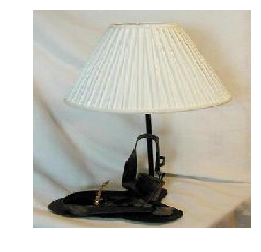

at distance 234.23291750138165:
(Class: lamp)
at distance 258.52668153448724:
(Class: lamp)
at distance 259.0921543195897:
(Class: lamp)
at distance 261.0559443772158:
(Class: lamp)
at distance 263.73393010222406:
(Class: lamp)
6729 5.0
============= original: =============
(Class: dragonfly)


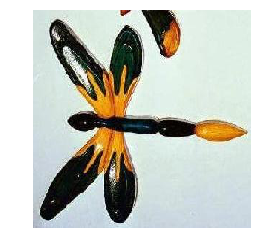

at distance 324.5498633265826:
(Class: dragonfly)
at distance 325.3258459893357:
(Class: dragonfly)
at distance 334.4198533233947:
(Class: dragonfly)
at distance 344.87539510069195:
(Class: dragonfly)
at distance 346.83405511387747:
(Class: dragonfly)
3229 5.0
============= original: =============
(Class: Motorbikes)


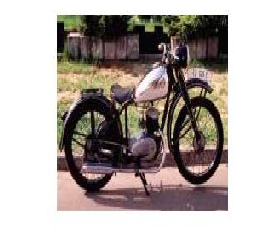

at distance 212.74784833910755:
(Class: Motorbikes)
at distance 223.59625844937807:
(Class: Motorbikes)
at distance 226.07896680727458:
(Class: Motorbikes)
at distance 237.1892601789693:
(Class: Motorbikes)
at distance 237.56327237484064:
(Class: Motorbikes)
2634 5.0
============= original: =============
(Class: platypus)


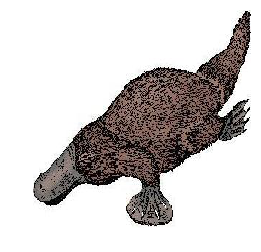

at distance 280.5265438606483:
(Class: platypus)
at distance 298.9116247364722:
(Class: brontosaurus)
at distance 301.36455716401366:
(Class: cougar_body)
at distance 303.7363535102799:
(Class: platypus)
at distance 305.50013061797034:
(Class: platypus)
3652 3.0
============= original: =============
(Class: crayfish)


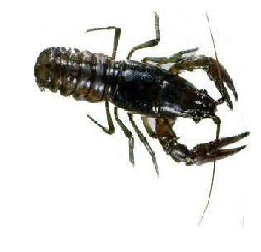

at distance 293.51247348641425:
(Class: lobster)
at distance 299.588770224617:
(Class: crayfish)
at distance 307.94926228332434:
(Class: crayfish)
at distance 310.33496341405964:
(Class: lobster)
at distance 316.82237117637203:
(Class: crayfish)
489 3.0
============= original: =============
(Class: Faces_easy)


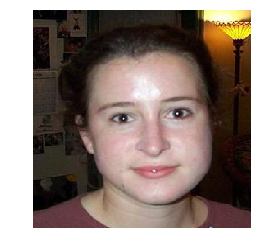

at distance 134.93864472875953:
(Class: Faces_easy)
at distance 138.11623812644112:
(Class: Faces_easy)
at distance 138.17998433030908:
(Class: Faces_easy)
at distance 138.83161164646657:
(Class: Faces_easy)
at distance 139.0259484570099:
(Class: Faces_easy)
7491 5.0
============= original: =============
(Class: hawksbill)


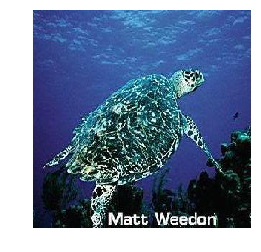

at distance 203.4538465956743:
(Class: hawksbill)
at distance 205.15897913348914:
(Class: hawksbill)
at distance 211.23321399453852:
(Class: hawksbill)
at distance 217.00333886325268:
(Class: hawksbill)
at distance 217.02366280547795:
(Class: hawksbill)
7576 5.0
============= original: =============
(Class: chair)


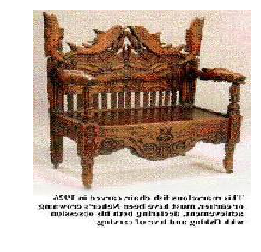

at distance 282.22711135930933:
(Class: chair)
at distance 288.41092419834524:
(Class: chair)
at distance 291.3394169511791:
(Class: elephant)
at distance 293.7386054969641:
(Class: buddha)
at distance 299.20035573014115:
(Class: octopus)
590 2.0
============= original: =============
(Class: Faces)


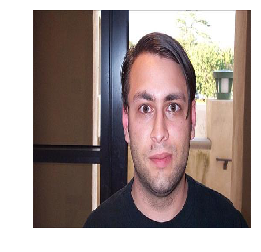

at distance 131.1926025881334:
(Class: Faces)
at distance 135.0043491583857:
(Class: Faces_easy)
at distance 137.78313678858828:
(Class: Faces)
at distance 141.46824326447248:
(Class: Faces_easy)
at distance 145.38450103032824:
(Class: Faces)
4355 3.0
============= original: =============
(Class: okapi)


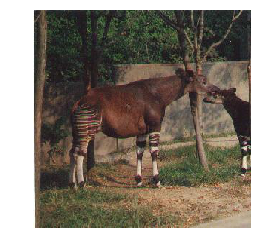

at distance 192.54664321038902:
(Class: okapi)
at distance 201.50546199273748:
(Class: okapi)
at distance 205.70564307614686:
(Class: elephant)
at distance 207.67871822104277:
(Class: brontosaurus)
at distance 208.4010218111029:
(Class: rhino)
3783 2.0
##########################################################################################
################################# caltech101_VGG16_fc2.p #################################
Query results
============= original: =============
(Class: ketch)


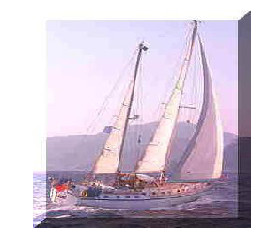

at distance 40.5852287823896:
(Class: schooner)
at distance 44.107575970410295:
(Class: ketch)
at distance 44.66700341317258:
(Class: ketch)
at distance 45.86543417712053:
(Class: schooner)
at distance 46.13917379519671:
(Class: ketch)
2181 3.0
============= original: =============
(Class: airplanes)


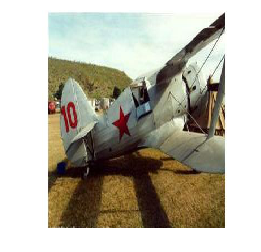

at distance 66.21807501183396:
(Class: airplanes)
at distance 66.68495897205479:
(Class: pyramid)
at distance 67.73733850551575:
(Class: airplanes)
at distance 68.25220715115618:
(Class: airplanes)
at distance 68.7801680607067:
(Class: pyramid)
1199 3.0
============= original: =============
(Class: rooster)


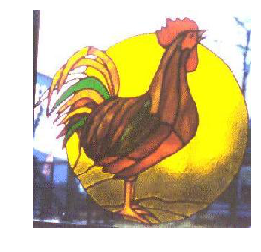

at distance 67.6547853239865:
(Class: rooster)
at distance 70.0185330716357:
(Class: rooster)
at distance 72.91911666158786:
(Class: lotus)
at distance 73.68023633988237:
(Class: lotus)
at distance 74.38522944497447:
(Class: lotus)
5655 2.0
============= original: =============
(Class: Faces)


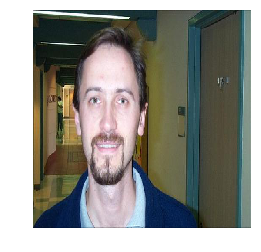

at distance 33.54069337961136:
(Class: Faces)
at distance 34.25261305143778:
(Class: Faces)
at distance 34.52990313221452:
(Class: Faces)
at distance 35.23270574323288:
(Class: Faces)
at distance 35.88349342684151:
(Class: Faces)
4060 5.0
============= original: =============
(Class: minaret)


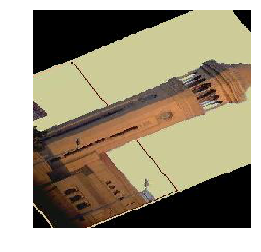

at distance 54.40090959358247:
(Class: minaret)
at distance 55.79751700587722:
(Class: minaret)
at distance 57.33013524308528:
(Class: minaret)
at distance 57.58587498723657:
(Class: minaret)
at distance 58.18571542147307:
(Class: minaret)
7014 5.0
============= original: =============
(Class: watch)


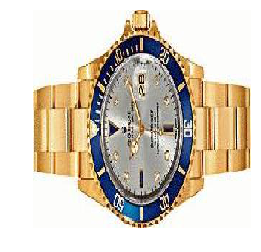

at distance 68.94676026541794:
(Class: watch)
at distance 69.17124727538526:
(Class: watch)
at distance 70.15649792283499:
(Class: watch)
at distance 70.98957971844602:
(Class: watch)
at distance 71.7668690475787:
(Class: watch)
1178 5.0
============= original: =============
(Class: pigeon)


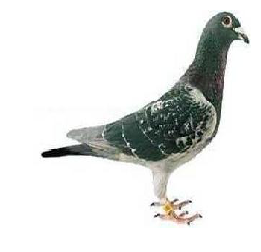

at distance 62.03727627159784:
(Class: pigeon)
at distance 62.56206509758967:
(Class: pigeon)
at distance 65.47081095137989:
(Class: pigeon)
at distance 72.35589186957034:
(Class: pigeon)
at distance 73.02309628674816:
(Class: pigeon)
8565 5.0
============= original: =============
(Class: butterfly)


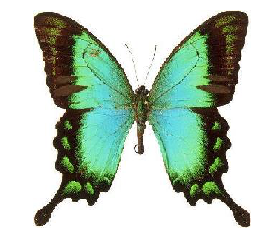

at distance 84.70444972260326:
(Class: butterfly)
at distance 85.3739690084028:
(Class: butterfly)
at distance 85.94520394653316:
(Class: butterfly)
at distance 86.27362110654155:
(Class: butterfly)
at distance 89.59434411522895:
(Class: butterfly)
8437 5.0
============= original: =============
(Class: airplanes)


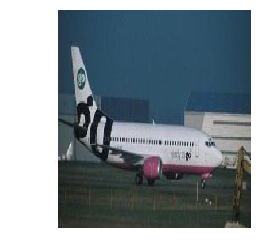

at distance 38.68713511212018:
(Class: airplanes)
at distance 44.73023827527484:
(Class: airplanes)
at distance 47.67684686304614:
(Class: airplanes)
at distance 48.06187354530871:
(Class: airplanes)
at distance 48.34854439839372:
(Class: airplanes)
1931 5.0
============= original: =============
(Class: lobster)


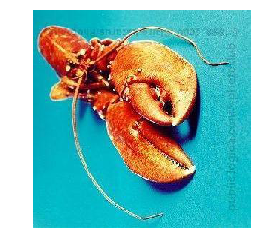

at distance 81.47149962883405:
(Class: octopus)
at distance 82.11712174883415:
(Class: stapler)
at distance 87.18899517765783:
(Class: octopus)
at distance 87.48625717649345:
(Class: crayfish)
at distance 87.58427059695524:
(Class: crayfish)
3849 0.0
============= original: =============
(Class: cougar_face)


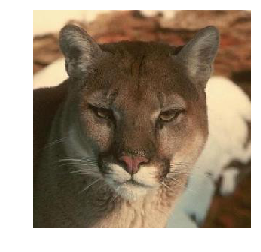

at distance 33.75897720072595:
(Class: cougar_face)
at distance 34.554917772853656:
(Class: cougar_face)
at distance 40.646422363888355:
(Class: cougar_face)
at distance 61.323304501395995:
(Class: cougar_face)
at distance 62.17176536484319:
(Class: cougar_face)
4575 5.0
============= original: =============
(Class: Faces)


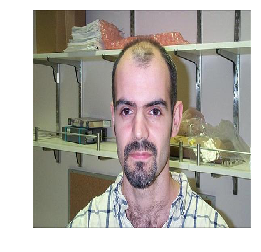

at distance 47.46804354279935:
(Class: Faces)
at distance 51.89566835035358:
(Class: Faces)
at distance 52.02386860961872:
(Class: Faces)
at distance 52.75990021890434:
(Class: Faces)
at distance 53.58868737475988:
(Class: Faces)
4251 5.0
============= original: =============
(Class: Leopards)


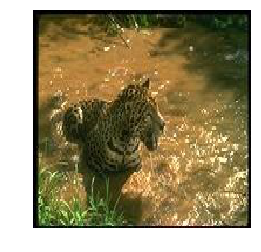

at distance 31.85536856110102:
(Class: Leopards)
at distance 62.36420117001021:
(Class: Leopards)
at distance 64.61508498628184:
(Class: Leopards)
at distance 65.18531361495307:
(Class: Leopards)
at distance 65.19263740680894:
(Class: Leopards)
5191 5.0
============= original: =============
(Class: stegosaurus)


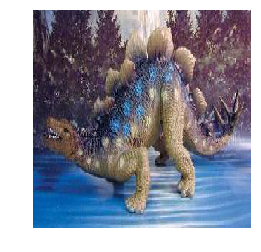

at distance 67.35346325796901:
(Class: crocodile)
at distance 67.37166421550529:
(Class: sea_horse)
at distance 71.40038222055459:
(Class: starfish)
at distance 71.43443045111408:
(Class: beaver)
at distance 71.44122030522337:
(Class: starfish)
6775 0.0
============= original: =============
(Class: electric_guitar)


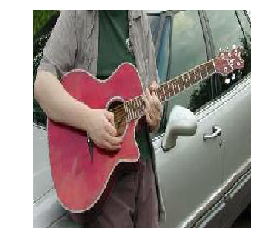

at distance 68.05019117341594:
(Class: electric_guitar)
at distance 68.73907727324165:
(Class: Faces)
at distance 69.730059378654:
(Class: Faces_easy)
at distance 69.88782180012952:
(Class: electric_guitar)
at distance 70.32094003344731:
(Class: Faces_easy)
3354 2.0
============= original: =============
(Class: helicopter)


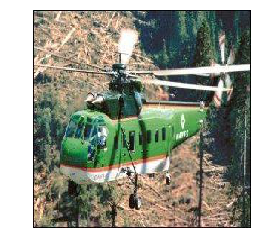

at distance 65.50083889092434:
(Class: helicopter)
at distance 68.22849265711112:
(Class: helicopter)
at distance 68.5172559244355:
(Class: airplanes)
at distance 68.870164151722:
(Class: airplanes)
at distance 69.01173957463129:
(Class: airplanes)
7952 2.0
============= original: =============
(Class: headphone)


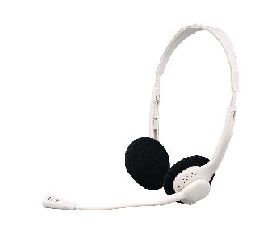

at distance 67.78795540916907:
(Class: headphone)
at distance 68.4338973632992:
(Class: headphone)
at distance 72.67826552816746:
(Class: headphone)
at distance 73.64369847505212:
(Class: yin_yang)
at distance 73.74680446431368:
(Class: yin_yang)
2204 3.0
============= original: =============
(Class: airplanes)


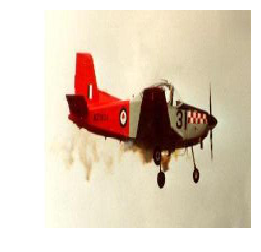

at distance 67.28174048102399:
(Class: airplanes)
at distance 68.12033802813643:
(Class: airplanes)
at distance 68.83639777913126:
(Class: airplanes)
at distance 69.98020087846211:
(Class: airplanes)
at distance 70.5021635776863:
(Class: airplanes)
1516 5.0
============= original: =============
(Class: lotus)


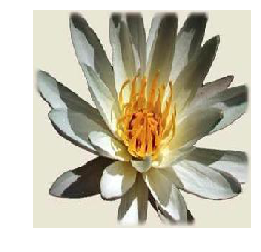

at distance 69.91050881686895:
(Class: lotus)
at distance 72.72059960966023:
(Class: lotus)
at distance 72.88522051341191:
(Class: lotus)
at distance 72.93025801983175:
(Class: water_lilly)
at distance 74.81009576138597:
(Class: lotus)
5401 4.0
============= original: =============
(Class: Faces_easy)


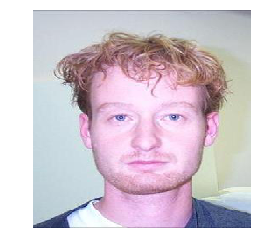

at distance 25.154403519765125:
(Class: Faces_easy)
at distance 32.63926120153333:
(Class: Faces_easy)
at distance 34.34440180765105:
(Class: Faces_easy)
at distance 35.895256397112455:
(Class: Faces_easy)
at distance 36.99954032673483:
(Class: Faces_easy)
7486 5.0
============= original: =============
(Class: gramophone)


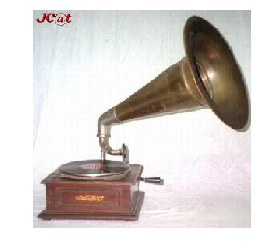

at distance 67.93633725118903:
(Class: gramophone)
at distance 69.65023935085091:
(Class: gramophone)
at distance 72.27884734577172:
(Class: gramophone)
at distance 73.5681425764512:
(Class: gramophone)
at distance 73.76145756806145:
(Class: euphonium)
8610 4.0
============= original: =============
(Class: nautilus)


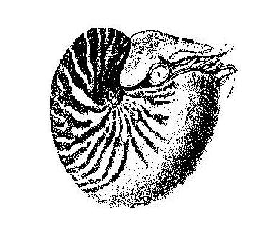

at distance 69.58590000405664:
(Class: nautilus)
at distance 81.12786944291136:
(Class: nautilus)
at distance 81.17996505117371:
(Class: bass)
at distance 82.40046936761743:
(Class: cougar_face)
at distance 84.43453414694669:
(Class: nautilus)
5629 3.0
============= original: =============
(Class: ewer)


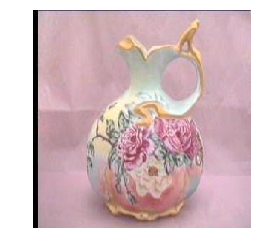

at distance 62.200885020566055:
(Class: ewer)
at distance 64.08884961896838:
(Class: ewer)
at distance 64.2458884425862:
(Class: ewer)
at distance 65.24178791288428:
(Class: ewer)
at distance 65.6038609478176:
(Class: ewer)
3149 5.0
============= original: =============
(Class: watch)


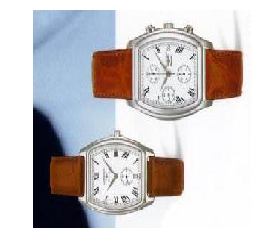

at distance 60.053476698224245:
(Class: watch)
at distance 65.11546790187685:
(Class: watch)
at distance 67.01159463617597:
(Class: watch)
at distance 67.0878095560894:
(Class: watch)
at distance 67.54694337726703:
(Class: revolver)
1134 4.0
============= original: =============
(Class: watch)


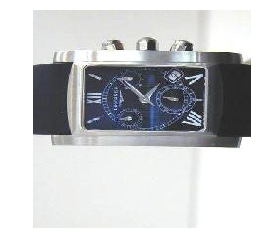

at distance 61.35477795321425:
(Class: watch)
at distance 67.25429904679102:
(Class: watch)
at distance 68.16615722755218:
(Class: watch)
at distance 68.31689120882024:
(Class: watch)
at distance 69.27296057726922:
(Class: watch)
1059 5.0
============= original: =============
(Class: bonsai)


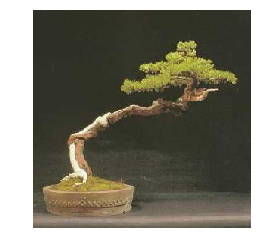

at distance 58.66399200071179:
(Class: bonsai)
at distance 60.329027748588636:
(Class: bonsai)
at distance 60.59873992955089:
(Class: bonsai)
at distance 60.69776061982368:
(Class: bonsai)
at distance 60.916669717922716:
(Class: bonsai)
3959 5.0
============= original: =============
(Class: accordion)


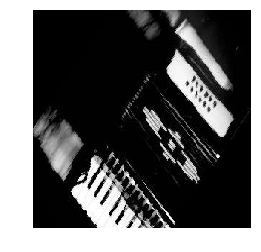

at distance 64.00064341906413:
(Class: accordion)
at distance 69.79741170490199:
(Class: accordion)
at distance 70.70235641231316:
(Class: accordion)
at distance 71.76231677764895:
(Class: accordion)
at distance 76.31726613288626:
(Class: grand_piano)
4607 4.0
============= original: =============
(Class: bass)


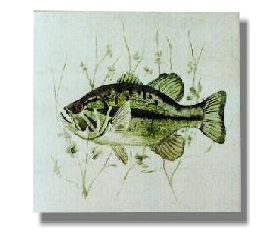

at distance 69.5147690449024:
(Class: wild_cat)
at distance 71.33203284094951:
(Class: stegosaurus)
at distance 71.92564720750359:
(Class: cougar_face)
at distance 72.18370824844614:
(Class: Leopards)
at distance 72.70066023403456:
(Class: bonsai)
7602 0.0
============= original: =============
(Class: Faces_easy)


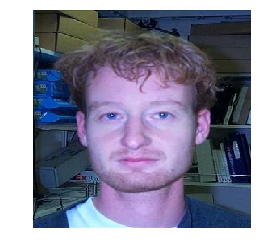

at distance 39.91683190559119:
(Class: Faces_easy)
at distance 40.75757102224792:
(Class: Faces_easy)
at distance 41.17326540221942:
(Class: Faces_easy)
at distance 41.654115536801136:
(Class: Faces_easy)
at distance 41.726697341890485:
(Class: Faces)
7358 4.0
============= original: =============
(Class: stop_sign)


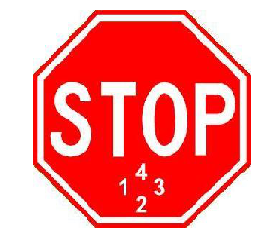

at distance 22.750566256248593:
(Class: stop_sign)
at distance 25.8052421715552:
(Class: stop_sign)
at distance 26.181454292326666:
(Class: stop_sign)
at distance 26.7778353231449:
(Class: stop_sign)
at distance 31.976947827748116:
(Class: stop_sign)
3624 5.0
============= original: =============
(Class: airplanes)


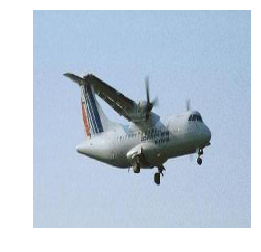

at distance 46.04407393570979:
(Class: airplanes)
at distance 47.000512533654806:
(Class: airplanes)
at distance 49.88692277283671:
(Class: airplanes)
at distance 49.94871469999649:
(Class: airplanes)
at distance 50.3209855795823:
(Class: airplanes)
1752 5.0
============= original: =============
(Class: minaret)


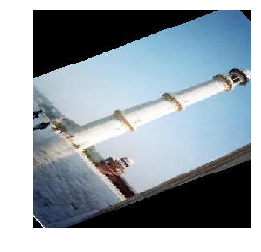

at distance 47.11255286758747:
(Class: minaret)
at distance 50.49008046186339:
(Class: minaret)
at distance 52.005338551137626:
(Class: minaret)
at distance 52.16619514373822:
(Class: minaret)
at distance 52.60176030897745:
(Class: minaret)
7013 5.0
============= original: =============
(Class: Faces)


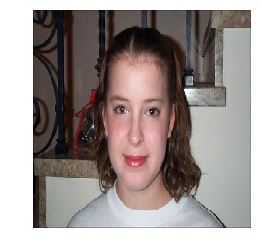

at distance 37.94824282385456:
(Class: Faces)
at distance 38.463137021616085:
(Class: Faces_easy)
at distance 40.01420280208071:
(Class: Faces)
at distance 40.3159272478659:
(Class: Faces)
at distance 41.390806440125125:
(Class: Faces_easy)
4417 3.0
============= original: =============
(Class: sunflower)


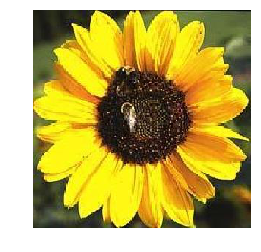

at distance 75.76933408724334:
(Class: sunflower)
at distance 76.93989342887404:
(Class: sunflower)
at distance 77.68451250403037:
(Class: sunflower)
at distance 78.97168752444465:
(Class: sunflower)
at distance 79.08864516471428:
(Class: sunflower)
4942 5.0
============= original: =============
(Class: lobster)


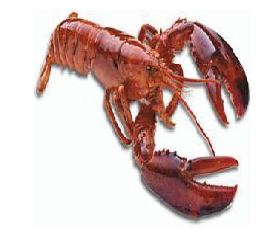

at distance 84.81757575352972:
(Class: crayfish)
at distance 87.4478120747319:
(Class: crab)
at distance 88.92713065171492:
(Class: lobster)
at distance 89.04356450660244:
(Class: lobster)
at distance 91.03679305678543:
(Class: lobster)
3858 3.0
============= original: =============
(Class: airplanes)


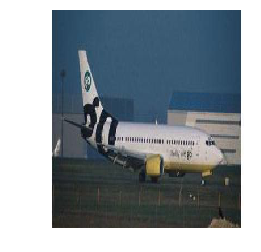

at distance 48.777883641533094:
(Class: airplanes)
at distance 49.79059676441481:
(Class: airplanes)
at distance 49.84062130088812:
(Class: airplanes)
at distance 50.10437724672862:
(Class: airplanes)
at distance 53.763002028648835:
(Class: airplanes)
1266 5.0
============= original: =============
(Class: hawksbill)


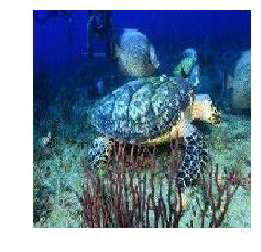

at distance 60.315413567727795:
(Class: hawksbill)
at distance 62.70601188607949:
(Class: hawksbill)
at distance 65.43243334404983:
(Class: octopus)
at distance 65.97206689740776:
(Class: crayfish)
at distance 66.63375529807027:
(Class: hawksbill)
7586 3.0
============= original: =============
(Class: beaver)


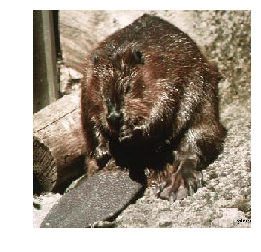

at distance 69.03582991627765:
(Class: beaver)
at distance 71.47300071177733:
(Class: beaver)
at distance 73.11796943797066:
(Class: beaver)
at distance 74.60011288322507:
(Class: beaver)
at distance 76.87245850268427:
(Class: beaver)
7719 5.0
============= original: =============
(Class: Faces_easy)


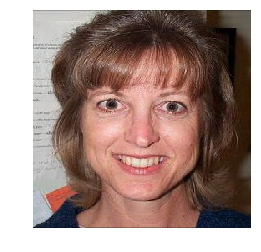

at distance 26.596407698673936:
(Class: Faces_easy)
at distance 26.789978331871257:
(Class: Faces_easy)
at distance 26.979409857213675:
(Class: Faces_easy)
at distance 28.850024087423115:
(Class: Faces_easy)
at distance 29.459364367574302:
(Class: Faces_easy)
7058 5.0
============= original: =============
(Class: Faces_easy)


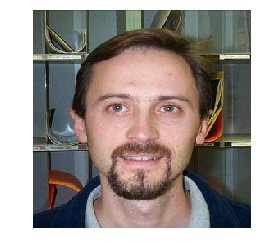

at distance 45.266045275025974:
(Class: Faces_easy)
at distance 45.630705985013094:
(Class: Faces_easy)
at distance 48.54204892416369:
(Class: Faces_easy)
at distance 49.53079557416196:
(Class: Faces_easy)
at distance 49.56429938651659:
(Class: Faces_easy)
7302 5.0
============= original: =============
(Class: panda)


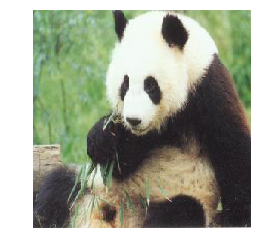

at distance 70.40850224976492:
(Class: panda)
at distance 72.04181689036044:
(Class: panda)
at distance 75.4296783151588:
(Class: panda)
at distance 75.69400633213884:
(Class: panda)
at distance 76.53098778421389:
(Class: panda)
3575 5.0
============= original: =============
(Class: schooner)


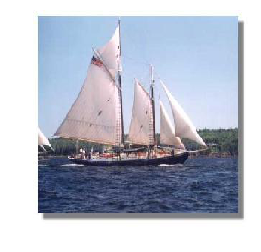

at distance 50.02504870633755:
(Class: ketch)
at distance 51.03014245876104:
(Class: ketch)
at distance 51.515714139493994:
(Class: schooner)
at distance 51.633302087581484:
(Class: schooner)
at distance 51.634399027120224:
(Class: schooner)
283 3.0
============= original: =============
(Class: Motorbikes)


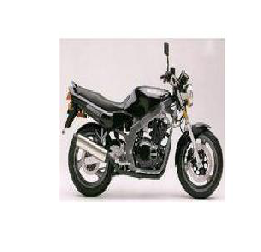

at distance 36.64571758288667:
(Class: Motorbikes)
at distance 37.53114896641117:
(Class: Motorbikes)
at distance 40.70046807680324:
(Class: Motorbikes)
at distance 40.70741461632:
(Class: Motorbikes)
at distance 42.29482561322363:
(Class: Motorbikes)
2641 5.0
============= original: =============
(Class: grand_piano)


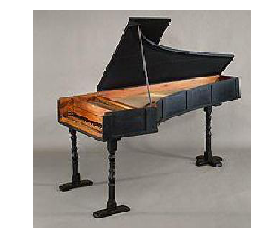

at distance 70.92266914798334:
(Class: grand_piano)
at distance 71.72538189147808:
(Class: grand_piano)
at distance 72.46486902232527:
(Class: grand_piano)
at distance 74.57720344196254:
(Class: grand_piano)
at distance 75.83890892469111:
(Class: grand_piano)
3741 5.0
============= original: =============
(Class: Motorbikes)


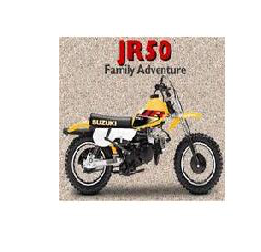

at distance 32.71241608468806:
(Class: Motorbikes)
at distance 37.72997515589051:
(Class: Motorbikes)
at distance 39.33339647613657:
(Class: Motorbikes)
at distance 42.169178196601514:
(Class: Motorbikes)
at distance 42.88531118046511:
(Class: Motorbikes)
2580 5.0
============= original: =============
(Class: flamingo)


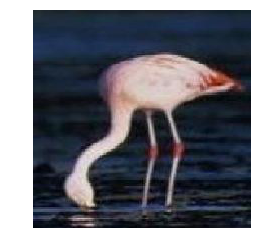

at distance 61.3924839094844:
(Class: flamingo)
at distance 68.35996098532888:
(Class: flamingo)
at distance 69.72414927655713:
(Class: ibis)
at distance 71.82662436092875:
(Class: ibis)
at distance 74.66815087425185:
(Class: ibis)
222 2.0
============= original: =============
(Class: stegosaurus)


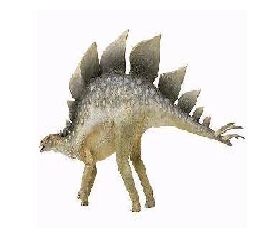

at distance 65.54802025928481:
(Class: stegosaurus)
at distance 68.31469544725405:
(Class: brontosaurus)
at distance 69.25317693476343:
(Class: sea_horse)
at distance 69.87231946553919:
(Class: bonsai)
at distance 69.91281065690896:
(Class: stegosaurus)
6798 2.0
============= original: =============
(Class: Motorbikes)


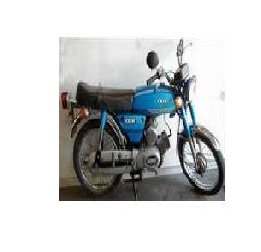

at distance 47.370444793833684:
(Class: Motorbikes)
at distance 48.00298250903776:
(Class: Motorbikes)
at distance 48.7991104580755:
(Class: Motorbikes)
at distance 50.274095885908636:
(Class: Motorbikes)
at distance 50.62353112874296:
(Class: Motorbikes)
2670 5.0
============= original: =============
(Class: airplanes)


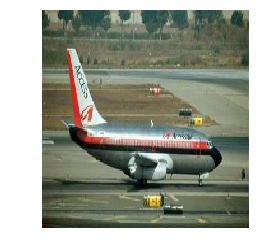

at distance 52.20350990733844:
(Class: airplanes)
at distance 53.541833048900024:
(Class: airplanes)
at distance 54.42062208024521:
(Class: airplanes)
at distance 54.919770529530155:
(Class: airplanes)
at distance 55.22371113689425:
(Class: airplanes)
1414 5.0
============= original: =============
(Class: cellphone)


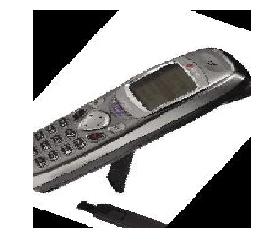

at distance 61.03619412008336:
(Class: cellphone)
at distance 63.53347743994953:
(Class: cellphone)
at distance 63.586878678087196:
(Class: cellphone)
at distance 64.60926427296702:
(Class: cellphone)
at distance 65.08498337620607:
(Class: cellphone)
8619 5.0
============= original: =============
(Class: Motorbikes)


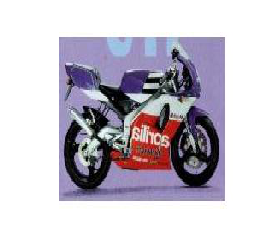

at distance 43.608966675451484:
(Class: Motorbikes)
at distance 44.5555759442286:
(Class: Motorbikes)
at distance 44.924883849771746:
(Class: Motorbikes)
at distance 46.62602304089015:
(Class: Motorbikes)
at distance 46.729592974910894:
(Class: Motorbikes)
2274 5.0
============= original: =============
(Class: bonsai)


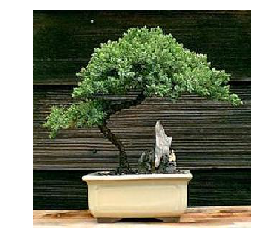

at distance 58.1703987204329:
(Class: bonsai)
at distance 58.51477601209652:
(Class: bonsai)
at distance 60.710641505944785:
(Class: bonsai)
at distance 61.160970753237116:
(Class: bonsai)
at distance 61.274501382871875:
(Class: bonsai)
3969 5.0
============= original: =============
(Class: Faces_easy)


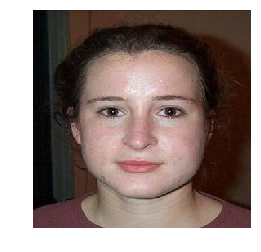

at distance 24.007153245464185:
(Class: Faces_easy)
at distance 28.539114750466666:
(Class: Faces_easy)
at distance 29.1592709963906:
(Class: Faces_easy)
at distance 29.710550069662247:
(Class: Faces_easy)
at distance 29.914163839129593:
(Class: Faces_easy)
7288 5.0
============= original: =============
(Class: lobster)


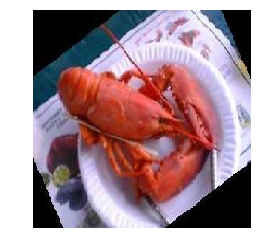

at distance 81.68128503455145:
(Class: lobster)
at distance 88.83233438389775:
(Class: lobster)
at distance 90.11018536736329:
(Class: lobster)
at distance 90.1742292137448:
(Class: lobster)
at distance 90.19006633500048:
(Class: lobster)
3856 5.0
============= original: =============
(Class: ketch)


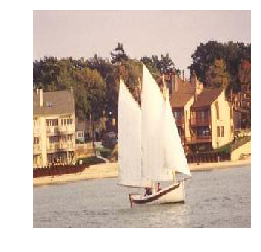

at distance 56.68566822000072:
(Class: ketch)
at distance 57.77665504488509:
(Class: schooner)
at distance 58.26174532568302:
(Class: ketch)
at distance 59.90903004683019:
(Class: ketch)
at distance 60.03273008623222:
(Class: ketch)
2172 4.0
============= original: =============
(Class: revolver)


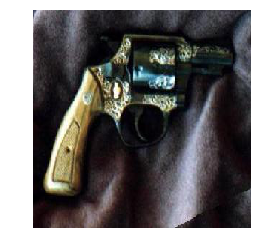

at distance 60.43461914194711:
(Class: revolver)
at distance 77.29159237411176:
(Class: revolver)
at distance 77.70233269422413:
(Class: revolver)
at distance 78.85495446949551:
(Class: scissors)
at distance 79.3625880638205:
(Class: revolver)
6952 4.0
============= original: =============
(Class: elephant)


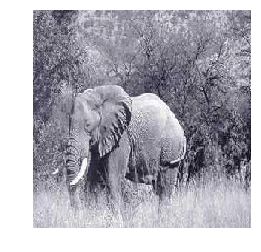

at distance 70.76005758203982:
(Class: rhino)
at distance 70.78342464197927:
(Class: elephant)
at distance 71.29724150397088:
(Class: elephant)
at distance 74.51002344559302:
(Class: elephant)
at distance 75.12945628080358:
(Class: elephant)
63 4.0
============= original: =============
(Class: platypus)


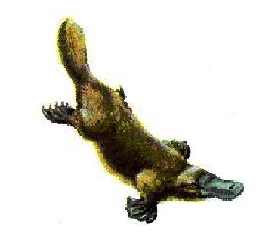

at distance 76.8305084885586:
(Class: stegosaurus)
at distance 76.87342626221842:
(Class: bonsai)
at distance 79.97348069664234:
(Class: airplanes)
at distance 80.2740581004755:
(Class: brontosaurus)
at distance 80.50815529559642:
(Class: platypus)
3656 1.0
============= original: =============
(Class: ant)


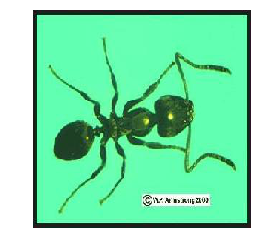

at distance 66.97839437048452:
(Class: ant)
at distance 68.55241935993183:
(Class: scorpion)
at distance 69.2057365052108:
(Class: ant)
at distance 70.07458558776943:
(Class: ant)
at distance 71.1851709742087:
(Class: ant)
2028 4.0
============= original: =============
(Class: metronome)


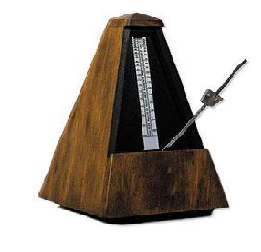

at distance 54.87868721473104:
(Class: metronome)
at distance 57.463370955839686:
(Class: metronome)
at distance 58.70634632556442:
(Class: metronome)
at distance 60.69569326231772:
(Class: metronome)
at distance 62.000654076092424:
(Class: metronome)
5361 5.0
============= original: =============
(Class: Faces)


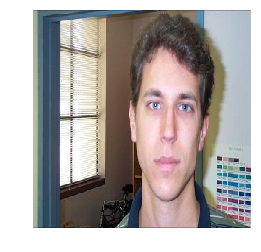

at distance 40.77198159437294:
(Class: Faces_easy)
at distance 42.30023926701371:
(Class: Faces)
at distance 43.67895398260994:
(Class: Faces)
at distance 44.198370343097494:
(Class: Faces)
at distance 44.79073606733689:
(Class: Faces)
4394 4.0
============= original: =============
(Class: hedgehog)


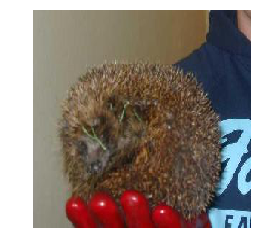

at distance 65.96052558929708:
(Class: Faces)
at distance 66.73067449179588:
(Class: hedgehog)
at distance 66.74746570700844:
(Class: Faces_easy)
at distance 66.81906604042996:
(Class: Faces)
at distance 67.4762721124271:
(Class: Faces_easy)
5746 1.0
============= original: =============
(Class: wrench)


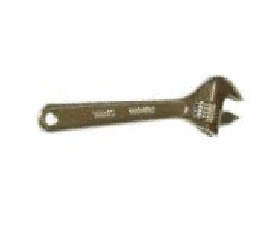

at distance 42.07951067508891:
(Class: wrench)
at distance 48.63615884330718:
(Class: wrench)
at distance 50.92612770280574:
(Class: wrench)
at distance 52.39492285469613:
(Class: wrench)
at distance 59.312186707122535:
(Class: wrench)
4770 5.0
============= original: =============
(Class: ibis)


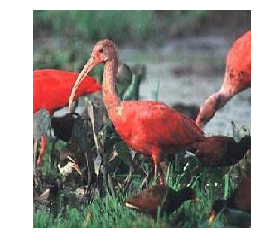

at distance 66.61080834955158:
(Class: ibis)
at distance 68.2503651624672:
(Class: ibis)
at distance 76.13899595472579:
(Class: ibis)
at distance 78.46709229671315:
(Class: ibis)
at distance 81.1552797576145:
(Class: ibis)
4792 5.0
============= original: =============
(Class: airplanes)


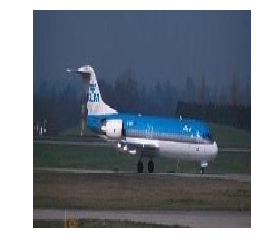

at distance 55.142096432978626:
(Class: airplanes)
at distance 58.3645038553134:
(Class: airplanes)
at distance 58.725255307980206:
(Class: airplanes)
at distance 59.09498504582274:
(Class: airplanes)
at distance 59.35902919142507:
(Class: airplanes)
1714 5.0
============= original: =============
(Class: cannon)


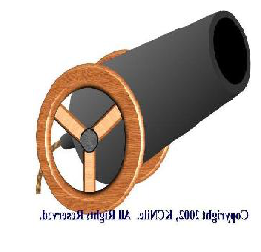

at distance 79.11540963230713:
(Class: scissors)
at distance 80.05854896603044:
(Class: wrench)
at distance 80.12887237595706:
(Class: headphone)
at distance 81.28661357703521:
(Class: wrench)
at distance 82.99062097705819:
(Class: scissors)
8362 0.0
============= original: =============
(Class: buddha)


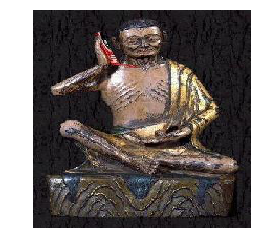

at distance 72.79814699917343:
(Class: buddha)
at distance 74.406738572129:
(Class: buddha)
at distance 74.69563917700184:
(Class: buddha)
at distance 74.91624756011603:
(Class: buddha)
at distance 75.59876403335385:
(Class: buddha)
8314 5.0
============= original: =============
(Class: ketch)


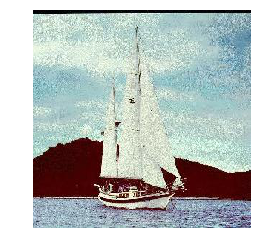

at distance 52.08756057056248:
(Class: ketch)
at distance 52.543709861089226:
(Class: ketch)
at distance 53.328494879354395:
(Class: schooner)
at distance 54.56916502836842:
(Class: ketch)
at distance 55.32019072134622:
(Class: ketch)
2086 4.0
============= original: =============
(Class: laptop)


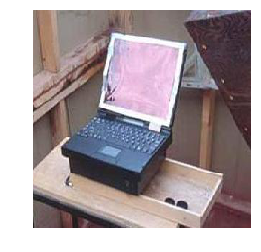

at distance 51.1484995637224:
(Class: laptop)
at distance 57.147490902435784:
(Class: laptop)
at distance 58.00972535605385:
(Class: laptop)
at distance 58.209474085654676:
(Class: laptop)
at distance 58.88899813494128:
(Class: laptop)
6230 5.0
============= original: =============
(Class: cup)


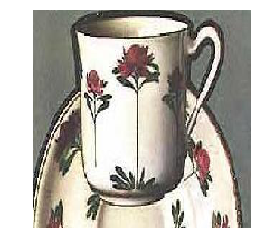

at distance 81.90123618351572:
(Class: cup)
at distance 82.753771627148:
(Class: ewer)
at distance 83.2615894111237:
(Class: cup)
at distance 83.59941537644818:
(Class: ewer)
at distance 84.54925015004912:
(Class: ewer)
7699 2.0
============= original: =============
(Class: Faces_easy)


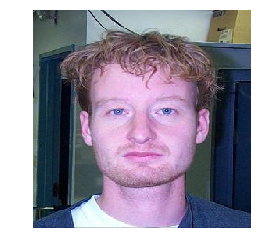

at distance 30.6157349932821:
(Class: Faces_easy)
at distance 34.146484595218794:
(Class: Faces_easy)
at distance 34.648910726713595:
(Class: Faces_easy)
at distance 37.132764420343364:
(Class: Faces_easy)
at distance 37.3150864177624:
(Class: Faces_easy)
7432 5.0
============= original: =============
(Class: chandelier)


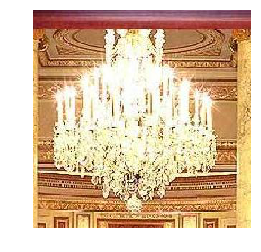

at distance 65.6773396746923:
(Class: buddha)
at distance 66.70671666852674:
(Class: bonsai)
at distance 67.04311017582592:
(Class: Faces)
at distance 67.9361267177055:
(Class: chandelier)
at distance 68.08203726329512:
(Class: menorah)
654 1.0
============= original: =============
(Class: cup)


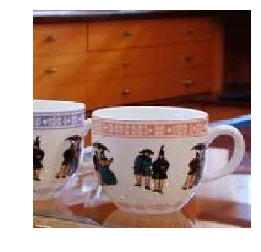

at distance 65.91677174659876:
(Class: cup)
at distance 70.05158083768934:
(Class: cup)
at distance 70.27509398642:
(Class: cup)
at distance 71.23847581917664:
(Class: ewer)
at distance 73.0654574783799:
(Class: cup)
7663 4.0
============= original: =============
(Class: ferry)


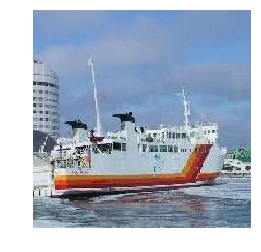

at distance 51.302338491940986:
(Class: ferry)
at distance 51.64567928268371:
(Class: ferry)
at distance 54.085662810279615:
(Class: ferry)
at distance 54.96791882605403:
(Class: ferry)
at distance 55.45079435178789:
(Class: ferry)
444 5.0
============= original: =============
(Class: menorah)


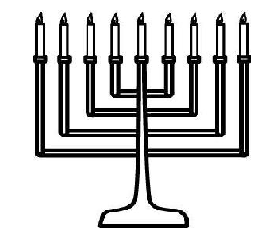

at distance 112.3700352459269:
(Class: menorah)
at distance 115.90497660192777:
(Class: menorah)
at distance 117.2878478488995:
(Class: menorah)
at distance 117.69685485063016:
(Class: menorah)
at distance 118.22907899880116:
(Class: menorah)
6432 5.0
============= original: =============
(Class: brain)


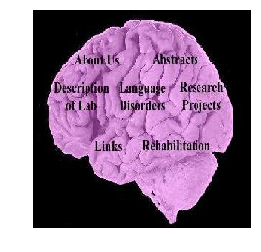

at distance 73.89791290197084:
(Class: brain)
at distance 77.07513948873373:
(Class: brain)
at distance 79.69921557639162:
(Class: brain)
at distance 79.77310884860835:
(Class: brain)
at distance 79.90297069431558:
(Class: brain)
6116 5.0
============= original: =============
(Class: menorah)


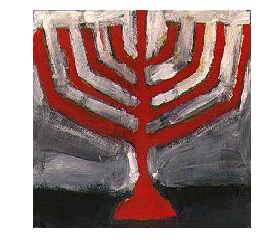

at distance 80.259464749661:
(Class: electric_guitar)
at distance 83.46215097807908:
(Class: menorah)
at distance 84.57753804210621:
(Class: yin_yang)
at distance 85.46552862877762:
(Class: Faces_easy)
at distance 85.53019968141736:
(Class: Faces_easy)
6390 1.0
============= original: =============
(Class: bonsai)


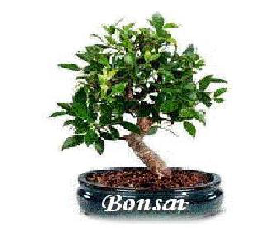

at distance 61.97668580479741:
(Class: bonsai)
at distance 64.05936847165218:
(Class: bonsai)
at distance 65.04913770391116:
(Class: bonsai)
at distance 65.60598397503617:
(Class: bonsai)
at distance 66.66105315145325:
(Class: bonsai)
3934 5.0
============= original: =============
(Class: hawksbill)


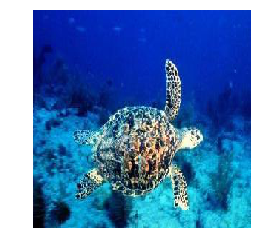

at distance 52.97121661737041:
(Class: hawksbill)
at distance 64.06126735120161:
(Class: hawksbill)
at distance 66.23481486501746:
(Class: hawksbill)
at distance 69.15869271521865:
(Class: hawksbill)
at distance 69.27877942984145:
(Class: hawksbill)
7548 5.0
============= original: =============
(Class: kangaroo)


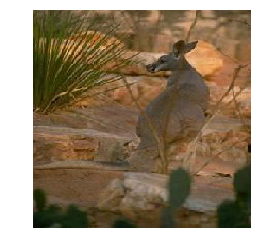

at distance 62.95102192346121:
(Class: kangaroo)
at distance 64.85123952910794:
(Class: kangaroo)
at distance 68.93225069264649:
(Class: joshua_tree)
at distance 69.47584991459885:
(Class: Leopards)
at distance 69.5958036017905:
(Class: crocodile)
5128 2.0
============= original: =============
(Class: airplanes)


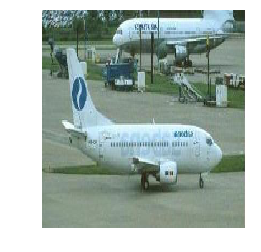

at distance 49.54313624950174:
(Class: airplanes)
at distance 50.51946225476615:
(Class: airplanes)
at distance 52.63454186753969:
(Class: airplanes)
at distance 52.689007359641806:
(Class: airplanes)
at distance 53.11932792471882:
(Class: airplanes)
1646 5.0
============= original: =============
(Class: Faces)


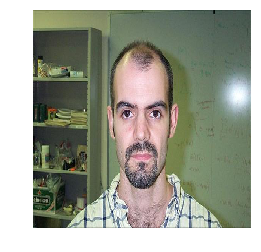

at distance 49.051852597144745:
(Class: Faces)
at distance 50.104896477729845:
(Class: Faces)
at distance 50.32000833692141:
(Class: Faces)
at distance 50.392334896742156:
(Class: Faces)
at distance 50.535728068953205:
(Class: Faces)
4124 5.0
============= original: =============
(Class: dolphin)


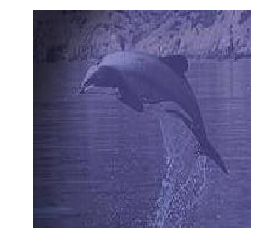

at distance 63.00141297412781:
(Class: pyramid)
at distance 63.99804457303659:
(Class: pyramid)
at distance 64.91461206197688:
(Class: joshua_tree)
at distance 65.33360218330377:
(Class: pyramid)
at distance 66.21426036440359:
(Class: ferry)
5956 0.0
============= original: =============
(Class: laptop)


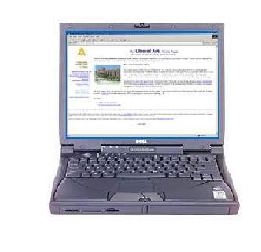

at distance 50.47546564841953:
(Class: laptop)
at distance 51.80912008491348:
(Class: laptop)
at distance 53.91621811651984:
(Class: laptop)
at distance 54.35238478840579:
(Class: laptop)
at distance 54.82655187531306:
(Class: laptop)
6218 5.0
============= original: =============
(Class: Faces)


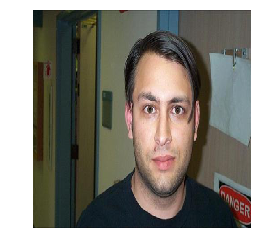

at distance 32.68605930544409:
(Class: Faces)
at distance 33.23638313606797:
(Class: Faces)
at distance 35.53485208384781:
(Class: Faces_easy)
at distance 36.02660893029014:
(Class: Faces)
at distance 36.234533413534145:
(Class: Faces_easy)
4365 3.0
============= original: =============
(Class: mandolin)


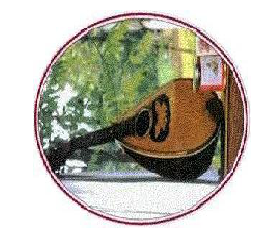

at distance 85.26768705128364:
(Class: gramophone)
at distance 85.85905640651055:
(Class: stapler)
at distance 86.42253553692122:
(Class: garfield)
at distance 86.42739487023374:
(Class: bass)
at distance 87.2377173971426:
(Class: pizza)
8428 0.0
============= original: =============
(Class: airplanes)


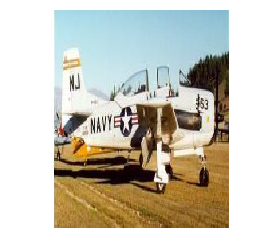

at distance 58.85183565031882:
(Class: airplanes)
at distance 60.48842643818951:
(Class: airplanes)
at distance 60.64812321515132:
(Class: airplanes)
at distance 60.66984470905529:
(Class: airplanes)
at distance 60.88549187963876:
(Class: airplanes)
1820 5.0
============= original: =============
(Class: brain)


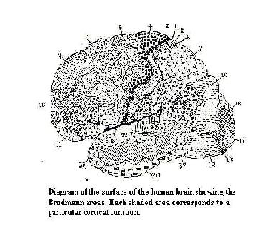

at distance 63.09325080908011:
(Class: bass)
at distance 66.8497607518629:
(Class: brain)
at distance 66.94051588106723:
(Class: cougar_face)
at distance 67.06246815357692:
(Class: snoopy)
at distance 68.36458378747496:
(Class: umbrella)
6103 1.0
============= original: =============
(Class: crayfish)


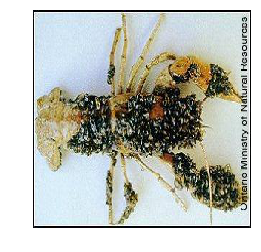

at distance 72.21059850826981:
(Class: joshua_tree)
at distance 74.77725984003277:
(Class: chandelier)
at distance 74.7827648814228:
(Class: joshua_tree)
at distance 76.31150266701441:
(Class: bonsai)
at distance 77.00913815552995:
(Class: joshua_tree)
517 0.0
============= original: =============
(Class: Faces)


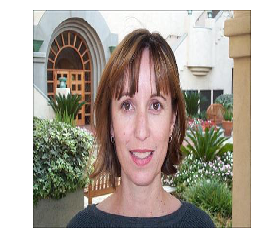

at distance 40.41259528138696:
(Class: Faces_easy)
at distance 40.42048381735057:
(Class: Faces)
at distance 44.33599754295643:
(Class: Faces)
at distance 48.03863510293286:
(Class: Faces)
at distance 48.3424978149573:
(Class: Faces)
4321 4.0
============= original: =============
(Class: chair)


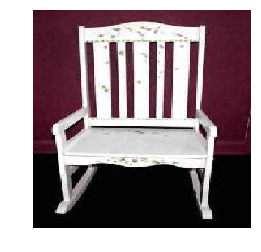

at distance 87.48603260224424:
(Class: chair)
at distance 94.51638488430817:
(Class: chair)
at distance 96.1227509090264:
(Class: chair)
at distance 96.8194829224608:
(Class: windsor_chair)
at distance 97.49831270955248:
(Class: windsor_chair)
627 3.0
============= original: =============
(Class: Motorbikes)


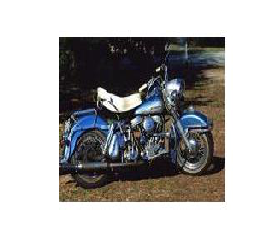

at distance 48.554810605397435:
(Class: Motorbikes)
at distance 49.30690305045979:
(Class: Motorbikes)
at distance 49.61298954405202:
(Class: Motorbikes)
at distance 49.80959546228124:
(Class: Motorbikes)
at distance 49.94410117048071:
(Class: Motorbikes)
2381 5.0
============= original: =============
(Class: cougar_body)


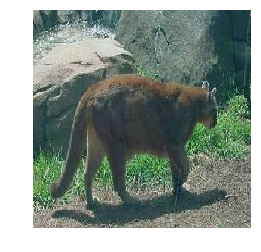

at distance 63.43193701530658:
(Class: cougar_body)
at distance 64.53496012237979:
(Class: cougar_body)
at distance 65.94437935855801:
(Class: cougar_body)
at distance 73.21163319329636:
(Class: cougar_body)
at distance 74.40769782690214:
(Class: kangaroo)
8157 4.0
============= original: =============
(Class: rhino)


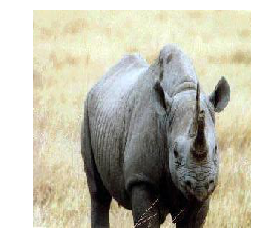

at distance 78.68138310667096:
(Class: rhino)
at distance 80.78671458315836:
(Class: rhino)
at distance 81.86248704477504:
(Class: rhino)
at distance 86.05765901698379:
(Class: rhino)
at distance 88.32420526201179:
(Class: rhino)
4664 5.0
============= original: =============
(Class: platypus)


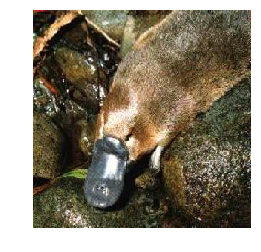

at distance 89.8665626285072:
(Class: platypus)
at distance 91.62604615522046:
(Class: platypus)
at distance 97.7798707315737:
(Class: platypus)
at distance 98.90481861671353:
(Class: platypus)
at distance 99.60479204699944:
(Class: platypus)
3651 5.0
============= original: =============
(Class: Motorbikes)


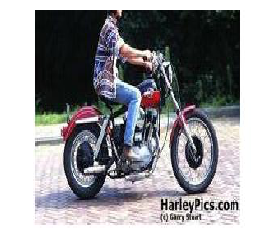

at distance 51.90577218127618:
(Class: Motorbikes)
at distance 54.74580018310788:
(Class: Motorbikes)
at distance 55.39092442428801:
(Class: Motorbikes)
at distance 55.447697486355665:
(Class: Motorbikes)
at distance 56.29729082397883:
(Class: Motorbikes)
3025 5.0
============= original: =============
(Class: dollar_bill)


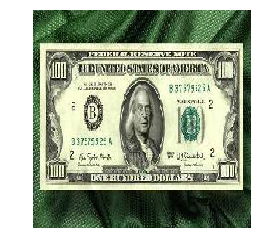

at distance 55.797504754899634:
(Class: dollar_bill)
at distance 59.597276722084736:
(Class: dollar_bill)
at distance 62.35980445339806:
(Class: dollar_bill)
at distance 63.17013944554883:
(Class: dollar_bill)
at distance 64.94553126550595:
(Class: dollar_bill)
145 5.0
============= original: =============
(Class: dolphin)


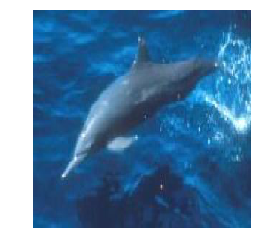

at distance 60.92946239559405:
(Class: dolphin)
at distance 63.63339083070686:
(Class: dolphin)
at distance 64.45687578376403:
(Class: dolphin)
at distance 64.50858765491019:
(Class: dolphin)
at distance 64.66975945407269:
(Class: dolphin)
5943 5.0
============= original: =============
(Class: trilobite)


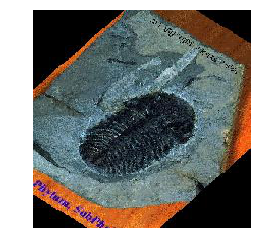

at distance 28.136740342708645:
(Class: trilobite)
at distance 68.56413189447844:
(Class: trilobite)
at distance 71.89026379769643:
(Class: trilobite)
at distance 74.61459103300771:
(Class: trilobite)
at distance 75.08740156274699:
(Class: trilobite)
8124 5.0
============= original: =============
(Class: airplanes)


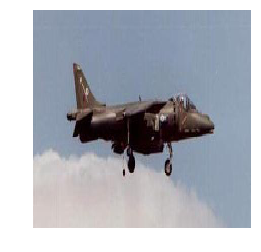

at distance 56.14569705669886:
(Class: airplanes)
at distance 57.26680318382332:
(Class: helicopter)
at distance 65.28970589561895:
(Class: helicopter)
at distance 66.71119253077153:
(Class: airplanes)
at distance 67.56019783269299:
(Class: airplanes)
1810 3.0
============= original: =============
(Class: car_side)


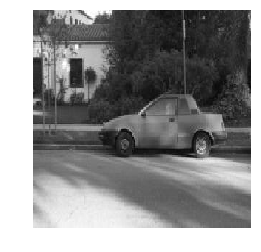

at distance 37.59734634764404:
(Class: car_side)
at distance 38.91626925572318:
(Class: car_side)
at distance 39.52589170632454:
(Class: car_side)
at distance 39.8094700899223:
(Class: car_side)
at distance 40.045669455084735:
(Class: car_side)
770 5.0
============= original: =============
(Class: headphone)


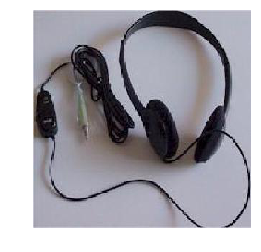

at distance 69.55716904809684:
(Class: headphone)
at distance 73.04760363857487:
(Class: headphone)
at distance 76.97793350720019:
(Class: headphone)
at distance 79.88038614611877:
(Class: headphone)
at distance 82.08557889613857:
(Class: headphone)
2233 5.0
============= original: =============
(Class: Faces)


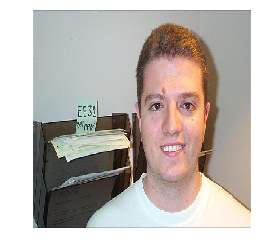

at distance 40.806166248701274:
(Class: Faces)
at distance 42.01717832698276:
(Class: Faces_easy)
at distance 42.31771776524925:
(Class: Faces)
at distance 43.17424900659363:
(Class: Faces_easy)
at distance 43.565378677119085:
(Class: Faces_easy)
4480 2.0
============= original: =============
(Class: ketch)


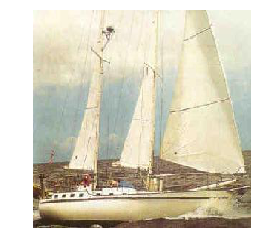

at distance 50.47723966399279:
(Class: ketch)
at distance 51.99847173178399:
(Class: ketch)
at distance 53.2226012013763:
(Class: ketch)
at distance 54.11794173750217:
(Class: ketch)
at distance 55.02902474434116:
(Class: ketch)
2093 5.0
============= original: =============
(Class: tick)


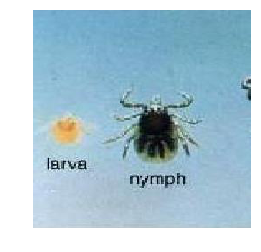

at distance 67.02864558793863:
(Class: strawberry)
at distance 69.56664823008096:
(Class: helicopter)
at distance 70.2510108451159:
(Class: snoopy)
at distance 72.1096511309035:
(Class: helicopter)
at distance 72.62159817237222:
(Class: snoopy)
4879 0.0
============= original: =============
(Class: Faces)


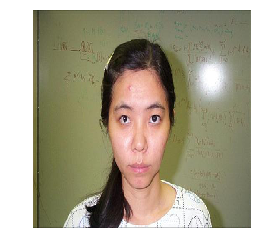

at distance 34.64032527677223:
(Class: Faces)
at distance 37.94497055638252:
(Class: Faces)
at distance 40.3090999008021:
(Class: Faces)
at distance 41.708645391751965:
(Class: Faces)
at distance 42.062734888537605:
(Class: Faces)
4335 5.0
============= original: =============
(Class: llama)


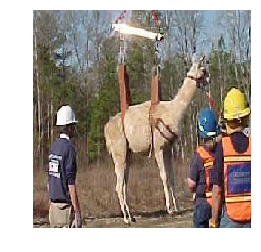

at distance 71.55532751933961:
(Class: airplanes)
at distance 72.3679118209717:
(Class: bonsai)
at distance 72.80598409684147:
(Class: joshua_tree)
at distance 73.15559010698937:
(Class: Faces_easy)
at distance 73.17103377871692:
(Class: wheelchair)
932 0.0
============= original: =============
(Class: airplanes)


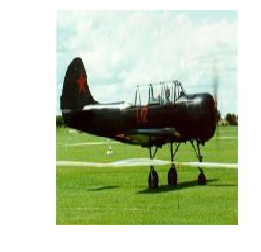

at distance 68.5183142086528:
(Class: airplanes)
at distance 70.22419870597882:
(Class: airplanes)
at distance 70.55203787049365:
(Class: airplanes)
at distance 70.69797655142713:
(Class: airplanes)
at distance 71.81716692967804:
(Class: airplanes)
1865 5.0
============= original: =============
(Class: Faces)


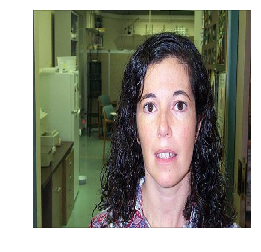

at distance 26.86744681576009:
(Class: Faces)
at distance 28.464493238028748:
(Class: Faces)
at distance 35.447958481772325:
(Class: Faces)
at distance 35.5268185802082:
(Class: Faces)
at distance 35.629278071601256:
(Class: Faces)
4148 5.0
============= original: =============
(Class: chandelier)


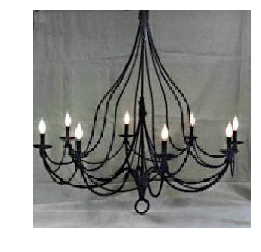

at distance 74.65073905126445:
(Class: chandelier)
at distance 75.2369518756072:
(Class: menorah)
at distance 75.33090715188504:
(Class: menorah)
at distance 76.02761077590814:
(Class: chandelier)
at distance 76.59551555994383:
(Class: menorah)
713 2.0
============= original: =============
(Class: soccer_ball)


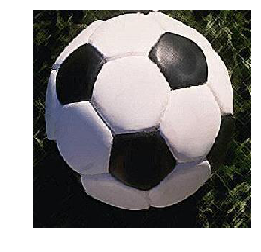

at distance 74.76504193133498:
(Class: soccer_ball)
at distance 79.4169859537417:
(Class: soccer_ball)
at distance 86.09462676302574:
(Class: soccer_ball)
at distance 93.91942765853653:
(Class: soccer_ball)
at distance 94.02668987372026:
(Class: soccer_ball)
5940 5.0
============= original: =============
(Class: Motorbikes)


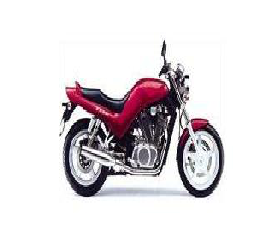

at distance 36.1964058095614:
(Class: Motorbikes)
at distance 38.64750886013925:
(Class: Motorbikes)
at distance 41.97931004397875:
(Class: Motorbikes)
at distance 43.02658566375665:
(Class: Motorbikes)
at distance 43.11393449092699:
(Class: Motorbikes)
2905 5.0
============= original: =============
(Class: camera)


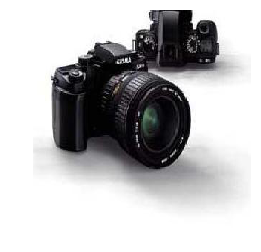

at distance 67.72891065170856:
(Class: camera)
at distance 70.15943037529387:
(Class: camera)
at distance 71.31120263679983:
(Class: camera)
at distance 73.16483909726021:
(Class: camera)
at distance 73.67576101595058:
(Class: camera)
6306 5.0
============= original: =============
(Class: watch)


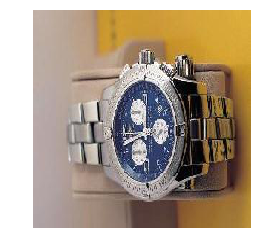

at distance 58.489160645753834:
(Class: watch)
at distance 60.28143182318072:
(Class: watch)
at distance 64.70569663632956:
(Class: watch)
at distance 65.07280833544854:
(Class: watch)
at distance 65.67809627210397:
(Class: watch)
1030 5.0
============= original: =============
(Class: camera)


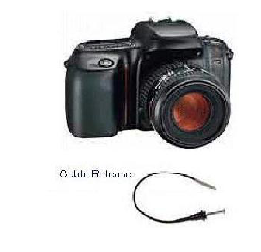

at distance 73.61745840918425:
(Class: camera)
at distance 74.25194359510512:
(Class: camera)
at distance 74.89158556744212:
(Class: camera)
at distance 75.40201042010672:
(Class: camera)
at distance 75.80904521427948:
(Class: camera)
6294 5.0
============= original: =============
(Class: stegosaurus)


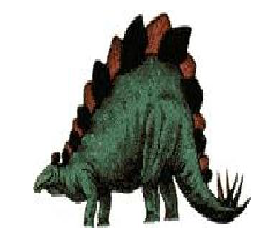

at distance 76.52095505911696:
(Class: stegosaurus)
at distance 76.87483329042928:
(Class: brontosaurus)
at distance 78.45750695558853:
(Class: cougar_face)
at distance 78.581966399455:
(Class: brontosaurus)
at distance 78.66773692008626:
(Class: chandelier)
6758 1.0
============= original: =============
(Class: chandelier)


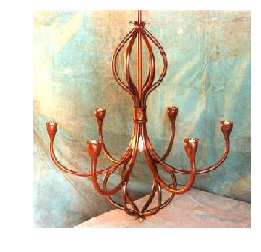

at distance 78.51617641025943:
(Class: chandelier)
at distance 82.32909344439014:
(Class: garfield)
at distance 83.10725516980065:
(Class: menorah)
at distance 83.35083858398316:
(Class: menorah)
at distance 83.74979845923386:
(Class: chandelier)
723 2.0
============= original: =============
(Class: hedgehog)


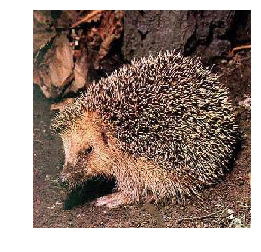

at distance 68.83284252734467:
(Class: hedgehog)
at distance 74.54954186188668:
(Class: hedgehog)
at distance 75.49913621192017:
(Class: hedgehog)
at distance 76.04204784328326:
(Class: hedgehog)
at distance 78.7451686380565:
(Class: hedgehog)
5741 5.0
============= original: =============
(Class: pagoda)


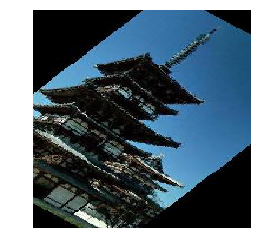

at distance 51.554112015222685:
(Class: pagoda)
at distance 54.78825332324542:
(Class: pagoda)
at distance 57.470826851642755:
(Class: pagoda)
at distance 57.520643442541726:
(Class: pagoda)
at distance 58.53166886296318:
(Class: pagoda)
4506 5.0
============= original: =============
(Class: platypus)


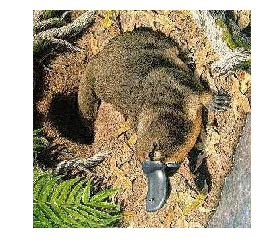

at distance 70.55960876349835:
(Class: beaver)
at distance 70.64033725422034:
(Class: kangaroo)
at distance 71.09750565908135:
(Class: joshua_tree)
at distance 71.1225614940242:
(Class: sea_horse)
at distance 71.77899566371971:
(Class: sea_horse)
3663 0.0
============= original: =============
(Class: sea_horse)


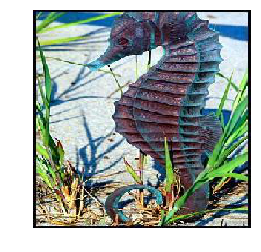

at distance 78.33939597832595:
(Class: Leopards)
at distance 78.50359948025852:
(Class: sea_horse)
at distance 78.72199329057617:
(Class: Leopards)
at distance 79.69597558762227:
(Class: crocodile)
at distance 79.71679894227596:
(Class: Leopards)
3121 1.0
============= original: =============
(Class: Faces_easy)


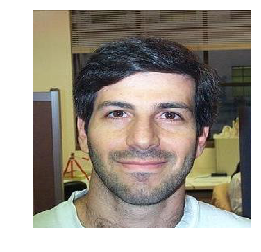

at distance 34.4318556097394:
(Class: Faces_easy)
at distance 37.19099373353507:
(Class: Faces_easy)
at distance 37.60446302693612:
(Class: Faces_easy)
at distance 37.90263154566236:
(Class: Faces_easy)
at distance 37.92835448969176:
(Class: Faces_easy)
7098 5.0
============= original: =============
(Class: hedgehog)


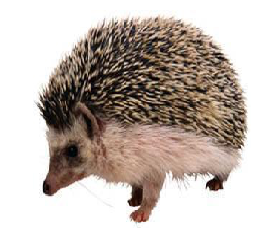

at distance 68.72497850822249:
(Class: hedgehog)
at distance 75.67098426545718:
(Class: hedgehog)
at distance 79.36239136954087:
(Class: hedgehog)
at distance 80.43460728868085:
(Class: hedgehog)
at distance 83.13691586399474:
(Class: hedgehog)
5773 5.0
============= original: =============
(Class: Faces_easy)


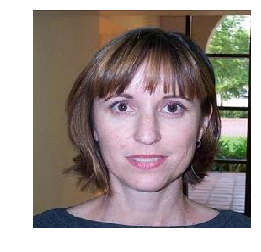

at distance 33.09450386006892:
(Class: Faces_easy)
at distance 33.19616085987912:
(Class: Faces_easy)
at distance 33.73730660054759:
(Class: Faces_easy)
at distance 34.23809051406841:
(Class: Faces_easy)
at distance 35.631553886234734:
(Class: Faces_easy)
7141 5.0
============= original: =============
(Class: kangaroo)


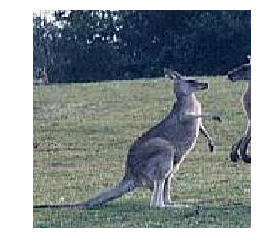

at distance 74.60816907277632:
(Class: kangaroo)
at distance 76.11767379349656:
(Class: kangaroo)
at distance 78.05055135113643:
(Class: kangaroo)
at distance 79.00651854640668:
(Class: emu)
at distance 81.07418430921415:
(Class: llama)
5126 3.0
============= original: =============
(Class: dragonfly)


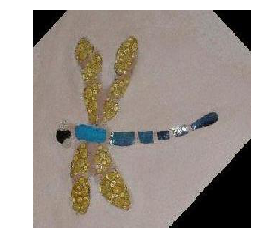

at distance 63.95215509104126:
(Class: scissors)
at distance 64.55778294826295:
(Class: buddha)
at distance 64.8605086435203:
(Class: electric_guitar)
at distance 65.99337033344224:
(Class: cellphone)
at distance 66.11311242793184:
(Class: minaret)
3277 0.0
============= original: =============
(Class: sea_horse)


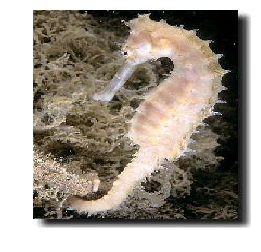

at distance 73.45552363541184:
(Class: sea_horse)
at distance 83.8259631906216:
(Class: sea_horse)
at distance 83.96341996699557:
(Class: octopus)
at distance 85.67702170989273:
(Class: sea_horse)
at distance 89.16410824807171:
(Class: hawksbill)
3111 3.0
============= original: =============
(Class: umbrella)


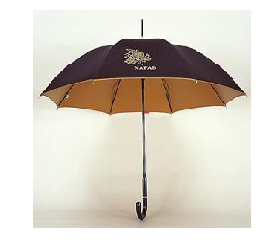

at distance 72.6238353734155:
(Class: umbrella)
at distance 75.86597495785955:
(Class: umbrella)
at distance 78.71589552368155:
(Class: umbrella)
at distance 79.15577706536993:
(Class: umbrella)
at distance 79.75202836047632:
(Class: umbrella)
5562 5.0
============= original: =============
(Class: pyramid)


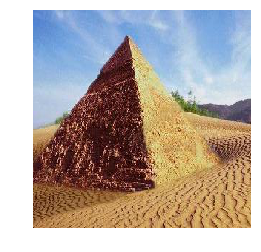

at distance 63.27493605760064:
(Class: pyramid)
at distance 64.52274531885712:
(Class: pyramid)
at distance 68.60520166011408:
(Class: pyramid)
at distance 69.79994442271537:
(Class: pyramid)
at distance 69.99993143723833:
(Class: pyramid)
53 5.0
============= original: =============
(Class: emu)


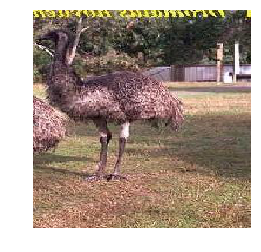

at distance 60.51621956142818:
(Class: emu)
at distance 67.74882704978633:
(Class: emu)
at distance 69.30931313680946:
(Class: emu)
at distance 69.48271750068561:
(Class: emu)
at distance 70.28560872526073:
(Class: emu)
6143 5.0
============= original: =============
(Class: ant)


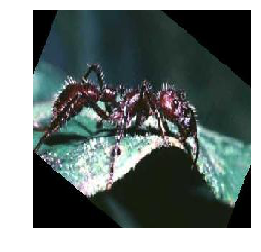

at distance 70.96566303812236:
(Class: mayfly)
at distance 71.3416310278649:
(Class: octopus)
at distance 71.6448598167497:
(Class: ant)
at distance 71.86920523539892:
(Class: ant)
at distance 72.70072618544742:
(Class: ant)
2013 3.0
============= original: =============
(Class: beaver)


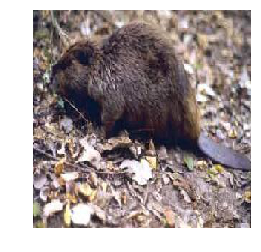

at distance 64.72216346090167:
(Class: beaver)
at distance 69.7742168550666:
(Class: beaver)
at distance 78.42243513986443:
(Class: beaver)
at distance 78.46014915044786:
(Class: beaver)
at distance 80.08863115575498:
(Class: beaver)
7718 5.0
============= original: =============
(Class: Faces)


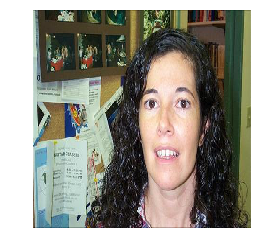

at distance 37.55697911239622:
(Class: Faces_easy)
at distance 38.98951165426292:
(Class: Faces)
at distance 40.132033009976475:
(Class: Faces)
at distance 40.42569547224081:
(Class: Faces)
at distance 40.75013391729923:
(Class: Faces)
4385 4.0
============= original: =============
(Class: barrel)


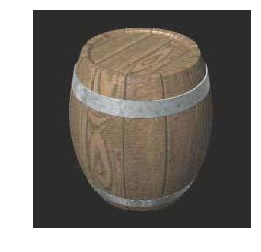

at distance 55.418982045023334:
(Class: barrel)
at distance 63.10715686284078:
(Class: barrel)
at distance 63.93687289997217:
(Class: barrel)
at distance 65.46442067771811:
(Class: barrel)
at distance 65.82305486385721:
(Class: barrel)
6478 5.0
============= original: =============
(Class: ibis)


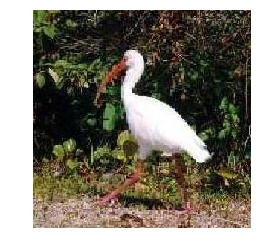

at distance 56.93168396669403:
(Class: ibis)
at distance 60.75468874074261:
(Class: ibis)
at distance 62.35195517601349:
(Class: ibis)
at distance 64.32007887655703:
(Class: ibis)
at distance 65.41272119531946:
(Class: ibis)
4849 5.0
============= original: =============
(Class: cougar_body)


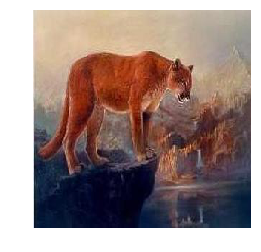

at distance 60.37227320594973:
(Class: cougar_body)
at distance 64.53496012237979:
(Class: cougar_body)
at distance 68.10452878410341:
(Class: cougar_body)
at distance 69.17764892978977:
(Class: cougar_body)
at distance 72.05141358867613:
(Class: cougar_body)
8168 5.0
============= original: =============
(Class: Faces)


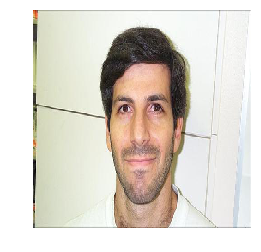

at distance 36.55701573283342:
(Class: Faces_easy)
at distance 37.48080724127653:
(Class: Faces)
at distance 38.41985425194677:
(Class: Faces_easy)
at distance 38.65636229938431:
(Class: Faces_easy)
at distance 40.27082207756493:
(Class: Faces)
4281 2.0
============= original: =============
(Class: metronome)


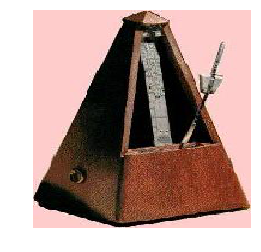

at distance 32.314679424908235:
(Class: metronome)
at distance 63.61763608430398:
(Class: metronome)
at distance 64.77404742240161:
(Class: metronome)
at distance 65.38764056035623:
(Class: metronome)
at distance 66.36558551915854:
(Class: metronome)
5369 5.0
============= original: =============
(Class: Faces_easy)


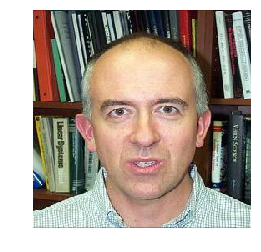

at distance 42.84967693155479:
(Class: Faces_easy)
at distance 49.4578872945433:
(Class: Faces_easy)
at distance 49.61034516970318:
(Class: Faces_easy)
at distance 49.95988822021399:
(Class: Faces_easy)
at distance 50.790681538041476:
(Class: Faces_easy)
7387 5.0
============= original: =============
(Class: airplanes)


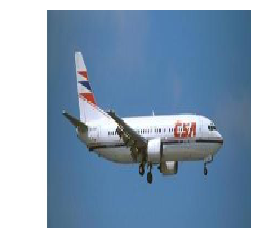

at distance 37.63489730976983:
(Class: airplanes)
at distance 38.66780156915207:
(Class: airplanes)
at distance 38.94088008379895:
(Class: airplanes)
at distance 40.18973772225496:
(Class: airplanes)
at distance 41.15881676793685:
(Class: airplanes)
1237 5.0
============= original: =============
(Class: Motorbikes)


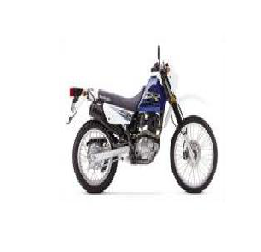

at distance 31.20421287160035:
(Class: Motorbikes)
at distance 35.25108014215:
(Class: Motorbikes)
at distance 38.442519998003505:
(Class: Motorbikes)
at distance 38.78634872929533:
(Class: Motorbikes)
at distance 38.891901653211534:
(Class: Motorbikes)
2435 5.0
============= original: =============
(Class: euphonium)


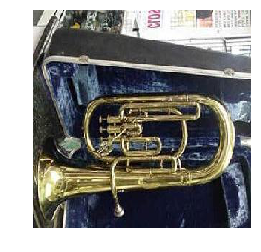

at distance 74.23937936246473:
(Class: euphonium)
at distance 79.19806440233728:
(Class: euphonium)
at distance 79.78540308939895:
(Class: euphonium)
at distance 80.93985177917484:
(Class: euphonium)
at distance 82.1128780133386:
(Class: euphonium)
7812 5.0
============= original: =============
(Class: elephant)


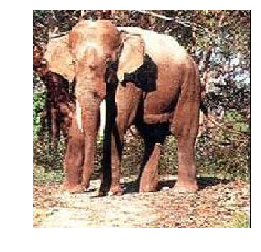

at distance 59.725284362490726:
(Class: elephant)
at distance 64.06938992575012:
(Class: elephant)
at distance 65.79170346695543:
(Class: rhino)
at distance 66.41472031779531:
(Class: elephant)
at distance 67.77920181232717:
(Class: bonsai)
120 3.0
============= original: =============
(Class: dollar_bill)


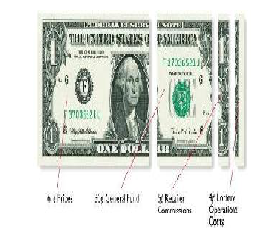

at distance 66.22679815853643:
(Class: dollar_bill)
at distance 66.6497321740058:
(Class: dollar_bill)
at distance 68.02867752041763:
(Class: dollar_bill)
at distance 68.33281562366273:
(Class: dollar_bill)
at distance 68.55260425360677:
(Class: dollar_bill)
138 5.0
============= original: =============
(Class: watch)


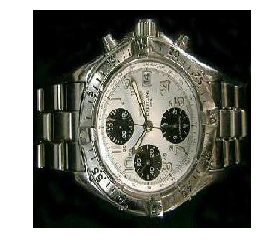

at distance 65.35649419572364:
(Class: watch)
at distance 69.34218240570773:
(Class: watch)
at distance 70.4343944500201:
(Class: watch)
at distance 71.20458080488137:
(Class: watch)
at distance 72.30773784182031:
(Class: watch)
1027 5.0
============= original: =============
(Class: euphonium)


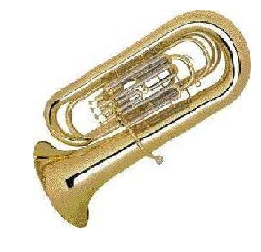

at distance 69.10022645842928:
(Class: euphonium)
at distance 69.99056498325638:
(Class: euphonium)
at distance 71.22815715354474:
(Class: euphonium)
at distance 73.22784729405397:
(Class: euphonium)
at distance 76.86727718856352:
(Class: euphonium)
7813 5.0
============= original: =============
(Class: panda)


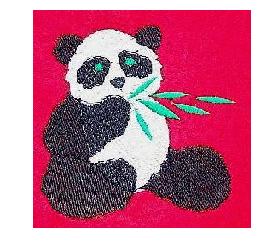

at distance 72.02492411834733:
(Class: butterfly)
at distance 74.18308276982216:
(Class: strawberry)
at distance 75.36328510508683:
(Class: panda)
at distance 80.66180003724541:
(Class: yin_yang)
at distance 80.90292293288965:
(Class: butterfly)
3579 1.0
============= original: =============
(Class: beaver)


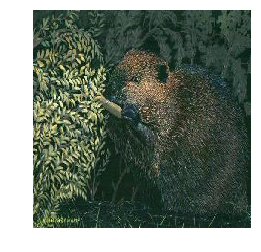

at distance 61.31828876750479:
(Class: hawksbill)
at distance 62.555504015627584:
(Class: hedgehog)
at distance 63.049055829660716:
(Class: hedgehog)
at distance 63.667695166338596:
(Class: Leopards)
at distance 63.91592203070992:
(Class: sea_horse)
7725 0.0
============= original: =============
(Class: joshua_tree)


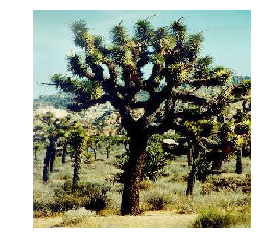

at distance 36.707616620041115:
(Class: joshua_tree)
at distance 38.14417814683476:
(Class: joshua_tree)
at distance 40.111083102382075:
(Class: joshua_tree)
at distance 41.6657866801681:
(Class: joshua_tree)
at distance 42.80371497010525:
(Class: joshua_tree)
5848 5.0
============= original: =============
(Class: scorpion)


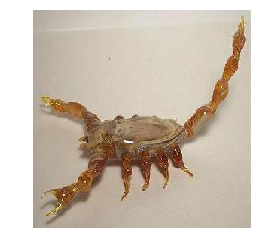

at distance 70.11079598259633:
(Class: crab)
at distance 70.65856681420102:
(Class: octopus)
at distance 71.40122463213791:
(Class: buddha)
at distance 71.54921238337226:
(Class: Faces_easy)
at distance 72.145255530201:
(Class: bonsai)
6834 0.0
============= original: =============
(Class: okapi)


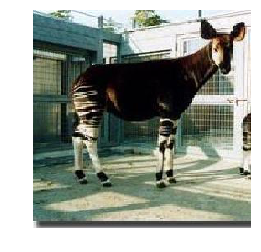

at distance 76.70555877981145:
(Class: okapi)
at distance 78.09735178373606:
(Class: okapi)
at distance 82.90520281302145:
(Class: okapi)
at distance 83.28007997478537:
(Class: okapi)
at distance 83.92796740320975:
(Class: okapi)
3788 5.0
============= original: =============
(Class: Motorbikes)


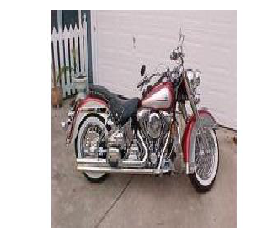

at distance 47.433496539324615:
(Class: Motorbikes)
at distance 48.51185785099704:
(Class: Motorbikes)
at distance 48.92500224295411:
(Class: Motorbikes)
at distance 49.243346718765764:
(Class: Motorbikes)
at distance 49.79062236476822:
(Class: Motorbikes)
2981 5.0
============= original: =============
(Class: buddha)


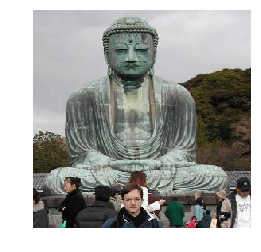

at distance 49.437254500701876:
(Class: buddha)
at distance 49.93292763843054:
(Class: buddha)
at distance 52.509979944153024:
(Class: buddha)
at distance 59.39814676133909:
(Class: buddha)
at distance 61.513066392866975:
(Class: buddha)
8336 5.0
============= original: =============
(Class: airplanes)


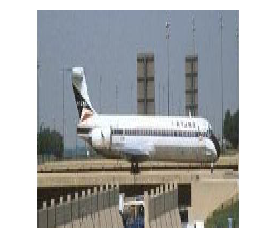

at distance 49.15474500764789:
(Class: airplanes)
at distance 49.87840593488363:
(Class: airplanes)
at distance 50.17263745591677:
(Class: airplanes)
at distance 50.37218120039016:
(Class: airplanes)
at distance 50.58883073529938:
(Class: airplanes)
1884 5.0
============= original: =============
(Class: airplanes)


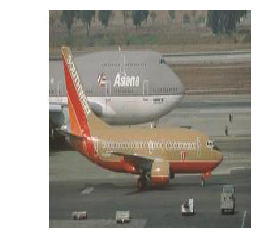

at distance 51.47157354794471:
(Class: airplanes)
at distance 53.18362825686336:
(Class: airplanes)
at distance 53.223092986968815:
(Class: airplanes)
at distance 53.78672173728956:
(Class: airplanes)
at distance 54.18379111214897:
(Class: airplanes)
1626 5.0
============= original: =============
(Class: emu)


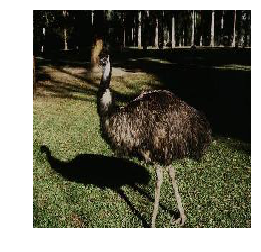

at distance 67.26896884569992:
(Class: emu)
at distance 68.16122426606023:
(Class: emu)
at distance 68.24847534692628:
(Class: ibis)
at distance 68.47766760209326:
(Class: emu)
at distance 69.07581351868217:
(Class: emu)
6147 4.0
============= original: =============
(Class: Motorbikes)


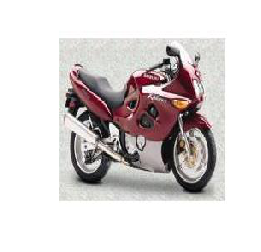

at distance 40.82197602868491:
(Class: Motorbikes)
at distance 41.354383476166866:
(Class: Motorbikes)
at distance 42.78947324501775:
(Class: Motorbikes)
at distance 42.91933139310806:
(Class: Motorbikes)
at distance 44.06401394517517:
(Class: Motorbikes)
2560 5.0
============= original: =============
(Class: joshua_tree)


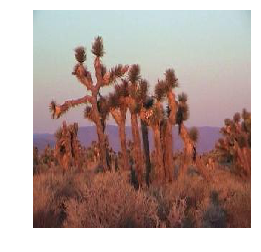

at distance 45.49247860882454:
(Class: joshua_tree)
at distance 45.75316443316793:
(Class: joshua_tree)
at distance 46.56888824990985:
(Class: joshua_tree)
at distance 47.50104991087952:
(Class: joshua_tree)
at distance 48.68326225572085:
(Class: joshua_tree)
5849 5.0
============= original: =============
(Class: Leopards)


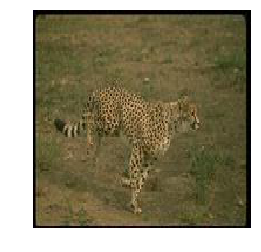

at distance 21.321682368325593:
(Class: Leopards)
at distance 31.184323682924674:
(Class: Leopards)
at distance 34.42994250876334:
(Class: Leopards)
at distance 39.11544788898303:
(Class: Leopards)
at distance 39.185961281605536:
(Class: Leopards)
5249 5.0
============= original: =============
(Class: cellphone)


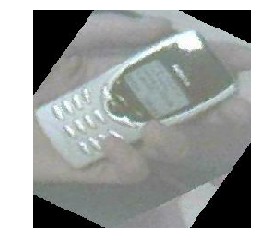

at distance 63.461575286323374:
(Class: accordion)
at distance 64.42049865681484:
(Class: pagoda)
at distance 65.87189278142887:
(Class: cellphone)
at distance 65.88775961333043:
(Class: ant)
at distance 66.59848654385273:
(Class: cellphone)
8667 2.0
============= original: =============
(Class: stapler)


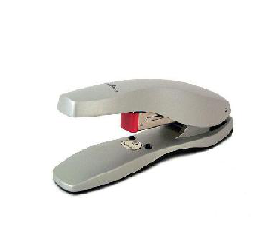

at distance 66.97078586031958:
(Class: stapler)
at distance 69.4093420361598:
(Class: stapler)
at distance 72.68471015037917:
(Class: stapler)
at distance 73.77226569156933:
(Class: bass)
at distance 76.26422269601642:
(Class: umbrella)
2072 3.0
============= original: =============
(Class: Faces_easy)


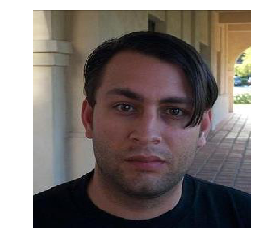

at distance 30.76554776281286:
(Class: Faces_easy)
at distance 32.29527823364727:
(Class: Faces)
at distance 37.46011613186607:
(Class: Faces)
at distance 37.94015620609914:
(Class: Faces_easy)
at distance 37.99435883587793:
(Class: Faces_easy)
7065 3.0
============= original: =============
(Class: brontosaurus)


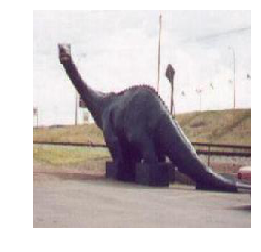

at distance 79.33097622027674:
(Class: airplanes)
at distance 81.03056182021383:
(Class: brontosaurus)
at distance 82.84514981639359:
(Class: brontosaurus)
at distance 83.58688562767371:
(Class: airplanes)
at distance 86.36844184115785:
(Class: brontosaurus)
8201 3.0
============= original: =============
(Class: Leopards)


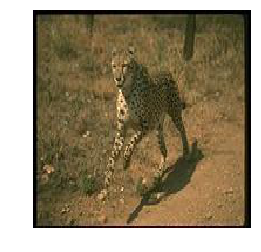

at distance 21.406641455785028:
(Class: Leopards)
at distance 44.05262502966479:
(Class: Leopards)
at distance 44.80484277523441:
(Class: Leopards)
at distance 46.07949277164325:
(Class: Leopards)
at distance 46.56840466443737:
(Class: Leopards)
5275 5.0
============= original: =============
(Class: crayfish)


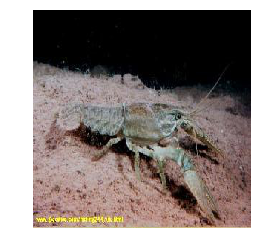

at distance 14.458308158196964:
(Class: crayfish)
at distance 69.55601178090257:
(Class: scorpion)
at distance 71.93175870379018:
(Class: crayfish)
at distance 72.84156800706711:
(Class: crab)
at distance 74.46190289615375:
(Class: scorpion)
500 2.0
============= original: =============
(Class: starfish)


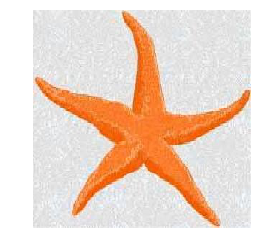

at distance 70.98630296116319:
(Class: starfish)
at distance 75.71801273326817:
(Class: starfish)
at distance 78.19168206088247:
(Class: starfish)
at distance 79.55506346514157:
(Class: starfish)
at distance 80.44850511533483:
(Class: starfish)
8024 5.0
============= original: =============
(Class: airplanes)


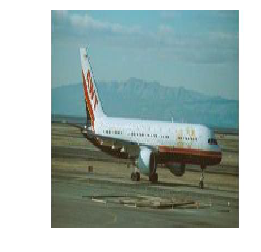

at distance 50.40883003811203:
(Class: airplanes)
at distance 50.59466227802176:
(Class: airplanes)
at distance 51.49434606233308:
(Class: airplanes)
at distance 52.01767875548613:
(Class: airplanes)
at distance 52.136862296446814:
(Class: airplanes)
1452 5.0
============= original: =============
(Class: tick)


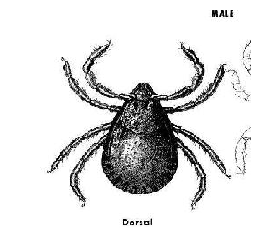

at distance 74.48284587237761:
(Class: tick)
at distance 84.38125506971352:
(Class: tick)
at distance 85.67326703036498:
(Class: tick)
at distance 85.94444069811519:
(Class: tick)
at distance 88.382353361814:
(Class: tick)
4904 5.0
============= original: =============
(Class: Motorbikes)


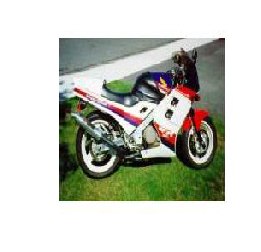

at distance 50.61736504871669:
(Class: Motorbikes)
at distance 51.63385497108941:
(Class: Motorbikes)
at distance 51.77803494043967:
(Class: Motorbikes)
at distance 53.278137710331386:
(Class: Motorbikes)
at distance 53.368884202016474:
(Class: Motorbikes)
2317 5.0
============= original: =============
(Class: scorpion)


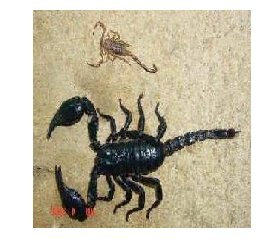

at distance 71.94309916451924:
(Class: scorpion)
at distance 87.82000164575717:
(Class: scorpion)
at distance 88.32274818550576:
(Class: scorpion)
at distance 90.24563630329502:
(Class: scorpion)
at distance 90.78324351806485:
(Class: scorpion)
6898 5.0
============= original: =============
(Class: ant)


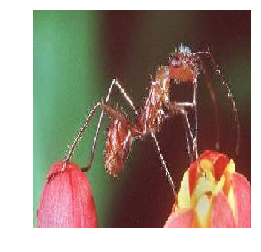

at distance 81.13166659954447:
(Class: ant)
at distance 81.22528143101303:
(Class: octopus)
at distance 83.11181636608057:
(Class: tick)
at distance 84.10362830612038:
(Class: mayfly)
at distance 84.9766602655376:
(Class: ant)
2001 2.0
============= original: =============
(Class: car_side)


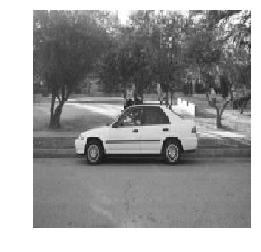

at distance 33.43108608504411:
(Class: car_side)
at distance 34.30982689514922:
(Class: car_side)
at distance 36.03483714491557:
(Class: car_side)
at distance 36.407843555251446:
(Class: car_side)
at distance 38.44988407547036:
(Class: car_side)
859 5.0
============= original: =============
(Class: pigeon)


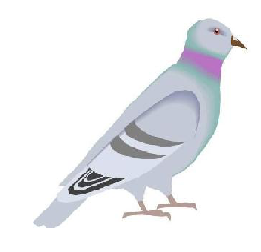

at distance 74.43010804641267:
(Class: pigeon)
at distance 75.05529623978859:
(Class: pigeon)
at distance 75.3270587146447:
(Class: pigeon)
at distance 75.48445020039169:
(Class: pigeon)
at distance 77.86211479596608:
(Class: brontosaurus)
8560 4.0
============= original: =============
(Class: pyramid)


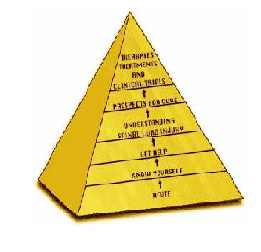

at distance 56.15622256365606:
(Class: pyramid)
at distance 73.46417286970005:
(Class: metronome)
at distance 74.19474239888756:
(Class: metronome)
at distance 74.38525618747366:
(Class: pyramid)
at distance 74.67847074968174:
(Class: metronome)
44 2.0
============= original: =============
(Class: hedgehog)


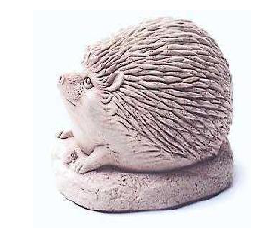

at distance 72.25944453294709:
(Class: strawberry)
at distance 72.79088483780251:
(Class: bonsai)
at distance 73.52935508206384:
(Class: cup)
at distance 74.68048134268459:
(Class: bass)
at distance 74.80509454922486:
(Class: menorah)
5758 0.0
============= original: =============
(Class: Motorbikes)


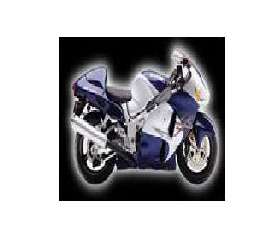

at distance 53.89141402462351:
(Class: Motorbikes)
at distance 54.095533121758955:
(Class: Motorbikes)
at distance 56.495060973977296:
(Class: Motorbikes)
at distance 56.55607957918044:
(Class: Motorbikes)
at distance 56.59932514658362:
(Class: Motorbikes)
2971 5.0
============= original: =============
(Class: minaret)


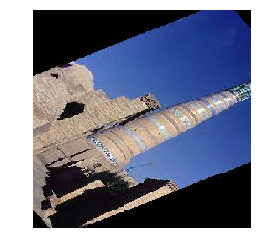

at distance 48.545677073113744:
(Class: minaret)
at distance 50.46773625812299:
(Class: minaret)
at distance 51.33489657439565:
(Class: minaret)
at distance 52.87988945059273:
(Class: minaret)
at distance 53.232278065673995:
(Class: minaret)
7032 5.0
============= original: =============
(Class: inline_skate)


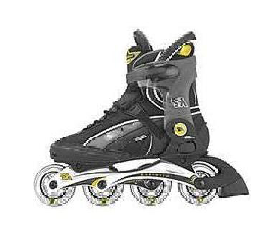

at distance 56.58684332596489:
(Class: inline_skate)
at distance 58.686544205253654:
(Class: inline_skate)
at distance 59.18416865165079:
(Class: inline_skate)
at distance 60.5487753866543:
(Class: inline_skate)
at distance 61.03231071523937:
(Class: inline_skate)
5692 5.0
============= original: =============
(Class: Faces)


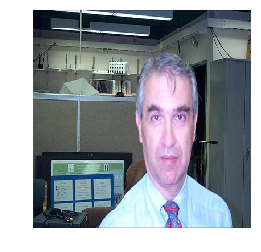

at distance 43.71259920906285:
(Class: Faces)
at distance 44.98267586448062:
(Class: Faces)
at distance 45.220687773589994:
(Class: Faces)
at distance 45.22912405773095:
(Class: Faces)
at distance 45.906272096936384:
(Class: Faces)
4301 5.0
============= original: =============
(Class: cup)


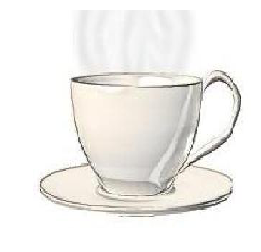

at distance 63.959904249675276:
(Class: cup)
at distance 65.06003723602375:
(Class: cup)
at distance 65.75705930811806:
(Class: cup)
at distance 67.7758175363269:
(Class: cup)
at distance 71.73795789697658:
(Class: cup)
7670 5.0
============= original: =============
(Class: ketch)


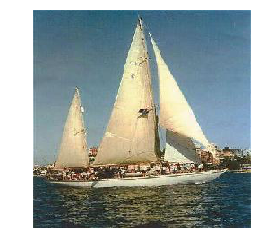

at distance 47.476632884897896:
(Class: ketch)
at distance 48.724654931740545:
(Class: ketch)
at distance 49.5120272067009:
(Class: schooner)
at distance 50.04764277546821:
(Class: ketch)
at distance 51.39187745555068:
(Class: ketch)
2175 4.0
============= original: =============
(Class: Motorbikes)


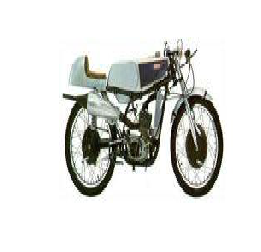

at distance 40.73530776570596:
(Class: Motorbikes)
at distance 44.0302430532845:
(Class: Motorbikes)
at distance 44.178071577643095:
(Class: Motorbikes)
at distance 44.34184072587705:
(Class: Motorbikes)
at distance 44.54891212957183:
(Class: Motorbikes)
2482 5.0
============= original: =============
(Class: nautilus)


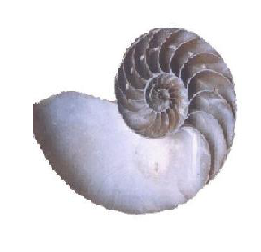

at distance 65.32727919596653:
(Class: nautilus)
at distance 68.09753303124668:
(Class: nautilus)
at distance 72.59612482317785:
(Class: nautilus)
at distance 73.96221792785073:
(Class: nautilus)
at distance 76.54914202927239:
(Class: nautilus)
5606 5.0
============= original: =============
(Class: watch)


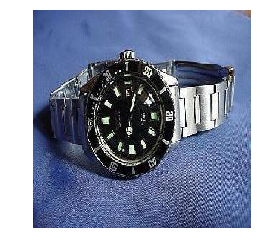

at distance 58.00748184669367:
(Class: watch)
at distance 63.43293140267454:
(Class: watch)
at distance 63.45475447179653:
(Class: watch)
at distance 63.882130711355785:
(Class: watch)
at distance 64.02259170805145:
(Class: watch)
1105 5.0
============= original: =============
(Class: rooster)


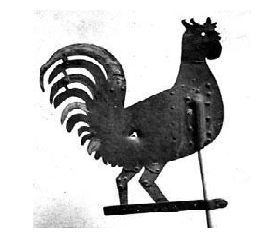

at distance 72.53892364021944:
(Class: ceiling_fan)
at distance 72.71484863576474:
(Class: cougar_face)
at distance 74.05137673506336:
(Class: rooster)
at distance 74.74233567390182:
(Class: gramophone)
at distance 75.02779359617317:
(Class: menorah)
5678 1.0
============= original: =============
(Class: watch)


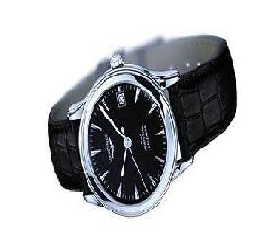

at distance 54.885607354283515:
(Class: watch)
at distance 57.542943659885935:
(Class: watch)
at distance 60.595037485258985:
(Class: watch)
at distance 61.111089936427085:
(Class: Motorbikes)
at distance 61.29316681501989:
(Class: Motorbikes)
1095 3.0
============= original: =============
(Class: Leopards)


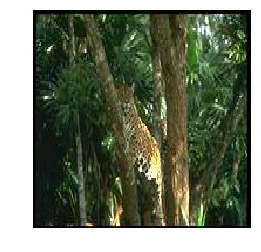

at distance 12.216239647755144:
(Class: Leopards)
at distance 39.70338397988695:
(Class: Leopards)
at distance 43.91532108604888:
(Class: Leopards)
at distance 46.53454511011496:
(Class: Leopards)
at distance 49.51554710235396:
(Class: Leopards)
5161 5.0
============= original: =============
(Class: soccer_ball)


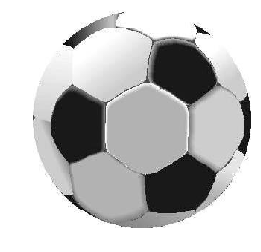

at distance 64.28628695346501:
(Class: soccer_ball)
at distance 66.52461425029023:
(Class: soccer_ball)
at distance 70.2624173189518:
(Class: soccer_ball)
at distance 71.11085256398246:
(Class: soccer_ball)
at distance 76.43791010162819:
(Class: soccer_ball)
5904 5.0
============= original: =============
(Class: watch)


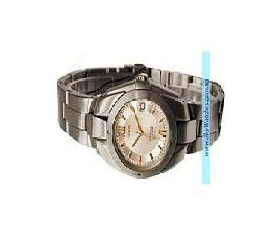

at distance 44.697185257573544:
(Class: watch)
at distance 50.196816918126885:
(Class: watch)
at distance 51.68937396130055:
(Class: watch)
at distance 54.885607354283515:
(Class: watch)
at distance 54.99729939548558:
(Class: watch)
1189 5.0
============= original: =============
(Class: umbrella)


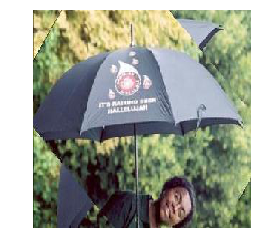

at distance 73.52792547442084:
(Class: umbrella)
at distance 74.64150596658213:
(Class: umbrella)
at distance 75.51937842334651:
(Class: umbrella)
at distance 75.75327270133563:
(Class: umbrella)
at distance 76.15480524755911:
(Class: umbrella)
5545 5.0
============= original: =============
(Class: lamp)


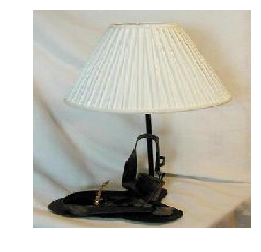

at distance 66.99689194871694:
(Class: lamp)
at distance 70.9561082767003:
(Class: lamp)
at distance 71.22003274084449:
(Class: lamp)
at distance 71.62045569133448:
(Class: lamp)
at distance 72.90402357009516:
(Class: lamp)
6729 5.0
============= original: =============
(Class: dragonfly)


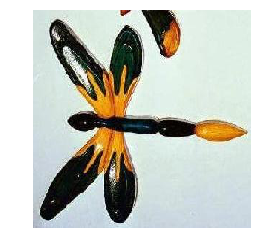

at distance 85.13412593069884:
(Class: dragonfly)
at distance 89.53869964395565:
(Class: ceiling_fan)
at distance 91.6144972141378:
(Class: dragonfly)
at distance 92.55501986800411:
(Class: water_lilly)
at distance 92.86873922347057:
(Class: lotus)
3229 2.0
============= original: =============
(Class: Motorbikes)


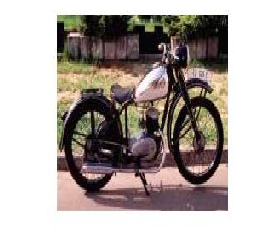

at distance 52.564738202660365:
(Class: Motorbikes)
at distance 54.60421637601246:
(Class: Motorbikes)
at distance 55.79305314789818:
(Class: Motorbikes)
at distance 56.637622262625186:
(Class: Motorbikes)
at distance 57.89989016677292:
(Class: Motorbikes)
2634 5.0
============= original: =============
(Class: platypus)


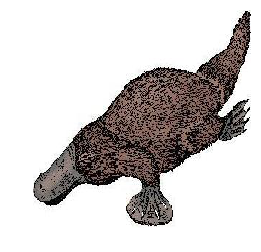

at distance 75.73388999272488:
(Class: platypus)
at distance 85.5140881248234:
(Class: brontosaurus)
at distance 87.02706007897042:
(Class: cougar_body)
at distance 89.00431450846953:
(Class: brontosaurus)
at distance 89.45964488593926:
(Class: platypus)
3652 2.0
============= original: =============
(Class: crayfish)


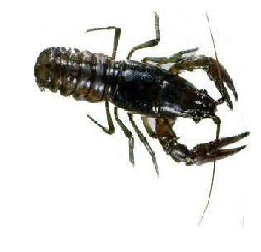

at distance 69.49769001517154:
(Class: lobster)
at distance 79.01606376385811:
(Class: crayfish)
at distance 80.48740093805155:
(Class: crayfish)
at distance 82.53830472650355:
(Class: crayfish)
at distance 84.60521525552412:
(Class: crayfish)
489 4.0
============= original: =============
(Class: Faces_easy)


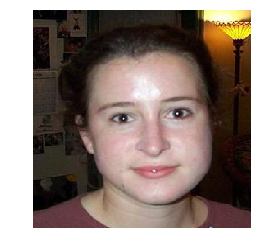

at distance 39.209303300942246:
(Class: Faces)
at distance 40.890096054372954:
(Class: Faces_easy)
at distance 42.52519526263983:
(Class: Faces_easy)
at distance 42.52917028819059:
(Class: Faces_easy)
at distance 43.1063176025989:
(Class: Faces_easy)
7491 4.0
============= original: =============
(Class: hawksbill)


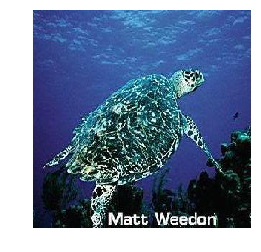

at distance 55.76846409588251:
(Class: hawksbill)
at distance 56.54608576976831:
(Class: hawksbill)
at distance 58.88342818347329:
(Class: hawksbill)
at distance 59.437322710505036:
(Class: hawksbill)
at distance 59.55639835956275:
(Class: hawksbill)
7576 5.0
============= original: =============
(Class: chair)


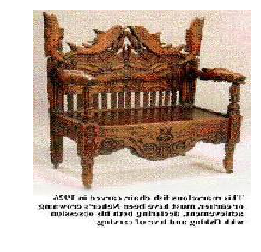

at distance 89.27752123784198:
(Class: elephant)
at distance 89.30303236872105:
(Class: chair)
at distance 90.31493532513446:
(Class: chair)
at distance 90.633872218977:
(Class: buddha)
at distance 92.27912174733294:
(Class: chair)
590 3.0
============= original: =============
(Class: Faces)


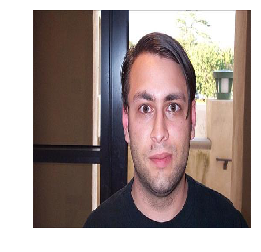

at distance 35.29985326421889:
(Class: Faces_easy)
at distance 36.75855859175653:
(Class: Faces)
at distance 37.45547390520653:
(Class: Faces_easy)
at distance 38.58049088855171:
(Class: Faces)
at distance 39.3655769062196:
(Class: Faces)
4355 3.0
============= original: =============
(Class: okapi)


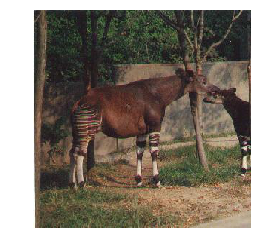

at distance 55.4163513812723:
(Class: okapi)
at distance 58.623621139501616:
(Class: okapi)
at distance 58.84376052930573:
(Class: okapi)
at distance 60.23744788626786:
(Class: okapi)
at distance 60.851138150919034:
(Class: okapi)
3783 5.0
[3.0, 3.0, 1.0, 5.0, 5.0, 5.0, 4.0, 5.0, 5.0, 0.0, 5.0, 5.0, 5.0, 1.0, 0.0, 2.0, 5.0, 5.0, 4.0, 4.0, 4.0, 2.0, 0.0, 1.0, 0.0, 4.0, 5.0, 0.0, 5.0, 5.0, 5.0, 5.0, 4.0, 5.0, 3.0, 5.0, 4.0, 5.0, 5.0, 5.0, 5.0, 2.0, 5.0, 5.0, 5.0, 4.0, 3.0, 5.0, 5.0, 5.0, 5.0, 5.0, 5.0, 3.0, 0.0, 4.0, 0.0, 1.0, 4.0, 5.0, 4.0, 1.0, 5.0, 5.0, 5.0, 0.0, 3.0, 3.0, 4.0, 2.0, 5.0, 0.0, 4.0, 5.0, 5.0, 4.0, 0.0, 5.0, 5.0, 1.0, 5.0, 5.0, 0.0, 5.0, 4.0, 0.0, 5.0, 0.0, 1.0, 4.0, 3.0, 5.0, 3.0, 5.0, 4.0, 5.0, 5.0, 3.0, 5.0, 4.0, 5.0, 5.0, 3.0, 2.0, 0.0, 5.0, 0.0, 5.0, 5.0, 1.0, 5.0, 5.0, 4.0, 5.0, 5.0, 2.0, 2.0, 5.0, 5.0, 0.0, 0.0, 5.0, 5.0, 5.0, 3.0, 0.0, 3.0, 5.0, 5.0, 3.0, 1.0, 5.0, 4.0, 3.0, 4.0, 3.0, 3.0, 5.0, 5.0, 5.0, 5.0, 5.0, 1.0, 5.0, 5.0, 5.0, 1.0, 1.0, 5.0, 1.0, 4.0, 5.0,

In [3]:
# NOTE: you will first need to apply some changes to "Practical-3.3.0_preprocess-caltech101.ipynb" and run it
#       to obtain a pickle file with "fc1"-features. You don't need to show these changes here.


# make random selection of n query images/indices, the same for all experiments
#########################################################################################################################
n = 200
n_examples = 8677  # the dataset has 8677 images
indices = np.random.choice(range(n_examples), size=n, replace=False)

# iterate over two data representations (make sure these two files exist in the "data" subfolder first)
scores = []
files = ("caltech101_VGG16_fc1.p", "caltech101_VGG16_fc2.p")
for datapath in files:
    # load the dataset
    with open(os.path.join("data", datapath), "rb") as f:
        X_fc, y, X_paths, classes = pickle.load(f)

    # === SOLUTION: ===
    # insert code here
    
    # 5 neighbors + itself (Euclidian distance)
    print("##########################################################################################")
    print("#################################", datapath, "#################################")
    neigh = NearestNeighbors(n_neighbors=6, p=2)
    neigh.fit(X_fc)
    
    # Find NearestNeighbors of the images corresponding to the indices
    X = X_fc[indices]
    nn = neigh.kneighbors(X)
    
    print("Query results")
    
    score = []
    for i, distances, nn_indices in zip(indices, nn[0], nn[1]):
        print("============= original: =============")
        print("(Class: {})".format(classes[y[i]]))
        show_img(X_paths[i])
        
        score.append(0.0)
        for dist, j in zip(distances, nn_indices):
            # Exclude query image from query results
            if i!=j:
                print("at distance {}:".format(dist))
                print("(Class: {})".format(classes[y[j]]))
                # show_img(X_paths[j])
                
                if classes[y[i]] == classes[y[j]]:
                    score[-1] +=1
        
        print(score[-1])
    
    scores.append(score)
        
    
for i in range(len(files)):
    print(scores[i])
    print(files[i], "Score:", sum(scores[i])/len(scores[i]))

***

**b)** Which representation ("neural code") provided better features for the given retrieval task? 
Justify your answer and discuss possible reasons for the observed results. Relate your answer to the conclusions in the paper "Neural Codes for Image Retrieval".

**Answer:**

*=== write your answer here ===*

*model architecture*
1. input_1 (InputLayer)
1. block1_conv1 (Conv2D)
1. block1_conv2 (Conv2D)
1. block1_pool (MaxPooling2D)
1. block2_conv1 (Conv2D)
1. block2_conv2 (Conv2D)
1. block2_pool (MaxPooling2D)
1. block3_conv1 (Conv2D)
1. block3_conv2 (Conv2D)
1. block3_conv3 (Conv2D)
1. block3_pool (MaxPooling2D)
1. block4_conv1 (Conv2D)
1. block4_conv2 (Conv2D)
1. block4_conv3 (Conv2D)
1. block4_pool (MaxPooling2D)
1. block5_conv1 (Conv2D)
1. block5_conv2 (Conv2D)
1. block5_conv3 (Conv2D)
1. block5_pool (MaxPooling2D)
1. flatten (Flatten)
1. fc1 (Dense)
1. fc2 (Dense)
1. predictions (Dense)

We tested the performance of the neural codes of fc1 and fc2.

*Results*
- fc1 Score: 3.61
- fc2 Score: 3.905


Hence the fc2 score is better. This is not consistent with the results in the paper "Neural Codes for Image Retrieval". They found that the layer that is two layers below the outputs performs better. In our experiment the neural codes of the fc2 layer is better. This is the last layer before the output layer.

In the paper they specultated this had to do with the fact that that the last layers are too specialized for classification. In our case this does not seem to be the case. This might have to do with the fact that the score metric uses classes of the images to measure the retrieval performance.

***

### Task 1.2: Detailed evaluation
**a)** The retrieval scores can vary from one query image to another. Some images are quite representative and for them retrieval works well, some are not so much.
For the same retrieval task given above using "fc2"-features, find (if possible) six query images such that they range from excellent to poor retrieval performance. More specifically find example query images that result in query scores of exactly 0, 1, 2, 3, 4, and 5.

Visualise the six (or less) resulting query images.

In [ ]:
# you'll need these extra imports:
from keras.preprocessing import image
import matplotlib.pyplot as plt
%matplotlib inline

9
============= original: =============
(Class: lobster)


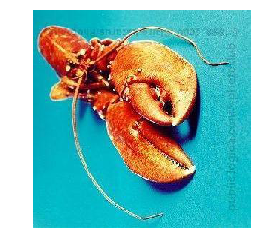

at distance 81.47149962883405:
(Class: octopus)


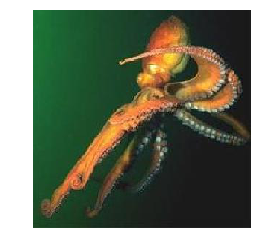

at distance 82.11712174883415:
(Class: stapler)


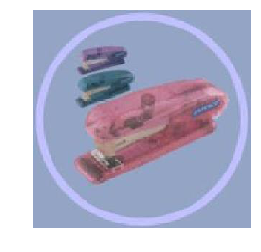

at distance 87.18899517765783:
(Class: octopus)


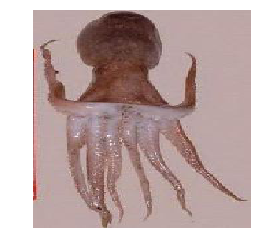

at distance 87.48625717649345:
(Class: crayfish)


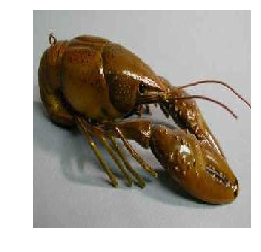

at distance 87.58427059695524:
(Class: crayfish)


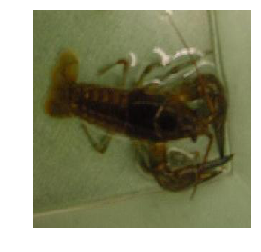

57
============= original: =============
(Class: platypus)


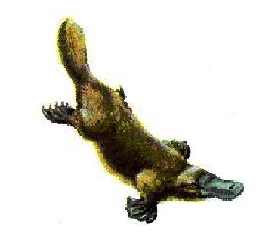

at distance 76.8305084885586:
(Class: stegosaurus)


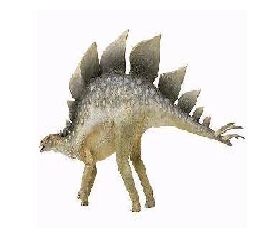

at distance 76.87342626221842:
(Class: bonsai)


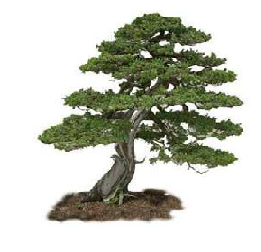

at distance 79.97348069664234:
(Class: airplanes)


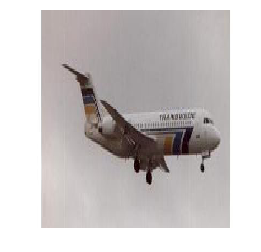

at distance 80.2740581004755:
(Class: brontosaurus)


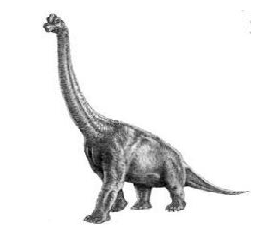

at distance 80.50815529559642:
(Class: platypus)


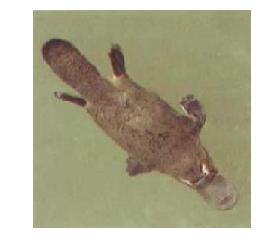

2
============= original: =============
(Class: rooster)


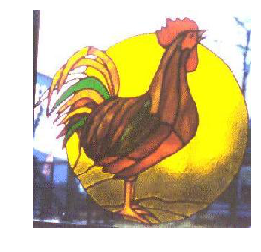

at distance 67.6547853239865:
(Class: rooster)


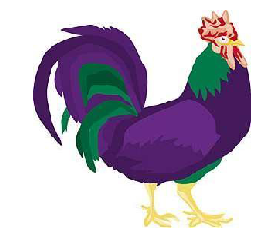

at distance 70.0185330716357:
(Class: rooster)


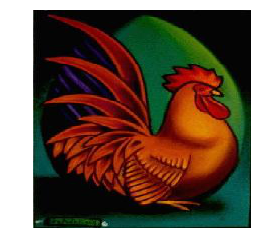

at distance 72.91911666158786:
(Class: lotus)


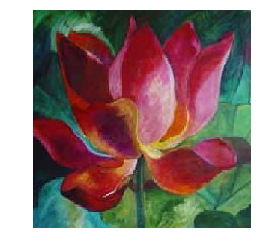

at distance 73.68023633988237:
(Class: lotus)


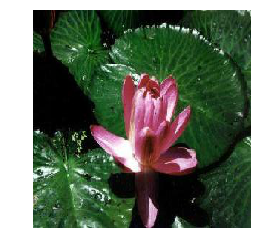

at distance 74.38522944497447:
(Class: lotus)


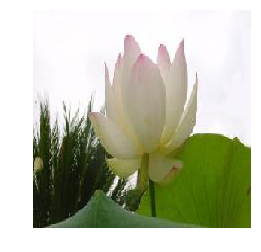

0
============= original: =============
(Class: ketch)


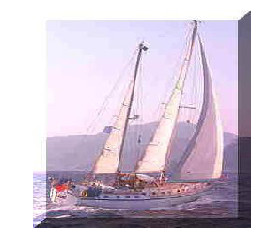

at distance 40.5852287823896:
(Class: schooner)


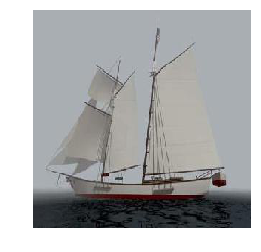

at distance 44.107575970410295:
(Class: ketch)


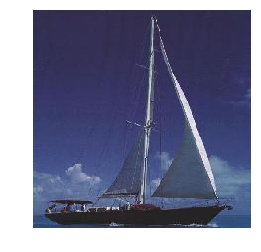

at distance 44.66700341317258:
(Class: ketch)


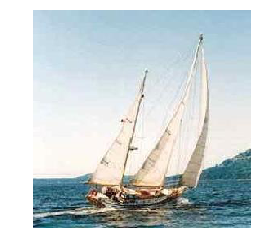

at distance 45.86543417712053:
(Class: schooner)


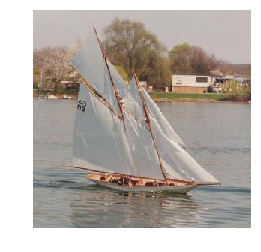

at distance 46.13917379519671:
(Class: ketch)


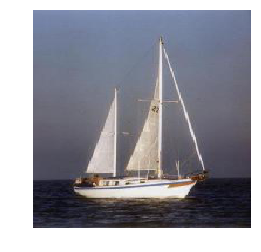

18
============= original: =============
(Class: lotus)


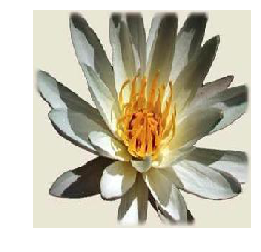

at distance 69.91050881686895:
(Class: lotus)


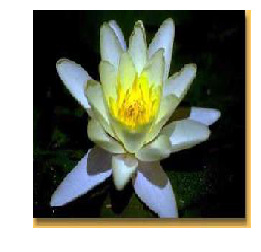

at distance 72.72059960966023:
(Class: lotus)


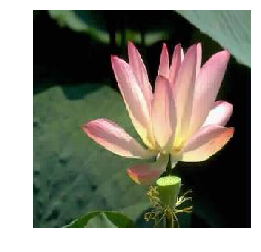

at distance 72.88522051341191:
(Class: lotus)


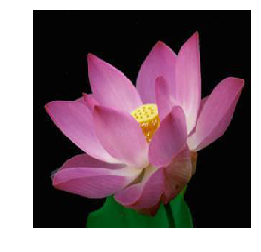

at distance 72.93025801983175:
(Class: water_lilly)


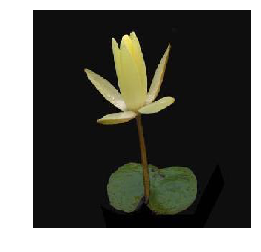

at distance 74.81009576138597:
(Class: lotus)


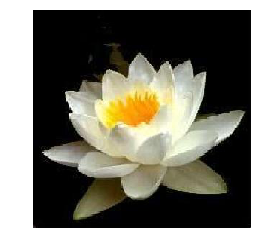

3
============= original: =============
(Class: Faces)


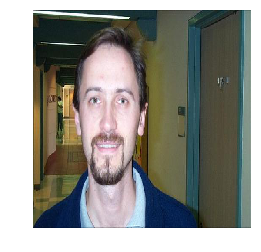

at distance 33.54069337961136:
(Class: Faces)


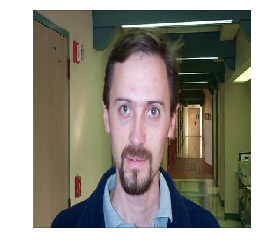

at distance 34.25261305143778:
(Class: Faces)


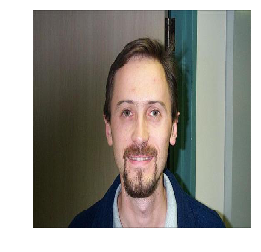

at distance 34.52990313221452:
(Class: Faces)


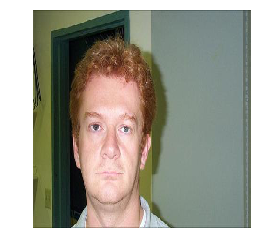

at distance 35.23270574323288:
(Class: Faces)


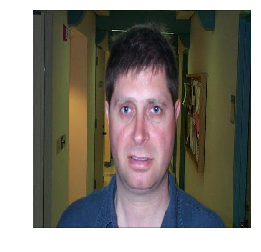

at distance 35.88349342684151:
(Class: Faces)


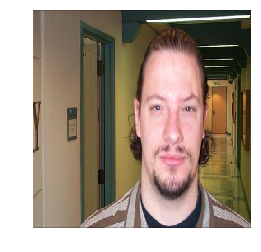

In [4]:
# load the dataset
datapath = "caltech101_VGG16_fc2.p"
with open(os.path.join("data", datapath), "rb") as f:
    X_fc, y, X_paths, classes = pickle.load(f)

neigh = NearestNeighbors(n_neighbors=6, p=2)
neigh.fit(X_fc)
    
# Find NearestNeighbors of the images corresponding to the indices
X = X_fc[indices]
nn = neigh.kneighbors(X)

for i in range(6):
    example_query_index = scores[files.index(datapath)].index(i)
    print(example_query_index)
    print("============= original: =============")
    print("(Class: {})".format(classes[y[indices[example_query_index]]]))
    show_img(X_paths[indices[example_query_index]])
    
    for dist, j in zip(nn[0][example_query_index], nn[1][example_query_index]):
        # Exclude query image from query results
        if indices[example_query_index]!=j:
            print("at distance {}:".format(dist))
            print("(Class: {})".format(classes[y[j]]))
            show_img(X_paths[j])

***

**b)** Looking at the results, what can you say about the "types" of images that obtain good retrieval scores compared to those obtaining poor retrieval scores? Give an explanation and possible solution(s).

(*HINT: How did we obtain data representations for similarity measures?*)

**Answer:**

*=== write your answer here ===*

***

### Task 1.3: Subjective evaluation
We will now use the "fc2"-features to do image retrieval for query images from the "BACKGROUND_Google" set from the Caltech101 dataset. These images are not associated to a particular class, so we will evaluate them subjectively instead.

**a)** Find two query images from the "BACKGROUND_Google" class, such that for the first query image relevant/similar images are retrieved (according to your own definition of relevancy/similarity), and for the second image mainly irrelevant/dissimilar images are retrieved. For each of them, visualise its 5 nearest neighbors in the Caltech101 dataset (*so do NOT retrieve images from the "BACKGROUND_Google" class!*), according to the "fc2-features" and L2-distance.

============= Query image =============
data/caltech101/BACKGROUND_Google/image_0451.jpg


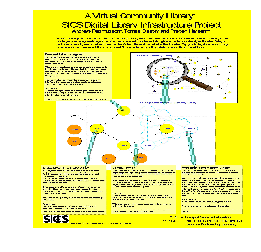

(Class: snoopy)


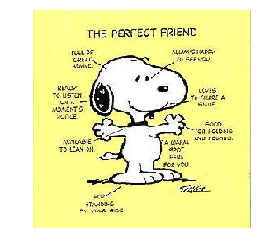

(Class: brain)


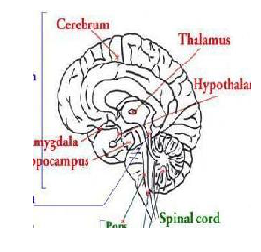

(Class: snoopy)


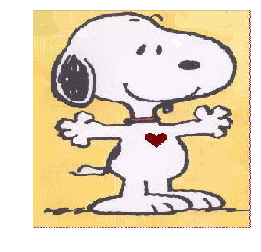

(Class: snoopy)


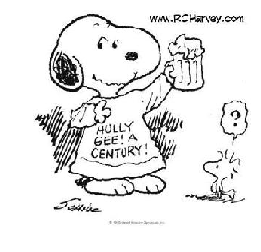

(Class: bass)


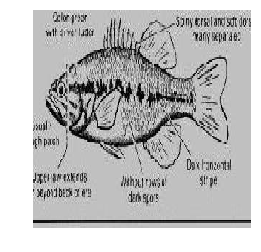

============= Query image =============
data/caltech101/BACKGROUND_Google/image_0405.jpg


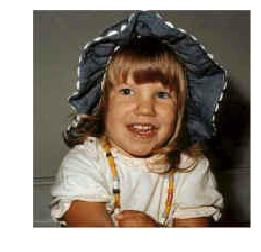

(Class: Faces)


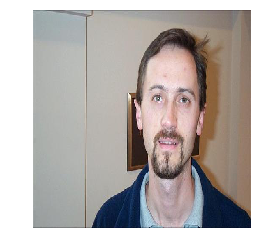

(Class: Faces)


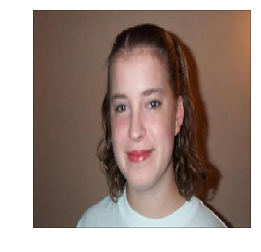

(Class: Faces)


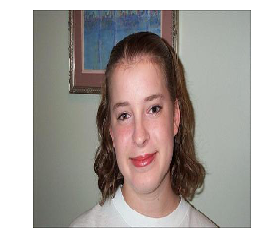

(Class: Faces)


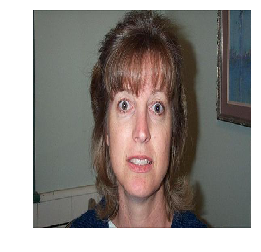

(Class: Faces)


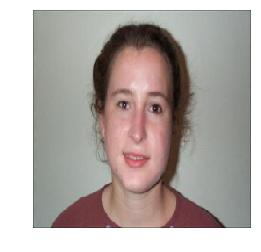

In [9]:
# load the BACKGROUND_Google set
with open(os.path.join("data","caltech101_VGG16_fc2_bg.p"), "rb") as f:
    bg_fc2, bg_paths = pickle.load(f)

# Load caltech101 set
datapath = "caltech101_VGG16_fc2.p"
with open(os.path.join("data", datapath), "rb") as f:
    X_fc, y, X_paths, classes = pickle.load(f)

# === SOLUTION: ===
# insert code here

neigh = NearestNeighbors(n_neighbors=5, p=2)
neigh.fit(X_fc)

# Find NearestNeighbors of the images corresponding to the indices
nn = neigh.kneighbors(bg_fc2)

for i, (distances, nn_indices) in enumerate(zip(nn[0], nn[1])):
    if i in [1,85]:
        print("============= Query image =============")
        print(bg_paths[i])
        show_img(bg_paths[i])

        for dist, j in zip(distances, nn_indices):
            # Exclude query image from query results

            print("(Class: {})".format(classes[y[j]]))
            show_img(X_paths[j])
    

***

**b)** Motivate your idea of "relevance": why do you consider the results for the first image relevant/similar, and those for the second image irrelevant/dissimilar?

**Answer:**

*=== write your answer here ===*

Even though the images in the BACKGROUND_Google dataset do not have a class we can still find try to find images which have a similar subject / class. The look of the images is less important in our subjective evaluation

***

**c)** Explain why you think this retrieval method (nearest neighbor for neural codes from VGG16) performs better on the first image than on the second.

**Answer:**

*=== write your answer here ===*

The picture of a yellow scientific poster returns other illustrations. This is probably since these have few lines with high contrast. However we do not want to find pictures with a similar look, but with a similar subject / class. 

We found that the picture of a girl returned pictures of other faces. This picture is similar to the training data. Therefore it performs well.

***

### Task 1.4: Dimensionality reduction

**a)** So far we've been using 4096-dimensional neural codes. This space is however still quite high-dimensional. Apply a dimensionality reduction method and evaluate the effect on the retrieval performance.

* Use PCA to obtain lower-dimensional representations of the Caltech101 data "fc2"-features (try the same compression rates as in Table 2 of the "Neural Codes for Image Retrieval" paper).
* Evaluate the same retrieval task as explained at the start of this question for each of the compression rates/dimensionalities. Report the retrieval scores.

*HINT: See http://scikit-learn.org/stable/modules/generated/sklearn.decomposition.PCA.html on how to transform a dataset with PCA.*

In [25]:
# import PCA from scikit-learn
from sklearn.decomposition import PCA

In [41]:
# load the data
datapath = "caltech101_VGG16_fc2.p"
with open(os.path.join("data", datapath), "rb") as f:
    X_fc, y, X_paths, classes = pickle.load(f)
    
# make random selection of n query images/indices, the same for all experiments
n = 200
n_examples = 8677  # the dataset has 8677 images
indices = np.random.choice(range(n_examples), size=n, replace=False)


# === SOLUTION: ===
# insert code here
dimensions = [16, 32, 64, 128, 256, 512]

scores = []
for dim in dimensions:
    print("##########################################################################################")
    print("#################################### dimensionality", dim, "###################################")
    
    pca = PCA(n_components=dim)
    X_fc_reduced = pca.fit_transform(X_fc)
    
    neigh = NearestNeighbors(n_neighbors=6, p=2)
    neigh.fit(X_fc_reduced)
    
    # Find NearestNeighbors of the images corresponding to the indices
    X = X_fc_reduced[indices]
    nn = neigh.kneighbors(X)
    
    print("Query results")
    
    score = []
    for i, distances, nn_indices in zip(indices, nn[0], nn[1]):
        print("============= original: =============")
        print("(Class: {})\n".format(classes[y[i]]))
        #show_img(X_paths[i])
        
        score.append(0.0)
        for dist, j in zip(distances, nn_indices):
            # Exclude query image from query results
            if i!=j:
                #print("at distance {}:".format(dist))
                print("(Class: {})".format(classes[y[j]]))
                #show_img(X_paths[j])
                
                if classes[y[i]] == classes[y[j]]:
                    score[-1] +=1
        
        print(score[-1])
    
    scores.append(score)
    
for sco, dim in zip(scores, dimensions):
    print("Dimensions:", dim, "Score:", sum(sco)/len(sco))

##########################################################################################
#################################### dimensionality 16 ###################################
Query results
============= original: =============
(Class: Leopards)

(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
5.0
============= original: =============
(Class: mayfly)

(Class: mayfly)
(Class: water_lilly)
(Class: dragonfly)
(Class: dragonfly)
(Class: water_lilly)
1.0
============= original: =============
(Class: airplanes)

(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
5.0
============= original: =============
(Class: rhino)

(Class: rhino)
(Class: rhino)
(Class: elephant)
(Class: rhino)
(Class: rhino)
4.0
============= original: =============
(Class: dalmatian)

(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
5.0
============= original: =============
(Class: st

============= original: =============
(Class: menorah)

(Class: menorah)
(Class: menorah)
(Class: lamp)
(Class: lamp)
(Class: menorah)
3.0
============= original: =============
(Class: dragonfly)

(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
5.0
============= original: =============
(Class: scorpion)

(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
5.0
============= original: =============
(Class: soccer_ball)

(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
5.0
============= original: =============
(Class: ant)

(Class: ant)
(Class: octopus)
(Class: lobster)
(Class: mandolin)
(Class: dragonfly)
1.0
============= original: =============
(Class: rooster)

(Class: rooster)
(Class: rooster)
(Class: rooster)
(Class: rooster)
(Class: rooster)
5.0
============= original: =============
(Class: Faces)

(Class: Faces)
(Class: Faces)
(Class: Faces)


Query results
============= original: =============
(Class: Leopards)

(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
5.0
============= original: =============
(Class: mayfly)

(Class: mayfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: mayfly)
(Class: mayfly)
3.0
============= original: =============
(Class: airplanes)

(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
5.0
============= original: =============
(Class: rhino)

(Class: rhino)
(Class: rhino)
(Class: rhino)
(Class: elephant)
(Class: rhino)
4.0
============= original: =============
(Class: dalmatian)

(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
5.0
============= original: =============
(Class: stegosaurus)

(Class: crocodile_head)
(Class: crocodile_head)
(Class: crocodile_head)
(Class: crocodile_head)
(Class: crocodile_head)
0.0
============= original: =============
(Class: grand_pian


(Class: rooster)
(Class: rooster)
(Class: rooster)
(Class: rooster)
(Class: rooster)
5.0
============= original: =============
(Class: Faces)

(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
5.0
============= original: =============
(Class: soccer_ball)

(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
5.0
============= original: =============
(Class: platypus)

(Class: platypus)
(Class: brontosaurus)
(Class: brontosaurus)
(Class: brontosaurus)
(Class: platypus)
2.0
============= original: =============
(Class: barrel)

(Class: barrel)
(Class: barrel)
(Class: barrel)
(Class: barrel)
(Class: cup)
4.0
============= original: =============
(Class: ketch)

(Class: ketch)
(Class: ketch)
(Class: ketch)
(Class: ketch)
(Class: ketch)
5.0
============= original: =============
(Class: Leopards)

(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
5.0
============= original: =

Query results
============= original: =============
(Class: Leopards)

(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
5.0
============= original: =============
(Class: mayfly)

(Class: mayfly)
(Class: mayfly)
(Class: water_lilly)
(Class: mayfly)
(Class: dragonfly)
3.0
============= original: =============
(Class: airplanes)

(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
5.0
============= original: =============
(Class: rhino)

(Class: rhino)
(Class: rhino)
(Class: rhino)
(Class: rhino)
(Class: rhino)
5.0
============= original: =============
(Class: dalmatian)

(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
5.0
============= original: =============
(Class: stegosaurus)

(Class: crocodile_head)
(Class: crocodile_head)
(Class: crocodile_head)
(Class: crocodile_head)
(Class: crocodile)
0.0
============= original: =============
(Class: grand_piano)

(C

(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
5.0
============= original: =============
(Class: soccer_ball)

(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
5.0
============= original: =============
(Class: platypus)

(Class: platypus)
(Class: brontosaurus)
(Class: cougar_body)
(Class: beaver)
(Class: brontosaurus)
1.0
============= original: =============
(Class: barrel)

(Class: barrel)
(Class: barrel)
(Class: barrel)
(Class: barrel)
(Class: barrel)
5.0
============= original: =============
(Class: ketch)

(Class: ketch)
(Class: ketch)
(Class: ketch)
(Class: ketch)
(Class: ketch)
5.0
============= original: =============
(Class: Leopards)

(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
5.0
============= original: =============
(Class: airplanes)

(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
5.0
============

Query results
============= original: =============
(Class: Leopards)

(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
(Class: Leopards)
5.0
============= original: =============
(Class: mayfly)

(Class: mayfly)
(Class: mayfly)
(Class: mayfly)
(Class: mayfly)
(Class: dragonfly)
4.0
============= original: =============
(Class: airplanes)

(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
(Class: airplanes)
5.0
============= original: =============
(Class: rhino)

(Class: rhino)
(Class: rhino)
(Class: rhino)
(Class: rhino)
(Class: rhino)
5.0
============= original: =============
(Class: dalmatian)

(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
(Class: dalmatian)
5.0
============= original: =============
(Class: stegosaurus)

(Class: crocodile_head)
(Class: crocodile)
(Class: crocodile_head)
(Class: crocodile_head)
(Class: crocodile_head)
0.0
============= original: =============
(Class: grand_piano)

(Class:

============= original: =============
(Class: bass)

(Class: bonsai)
(Class: octopus)
(Class: airplanes)
(Class: hawksbill)
(Class: buddha)
0.0
============= original: =============
(Class: trilobite)

(Class: trilobite)
(Class: trilobite)
(Class: trilobite)
(Class: trilobite)
(Class: trilobite)
5.0
============= original: =============
(Class: dragonfly)

(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: minaret)
(Class: bass)
3.0
============= original: =============
(Class: menorah)

(Class: menorah)
(Class: menorah)
(Class: menorah)
(Class: menorah)
(Class: menorah)
5.0
============= original: =============
(Class: dragonfly)

(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
5.0
============= original: =============
(Class: scorpion)

(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
5.0
============= original: =============
(Class: soccer_ball)

(Class: soccer_ball)
(Class: soccer_


(Class: menorah)
(Class: menorah)
(Class: menorah)
(Class: menorah)
(Class: menorah)
5.0
============= original: =============
(Class: dragonfly)

(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
5.0
============= original: =============
(Class: scorpion)

(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
5.0
============= original: =============
(Class: soccer_ball)

(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
(Class: soccer_ball)
5.0
============= original: =============
(Class: ant)

(Class: octopus)
(Class: butterfly)
(Class: ant)
(Class: minaret)
(Class: water_lilly)
1.0
============= original: =============
(Class: rooster)

(Class: rooster)
(Class: rooster)
(Class: rooster)
(Class: rooster)
(Class: rooster)
5.0
============= original: =============
(Class: Faces)

(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
(Class: Faces)
5.0
============

============= original: =============
(Class: bass)

(Class: airplanes)
(Class: octopus)
(Class: bonsai)
(Class: hawksbill)
(Class: bonsai)
0.0
============= original: =============
(Class: trilobite)

(Class: trilobite)
(Class: trilobite)
(Class: trilobite)
(Class: trilobite)
(Class: trilobite)
5.0
============= original: =============
(Class: dragonfly)

(Class: dragonfly)
(Class: dragonfly)
(Class: bass)
(Class: butterfly)
(Class: minaret)
2.0
============= original: =============
(Class: menorah)

(Class: menorah)
(Class: menorah)
(Class: menorah)
(Class: menorah)
(Class: menorah)
5.0
============= original: =============
(Class: dragonfly)

(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
(Class: dragonfly)
5.0
============= original: =============
(Class: scorpion)

(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
(Class: scorpion)
5.0
============= original: =============
(Class: soccer_ball)

(Class: soccer_ball)
(Class: soccer_

***

**b)** Discuss your results: how much can you further reduce the dimensionality of the data representations, without affecting the retrieval performance (much)? Compare these results to those from the paper, are your conclusions similar or not?

**Answer:**

*=== write your answer here ===*

We perfrmed PCA dimensionality reduction on our neural codes. The results of our experiments are as follows:

*Results*
- Dimensions: 16 Score: 3.585
- Dimensions: 32 Score: 3.915
- Dimensions: 64 Score: 4.115
- Dimensions: 128 Score: 4.1
- Dimensions: 256 Score: 4.075
- Dimensions: 512 Score: 4.03

If we heavily compress our data we find that we sacrifice some our retrieval performance. However this applies only when we compress it to less than 32 - 64 dimensions. We find that the performance of more than 64 dimensions is very good. This is in line with the findings in the paper "Neural Codes for Image Retrieval". They found similar performance degradation if we compress further than 32 dimensions.

***

## Question 2: Fashion-MNIST (12.5pt)
For this question we will work with the "Fashion-MNIST" dataset. This dataset is modelled to have the same specifics as MNIST; it consists of a training set of 60,000 examples, and a test set of 10,000 examples. Each example is a 28x28 greyscale image, associated with a label from one of 10 classes. The images represent various clothing items (as opposed to handwritten digits for MNIST), each class represents a different type of clothing item. The following classes exist:
* 0:	T-shirt/top
* 1:	Trouser
* 2:	Pullover
* 3:	Dress
* 4:	Coat
* 5:	Sandal
* 6:	Shirt
* 7:	Sneaker
* 8:	Bag
* 9:	Ankle boot

In this question we will investigate various ways to model visual similarity for this dataset, in order to perform image retrieval. For more info about the dataset, see https://github.com/zalandoresearch/fashion-mnist.

The dataset can directly be obtained through Keras:

In [ ]:
from keras.datasets import fashion_mnist
from keras.utils import to_categorical
from keras import backend as K

# load the data
(x_train, y_train), (x_test, y_test) = fashion_mnist.load_data()

# properties of the data
img_rows, img_cols, chns = 28, 28, 1
n_classes = 10

# reshape
if K.image_data_format() == 'channels_first':
    x_train = x_train.reshape(x_train.shape[0], chns, img_rows, img_cols)
    x_test = x_test.reshape(x_test.shape[0], chns, img_rows, img_cols)
    input_shape = (chns, img_rows, img_cols)
else:
    x_train = x_train.reshape(x_train.shape[0], img_rows, img_cols, chns)
    x_test = x_test.reshape(x_test.shape[0], img_rows, img_cols, chns)
    input_shape = (img_rows, img_cols, chns)

# normalise
x_train = x_train.astype("float32")
x_test = x_test.astype("float32")
x_train /= 255
x_test /= 255

# transform labels to one-hot encoding, but also keep original single-digit encoding
y_train_digits = y_train
y_test_digits = y_test
y_train = to_categorical(y_train_digits, n_classes)
y_test = to_categorical(y_test_digits, n_classes)

print("X_train shape:", x_train.shape)
print("y_train shape:", y_train.shape)
print("X_test shape:", x_test.shape)
print("y_test shape:", y_test.shape)

classes = ["T-shirt/top", "Trouser", "Pullover", "Dress", "Coat", "Sandal", "Shirt", "Sneaker", "Bag", "Ankle boot"]

# show an example
example_id = 0  # pick any integer from 0 to 59999 to visualize a training example
example = x_train[example_id].reshape(img_rows, img_cols)
label = y_train[example_id]
label_digit = y_train_digits[example_id]
label_class = classes[label_digit]
plt.matshow(example, cmap="gray")
plt.axis("off")
plt.show()
print("Class: {} ({})".format(label_class, label_digit))

Consider the following situation: We have a fully labelled dataset (the ***labelled set***) of the images from the first 5 classes (t-shirts/tops, trousers, pullovers, dresses, coats). We are then supplied with an unlabelled dataset (the ***retrieval set***) containing the remaining Fashion-MNIST images (sandals, shirts, sneakers, bags, ankle boots) on which we want to be able to perform image retrieval. So we cannot use labels from the retrieval set, since we do not know them (note that in our case we *do* have the labels, but we will only use them for evaluation).

The following code splits the dataset up into two sets representing 5 classes each. Observe that the labelled and the retrieval set have exactly the same size.

In [ ]:
# obtain indices of labelled and retrieval sets
indices_train_l = np.argwhere(y_train_digits < 5).flatten()  # indices labelled training set
indices_train_r = np.argwhere(y_train_digits >= 5).flatten()  # indices retrieval training set
indices_test_l = np.argwhere(y_test_digits < 5).flatten()  # indices labelled test set
indices_test_r = np.argwhere(y_test_digits >= 5).flatten()  # indices retrieval test set

# split up train and test set (images and labels)
x_train_l = x_train[indices_train_l]
x_train_r = x_train[indices_train_r]
y_train_l = y_train[indices_train_l]
y_train_r = y_train[indices_train_r]
y_train_digits_l = y_train_digits[indices_train_l]
y_train_digits_r = y_train_digits[indices_train_r]
x_test_l = x_test[indices_test_l]
x_test_r = x_test[indices_test_r]
y_test_l = y_test[indices_test_l]
y_test_r = y_test[indices_test_r]
y_test_digits_l = y_test_digits[indices_test_l]
y_test_digits_r = y_test_digits[indices_test_r]

# labels are now one-hot encoded 10-dimensional vectors, but only the first or last five dimensions are used
# omit unused dimensions to obtain 5-dimensional one-hot encodings
y_train_l = y_train_l[:, :5]
y_train_r = y_train_r[:, 5:]
y_test_l = y_test_l[:, :5]
y_test_r = y_test_r[:, 5:]
# (note that the dimensions of y_train_l/y_test_l do not correspond to those of y_train_r/y_test_r now)

# print the shapes
print(x_train_l.shape)
print(x_train_r.shape)
print(y_train_l.shape)
print(y_train_r.shape)
print(y_train_digits_l.shape)
print(y_train_digits_r.shape)
print(x_test_l.shape)
print(x_test_r.shape)
print(y_test_l.shape)
print(y_test_r.shape)
print(y_test_digits_l.shape)
print(y_test_digits_r.shape)

***

### Task 2.1: Fashion neural retrieval
**a)** Design an MLP (multilayer perceptron) for classification on the first 5 classes of the Fashion-MNIST dataset (i.e. only use `x_train_l` for training). You may include Dropout and BatchNormalization if needed. Let the last hidden dense layer (before the 5-dimensional output layer) have 128 dimensions. (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later.*)

Train it to classify images into their corresponding classes. Make sure that it achieves decent accuracy (at least 90%) on the labelled test set `x_test_l` (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [ ]:
# import sequential model and layers
from keras.models import Sequential
from keras.layers import Flatten, Dense, Dropout, BatchNormalization

In [ ]:
mlp = Sequential()

# === SOLUTION: ===
# insert code here

In [ ]:
# create directory if doesn't exist yet
try:
    os.mkdir("assignment2_models")
except(FileExistsError):
    pass

# save the model
mlp.save(os.path.join("assignment2_models", "mlp_fashionmnist_l.h5"))

***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

*=== write your answer here ===*

***

### Task 2.2: Fashion neural retrieval #2
**a)** Design a CNN (convolutional neural network) for classification on the first 5 classes of the Fashion-MNIST dataset (i.e. only use x_train_l for training), consisting of a number of Convolutions with Max-Pooling, followed by one or more Dense layers. You may use Dropout and BatchNormalization to improve generalization and training speed. Let the last hidden dense layer (before the 5-dimensional output layer) have 128 dimensions. (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later.*)

Train the CNN to classify images into their corresponding classes. Make sure that it achieves decent accuracy (at least 94%) on the test set `x_test_l` (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [ ]:
# import additional layers
from keras.layers import Conv2D, MaxPooling2D

In [ ]:
cnn = Sequential()

# === SOLUTION: ===
# insert code here

In [ ]:
# save the model
cnn.save(os.path.join("assignment2_models", "cnn_fashionmnist_l.h5"))

***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

*=== write your answer here ===*

***

### Task 2.3: Fashion neural retrieval #3
**a)** Design a (convolutional) Denoising Autoencoder (DAE) for the *full* Fashion-MNIST dataset (i.e. use `x_train`, *not* `x_train_l`). For the encoder, use only Convolutional layers and Max-Pooling, followed by a Dense layer with 128 units. The output of this layer will be the "code" of the autoencoder (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later*). For the decoder, start with a Dense layer to upscale to a suitable dimension, and then use only Convolutional layers and UpSampling. You may use BatchNormalization to speed up training.

Train the DAE to reconstruct noisy images to the original input images. Make sure that it achieves a binary cross-entropy loss of at most 0.29 on the test set (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [ ]:
# import additional layer
from keras.layers import UpSampling2D, Reshape

In [ ]:
# obtain noisy version of data
noise_factor = 0.5
x_train_noisy = x_train + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=x_train.shape) 
x_test_noisy = x_test + noise_factor * np.random.normal(loc=0.0, scale=1.0, size=x_test.shape) 

x_train_noisy = np.clip(x_train_noisy, 0., 1.)
x_test_noisy = np.clip(x_test_noisy, 0., 1.)


# define autoencoder
dae = Sequential()

# === SOLUTION: ===
# insert code here

In [ ]:
# save the model
dae.save(os.path.join("assignment2_models", "dae_fashionmnist.h5"))

***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

*=== write your answer here ===*

***

Visualise a few test examples, their noisy versions, and their reconstructions.

In [ ]:
# NOTE: you don't need to change this code, just run it after having trained the DAE
def plot_examples(x):
    n = 10
    plt.figure(figsize=(20, 2))
    for i in range(n):
        ax = plt.subplot(1, n, i+1)
        plt.imshow(x[i].reshape(28, 28))
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()

x_test_reconstr = dae.predict(x_test_noisy, batch_size=batch_size)

plot_examples(x_test)
plot_examples(x_test_noisy)
plot_examples(x_test_reconstr)

**c)** Do you consider the results acceptable? Do you think they can be useful for image retrieval? Explain why in one or two sentences.

**Answer:**

*=== write your answer here ===*

***

**d)** Why can we train on the full dataset `x_train` here, whereas in Tasks 2.1 and 2.2 we had to use `x_train_l` (the first 5 classes only) for training?

**Answer:**

*=== write your answer here ===*

***

### Task 2.4: Fashion neural retrieval #4
Autoencoders come in different shapes and sizes. One key defining property of autoencoders is the means the model uses to prevent the learning of the identity function. Typically, this is done with different regularization methods. In the previous task you used a model that uses noise as a regularizer. In this task you will develop a Sparse Autoencoder (SAE). A sparse autoencoder uses a sparsity regularization to obtain sparse representations of the input data. Sparsity can be achieved by using L1-regularization on the activations of the hidden "code" layer.

**a)** Design a (convolutional) Sparse Autoencoder (SAE) for the *full* Fashion-MNIST dataset (i.e. use `x_train`, *not* `x_train_l`). For the encoder, use only Convolutional layers and Max-Pooling, followed by a Dense layer with 128 units. The output of this layer will be the "code" of the autoencoder (*HINT: you can use* `name="neural_codes"` *for this layer to make it easier to obtain features from it later*). Add an activity regularizer to this layer, using `regularizers.l1(10e-5)` from Keras.
For the decoder, start with a Dense layer to upscale to a suitable dimension, and then use only Convolutional layers and UpSampling. You may use BatchNormalization to speed up training.

Train the SAE to reconstruct input images. Make sure that it achieves a loss value of at most 0.31 on the test set (show this!). Save the trained model to a ".h5" file. (make sure you're using Keras version 2.1.3!)

In [ ]:
# import regularizers for sparse autoencoder
from keras import regularizers

In [ ]:
# define autoencoder
sae = Sequential()

# === SOLUTION: ===
# insert code here

In [ ]:
# save the model
sae.save(os.path.join("assignment2_models", "sae_fashionmnist.h5"))

***

**b)** Briefly motivate how and why you chose this architecture.

**Answer:**

*=== write your answer here ===*

***

Visualise a few test examples and their reconstructions.

In [ ]:
# NOTE: you don't need to change this code, just run it after having trained the SAE
def plot_examples(x):
    n = 10
    plt.figure(figsize=(20, 2))
    for i in range(n):
        ax = plt.subplot(1, n, i+1)
        plt.imshow(x[i].reshape(28, 28))
        plt.gray()
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()

x_test_reconstr = sae.predict(x_test, batch_size=batch_size)

plot_examples(x_test)
plot_examples(x_test_reconstr)

**c)** Compare the visual results to those of the DAE in Task 2.3. Also compare the loss values of the test set for the DAE and SAE. How can you explain the difference?

**Answer:**

*=== write your answer here ===*

***

### Task 2.5: Comparison
Obtain 128-dimensional neural code representations of the last five classes of the Fashion-MNIST dataset (the *retrieval set*: `x_train_r`) from the following models/layers:
1. The last dense hidden layer (before the output layer) of the MLP you trained in Task 2.1
2. The last dense hidden layer (before the output layer) of the CNN you trained in Task 2.2
3. The center layer/code of the DAE you trained in Task 2.3
4. The center layer/code of the SAE you trained in Task 2.4
5. A PCA-transformation

In [ ]:
# additional imports
from keras.models import load_model
from keras.models import Model

In [ ]:
# load the previously trained and saved models
mlp = load_model(os.path.join("assignment2_models", "mlp_fashionmnist_l.h5"))
cnn = load_model(os.path.join("assignment2_models", "cnn_fashionmnist_l.h5"))
dae = load_model(os.path.join("assignment2_models", "dae_fashionmnist.h5"))
sae = load_model(os.path.join("assignment2_models", "sae_fashionmnist.h5"))
    
# NOTE: change the name "neural codes" if the layer from which you wish to retrieve neural codes has a different name
mlp_nc = Model(inputs=mlp.input, outputs=mlp.get_layer("neural_codes").output)
cnn_nc = Model(inputs=cnn.input, outputs=cnn.get_layer("neural_codes").output)
dae_nc = Model(inputs=dae.input, outputs=dae.get_layer("neural_codes").output)
sae_nc = Model(inputs=sae.input, outputs=sae.get_layer("neural_codes").output)

# obtain flat representations of the data
x_train_r_flat = x_train_r.reshape((x_train_r.shape[0], -1))
x_test_r_flat = x_test_r.reshape((x_test_r.shape[0], -1))

# train PCA on the retrieval set
pca = PCA(n_components=128)
pca.fit(x_train_r_flat)

# obtain 128-dimensional representations
nc_mlp_train = mlp_nc.predict(x_train_r)
nc_mlp_test = mlp_nc.predict(x_test_r)
nc_cnn_train = cnn_nc.predict(x_train_r)
nc_cnn_test = cnn_nc.predict(x_test_r)
nc_dae_train = dae_nc.predict(x_train_r)
nc_dae_test = dae_nc.predict(x_test_r)
nc_sae_train = sae_nc.predict(x_train_r)
nc_sae_test = sae_nc.predict(x_test_r)
nc_pca_train = pca.transform(x_train_r_flat)
nc_pca_test = pca.transform(x_test_r_flat)

# print the shapes to confirm all features are 128-dimensional
print(nc_mlp_train.shape)
print(nc_mlp_test.shape)
print(nc_cnn_train.shape)
print(nc_cnn_test.shape)
print(nc_dae_train.shape)
print(nc_dae_test.shape)
print(nc_sae_train.shape)
print(nc_sae_test.shape)
print(nc_pca_train.shape)
print(nc_pca_test.shape)

***

**a)** Evaluate the retrieval task as described in Question 1 on the last 5 classes (the retrieval set) of the Fashion-MNIST dataset, for the five data representations given above. Use query images from the test set and retrieve images from the training set only. Print the five resulting retrieval scores (between 0 and 5).

*HINT: you can use* `y_train_digits_r` *and* `y_test_digits_r` *to obtain digit encodings (as opposed to one-hot encodings) of the data labels.*

In [ ]:
# make random selection of n query images/indices, the same for all experiments
n = 200
n_examples = 5000  # the retrieval test set has 5000 images
indices = np.random.choice(range(n_examples), size=n, replace=False)

representations = [
    (nc_mlp_train, nc_mlp_test),
    (nc_cnn_train, nc_cnn_test),
    (nc_dae_train, nc_dae_test),
    (nc_sae_train, nc_sae_test),
    (nc_pca_train, nc_pca_test),
]
for (nc_train, nc_test) in representations:
    # === SOLUTION: ===
    # insert code here

***

**b)** Compare the "baseline" PCA-transformed data with the other methods. Is PCA a suitable method to obtain representations for image retrieval in this situation? Why do you think so? Would you expect a similar conclusion for the Caltech101 dataset from Question 1?

**Answer:**

*=== write your answer here ===*

***

Observe the difference between encodings from the DAE and SAE.

In [ ]:
print("Mean activation for DAE encodings:", np.mean(nc_dae_train))
print("Mean activation for SAE encodings:", np.mean(nc_sae_train))

index = 1  # try a few indices here
print("DAE encoding example:")
print(nc_dae_train[index])
print("SAE encoding example:")
print(nc_sae_train[index])

**c)** Discuss the difference in encodings between the two autoencoders (denoising and sparse). Also discuss the difference in retrieval performance for these encodings. How would you explain this difference?

**Answer:**

*=== write your answer here ===*

***

**d)** What is the best performing method you found in part a)? Describe what advantage you believe this method has over the others.

**Answer:**

*=== write your answer here ===*